## **Time series Analysis of Dementia Data**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Time Series Data Preprocessing**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.ensemble import IsolationForest

In [ ]:
# Load the data
df = pd.read_csv('/content/drive/MyDrive/Mv/vitals_and_dementia_ratings.csv')

In [ ]:
# Convert Timestamp to datetime
df['Timestamp'] = pd.to_datetime(df['Timestamp'])


In [ ]:
# Check for missing values and handle them
print(df.isnull().sum())
df = df.dropna()  # Drop rows with missing values

Patient ID                  0
Timestamp                   0
SPO2                        0
Blood Pressure Systolic     0
Blood Pressure Diastolic    0
Temperature                 0
Heart Rate                  0
Clinical Dementia Rating    0
dtype: int64


In [ ]:
# Sort the dataframe by Patient ID and Timestamp
df = df.sort_values(['Patient ID', 'Timestamp'])

In [ ]:
# Calculate correlation matrix
corr_matrix = df.corr()

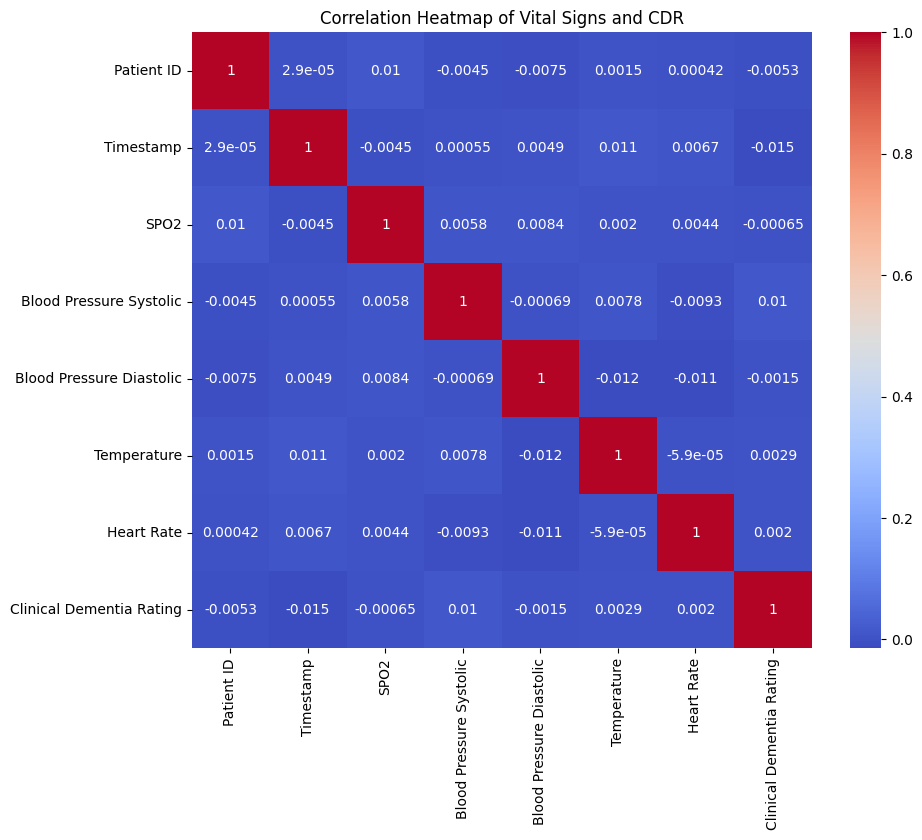

In [ ]:
# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap of Vital Signs and CDR')
plt.show()

In [ ]:
# Resample data to daily frequency (adjust as needed)
resampled_dfs = []
for patient_id, group in df.groupby('Patient ID'):
    resampled = group.resample('D', on='Timestamp').mean().reset_index()
    resampled['Patient ID'] = patient_id
    resampled_dfs.append(resampled)

df_resampled = pd.concat(resampled_dfs, ignore_index=True)

In [ ]:
df.head()

,Patient ID,Timestamp,SPO2,Blood Pressure Systolic,Blood Pressure Diastolic,Temperature,Heart Rate,Clinical Dementia Rating
8,1,2024-05-12 03:44:00,85.1,112.7,83.4,38.6,52.7,2.5
4,1,2024-05-12 05:13:00,89.6,97.2,118.4,39.1,84.6,0.6
10,1,2024-05-12 05:36:00,85.6,166.2,108.0,37.0,78.3,2.0
15,1,2024-05-12 05:52:00,88.7,132.6,93.8,35.8,132.7,0.5
17,1,2024-05-12 06:17:00,92.2,115.7,73.1,37.2,138.2,1.8


In [ ]:
df_resampled.head()

,Timestamp,Patient ID,SPO2,Blood Pressure Systolic,Blood Pressure Diastolic,Temperature,Heart Rate,Clinical Dementia Rating
0,2024-05-12,1,90.480,137.085,90.760,38.040,104.820,1.475
1,2024-05-13,1,93.740,133.050,86.010,37.450,100.590,1.330
2,2024-05-14,1,94.120,124.005,89.360,37.475,101.260,1.685
3,2024-05-15,1,91.645,139.110,84.600,37.545,98.685,1.570
4,2024-05-16,1,92.510,145.910,86.975,38.020,93.310,1.635


In [ ]:
df_resampled.dtypes

,0
Timestamp,datetime64[ns]
Patient ID,int64
SPO2,float64
Blood Pressure Systolic,float64
Blood Pressure Diastolic,float64
Temperature,float64
Heart Rate,float64
Clinical Dementia Rating,float64


In [ ]:
df_resampled.isnull().sum()

,0
Timestamp,0
Patient ID,0
SPO2,0
Blood Pressure Systolic,0
Blood Pressure Diastolic,0
Temperature,0
Heart Rate,0
Clinical Dementia Rating,0


In [ ]:
df_resampled.describe()

,Timestamp,Patient ID,SPO2,Blood Pressure Systolic,Blood Pressure Diastolic,Temperature,Heart Rate,Clinical Dementia Rating
count,900,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000
mean,2024-06-25 11:59:59.999999744,5.500000,92.492668,134.877531,89.733157,37.739877,100.225926,1.512971
min,2024-05-12 00:00:00,1.000000,89.410000,117.140000,78.285000,36.955000,79.420000,0.950000
25%,2024-06-03 00:00:00,3.000000,91.830000,131.088750,86.932500,37.535000,95.932500,1.380000
50%,2024-06-25 12:00:00,5.500000,92.455000,134.932500,89.642500,37.745000,100.202500,1.525000
75%,2024-07-18 00:00:00,8.000000,93.147500,138.872500,92.351250,37.930000,104.720000,1.635000
max,2024-08-09 00:00:00,10.000000,95.520000,153.485000,101.600000,38.665000,121.895000,2.095000
std,NaN,2.873878,0.979903,5.926440,3.925137,0.284605,6.476530,0.193592


In [ ]:
# Calculate correlation matrix
corr_matrix = df_resampled.corr()

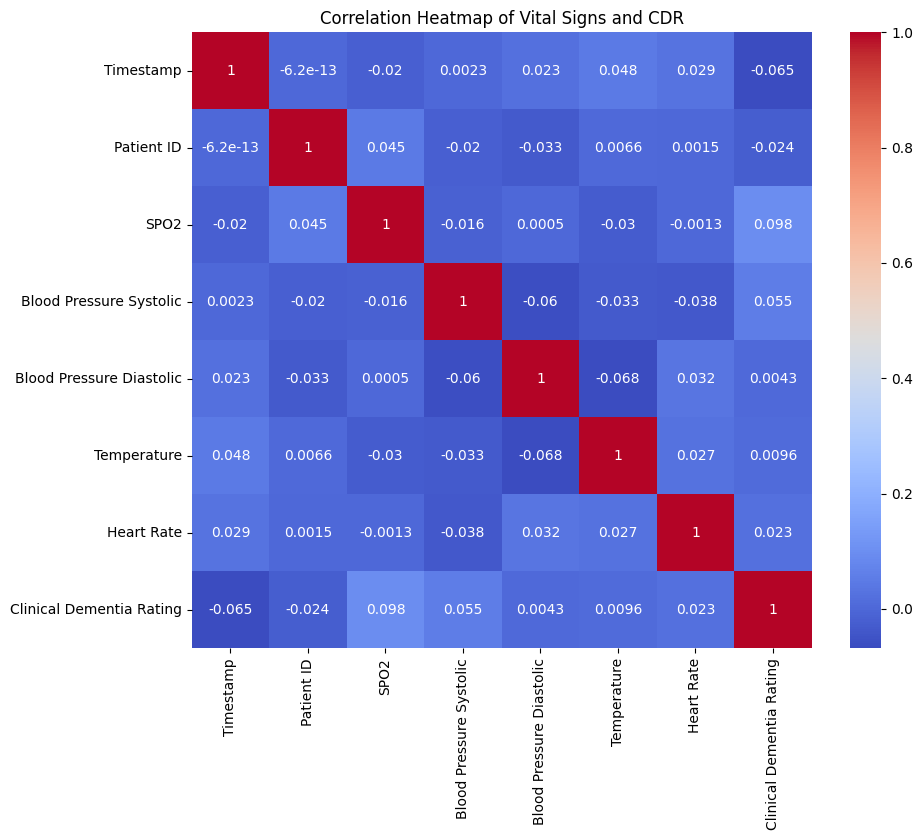

In [ ]:
# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap of Vital Signs and CDR')
plt.show()

From above Correlation matrix we can gain some insights like:

*   SPO2: Shows a slight positive correlation with Clinical Dementia Rating (0.098), indicating a potential but weak relationship.
*   Blood Pressure Systolic/Diastolic: These have weak correlations with the other parameters.
*   Temperature: Minimal correlation with most variables.
*   Heart Rate: Also shows weak correlations with the other variables.
*   Clinical Dementia Rating: Slight positive correlations with Blood Pressure Systolic (0.055) and SPO2 (0.098).

So if we want use any exogenoues parameters than spo2 and blood pressure systolic is the best.









# **Trend and seasonality analysis**

In [ ]:
def plot_seasonality_trend(data, column, patient_id):
    plt.figure(figsize=(12, 8))

    # Perform seasonal decomposition
    result = seasonal_decompose(data[column], model='additive', period=30)  # Adjust period as needed

    # Plot original data
    plt.subplot(411)
    plt.plot(data['Timestamp'], data[column])
    plt.title(f'Seasonality and Trend Analysis for Patient {patient_id} - {column}')
    plt.ylabel('Original')

    # Plot trend
    plt.subplot(412)
    plt.plot(data['Timestamp'], result.trend)
    plt.ylabel('Trend')

    # Plot seasonal
    plt.subplot(413)
    plt.plot(data['Timestamp'], result.seasonal)
    plt.ylabel('Seasonal')

    # Plot residual
    plt.subplot(414)
    plt.plot(data['Timestamp'], result.resid)
    plt.ylabel('Residual')

    plt.tight_layout()
    plt.show()


In [ ]:
# Analyze seasonality and trend for each patient and vital sign
vital_signs = ['SPO2', 'Blood Pressure Systolic', 'Blood Pressure Diastolic', 'Temperature', 'Heart Rate','Clinical Dementia Rating']

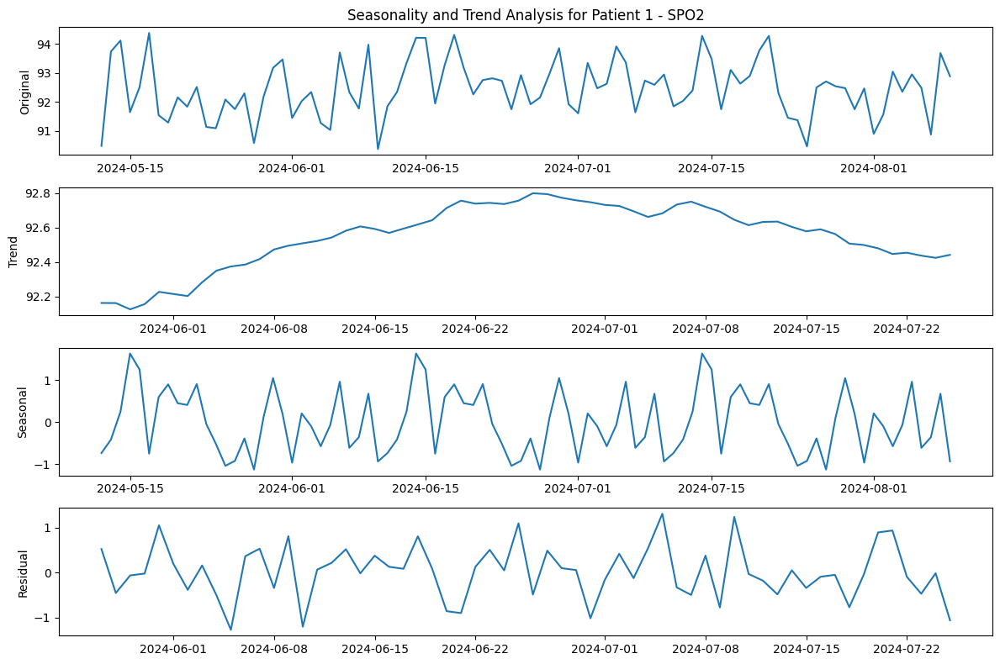

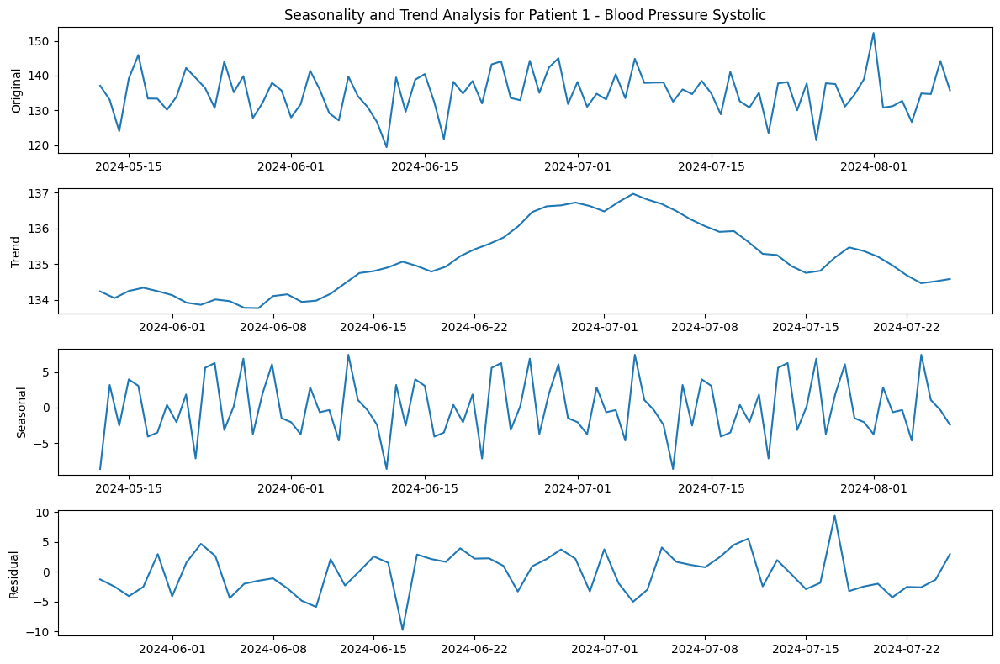

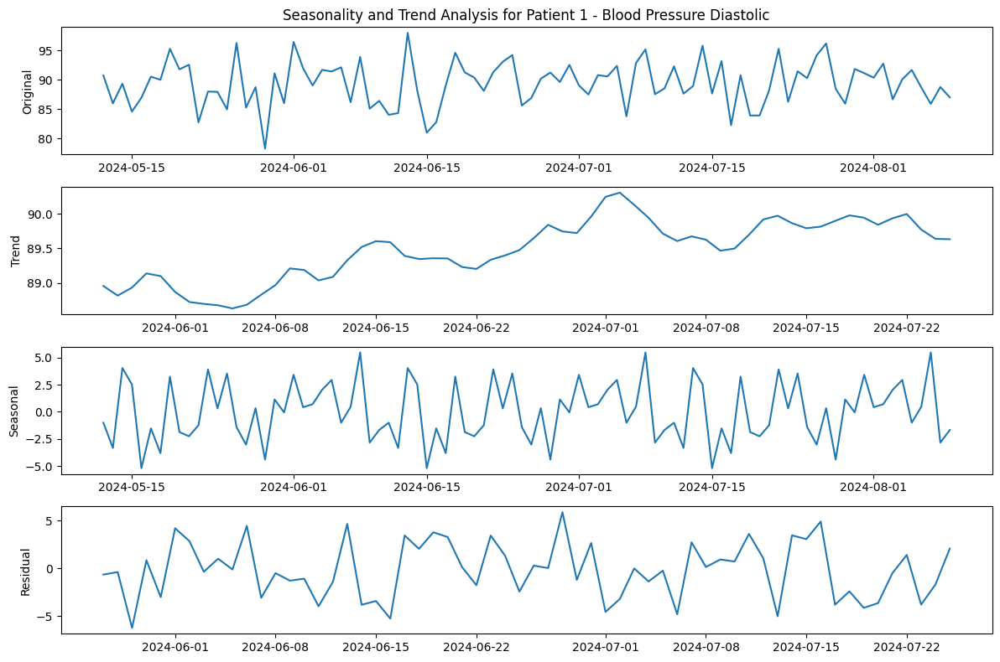

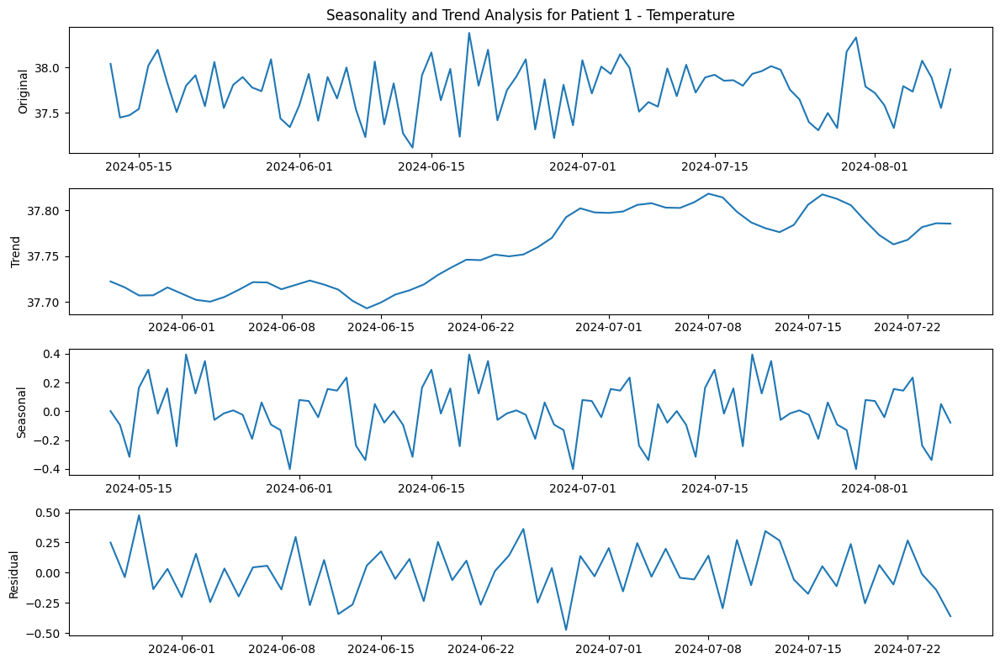

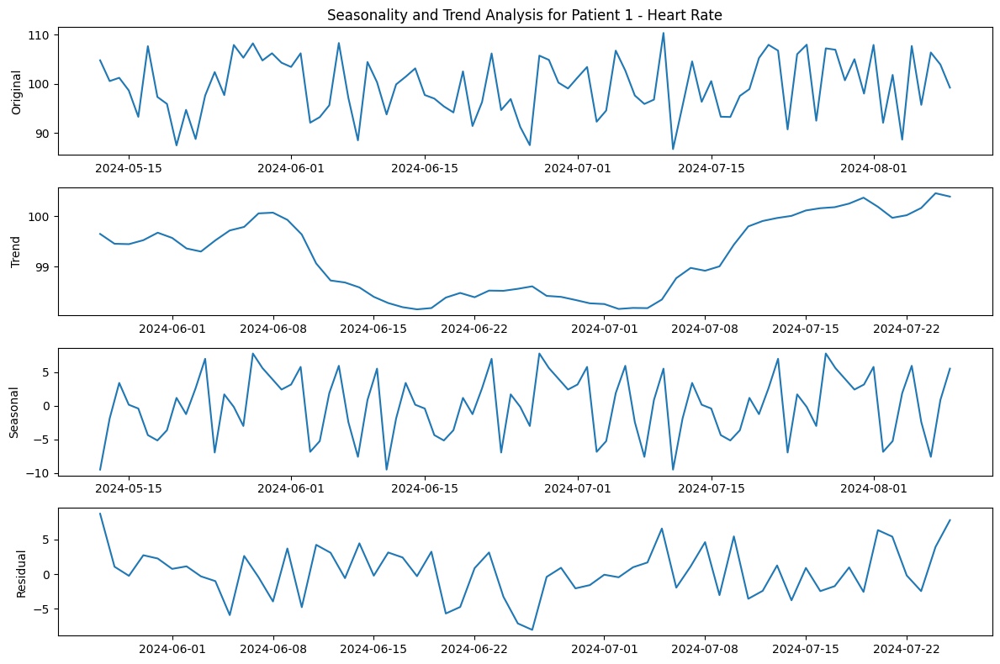

...

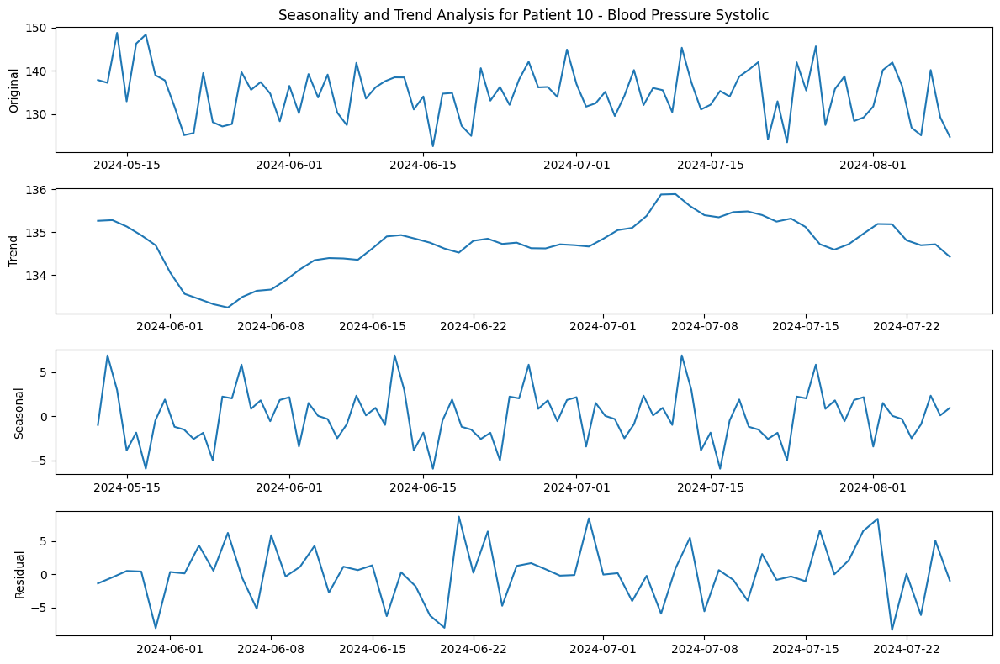

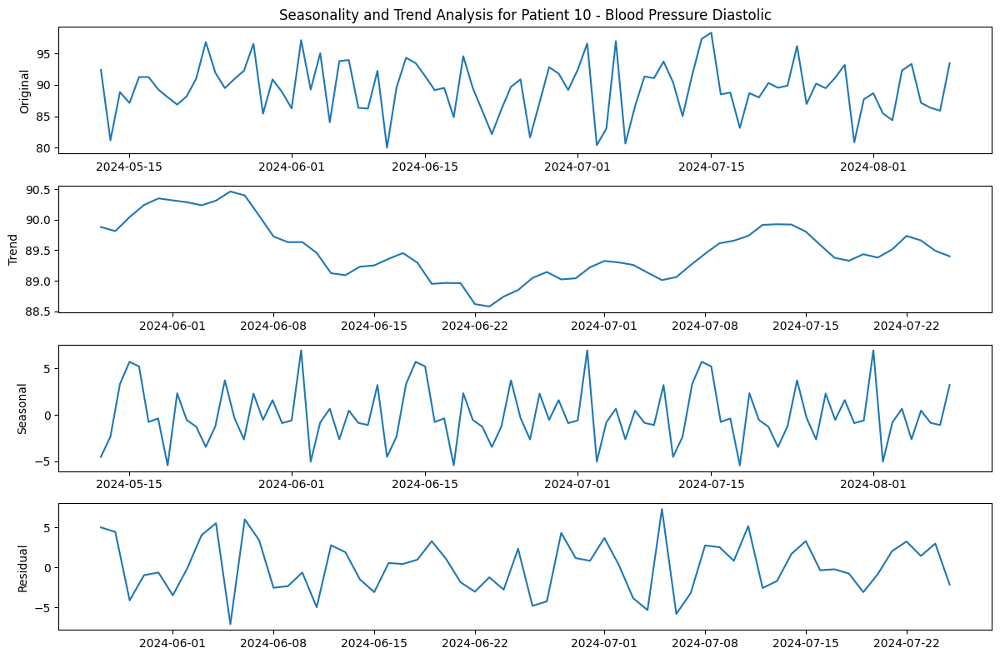

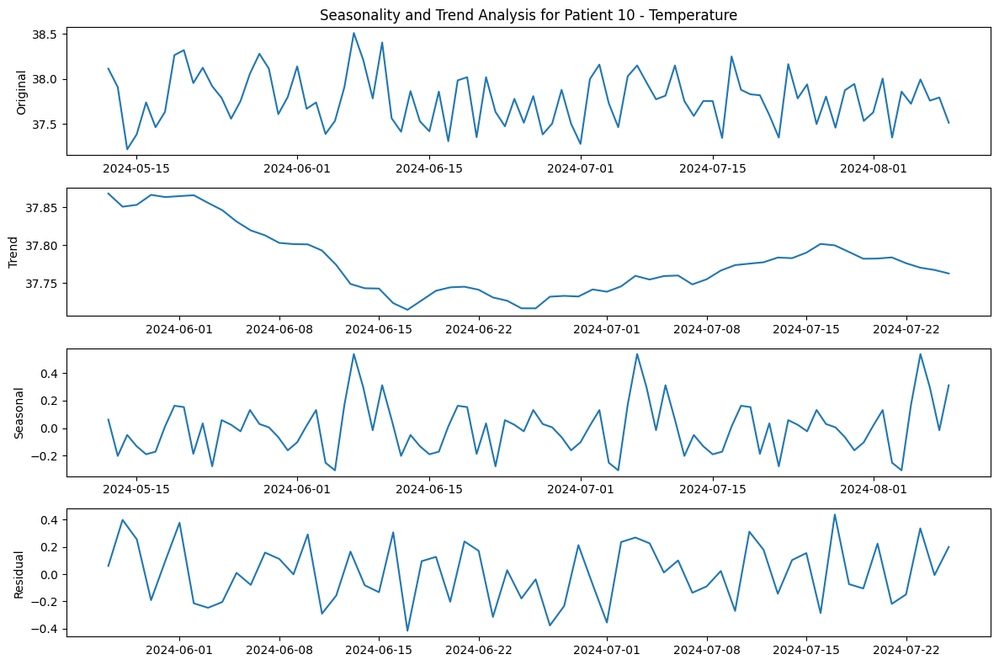

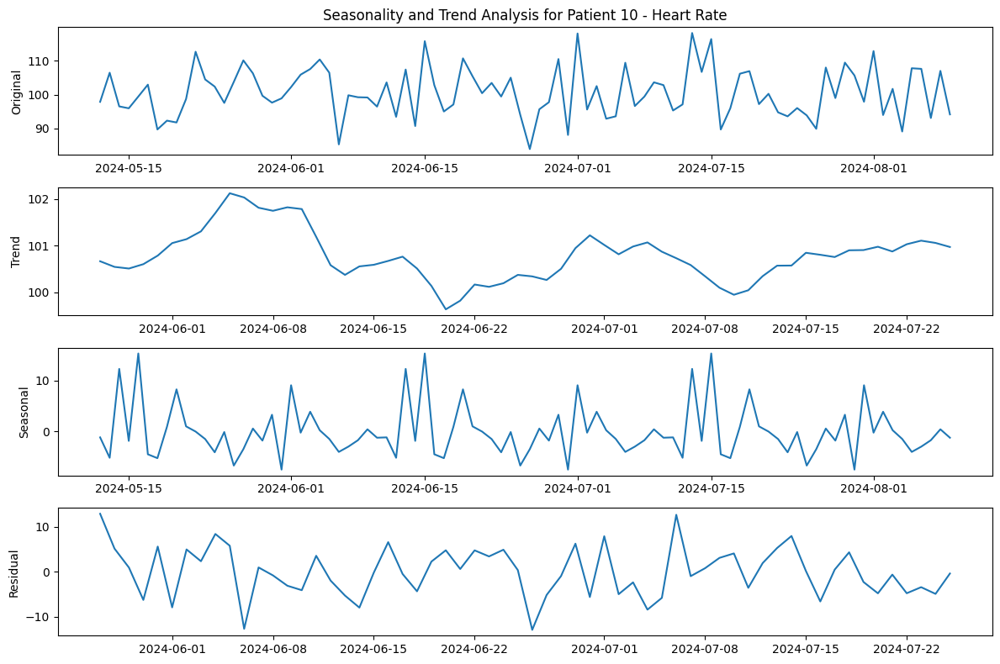

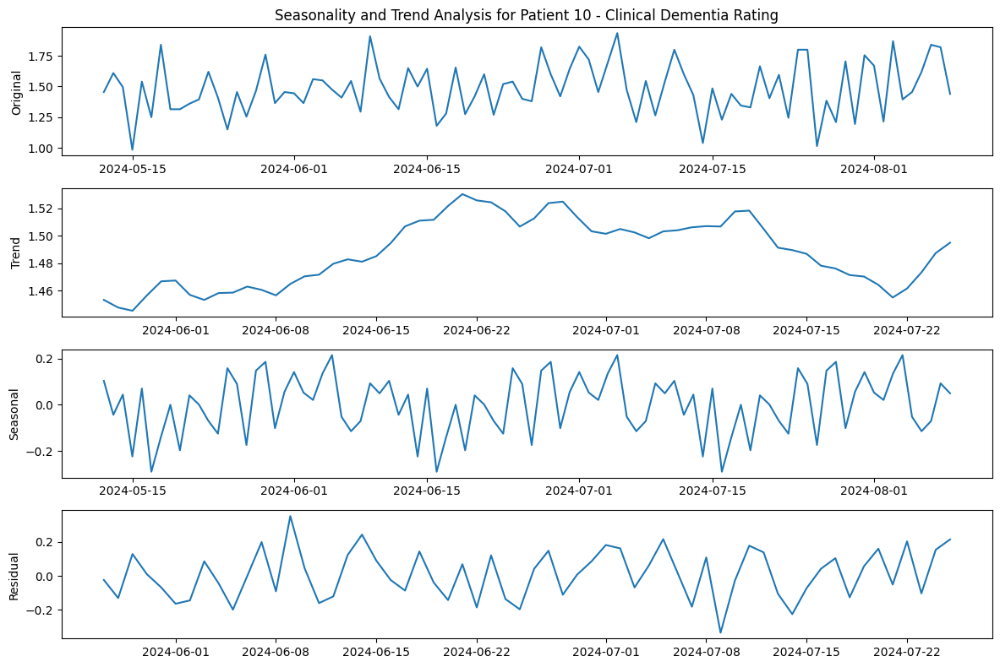

In [ ]:
for patient_id, group in df_resampled.groupby('Patient ID'):
    for vital in vital_signs:
        plot_seasonality_trend(group, vital, patient_id)

In [ ]:
# Calculate overall trend
def calculate_trend(data, column):
    x = np.arange(len(data))
    y = data[column].values
    slope, _ = np.polyfit(x, y, 1)
    return slope


In [ ]:
trends = df_resampled.groupby('Patient ID').apply(lambda x: pd.Series({
    vital: calculate_trend(x, vital) for vital in vital_signs
}))

print("Overall trends for each patient:")
print(trends)

Overall trends for each patient:
                SPO2  Blood Pressure Systolic  Blood Pressure Diastolic  \
Patient ID                                                                
1           0.002972                 0.005779                  0.011657   
2          -0.001007                 0.005805                  0.004235   
3          -0.005458                 0.006249                  0.007452   
4           0.002629                 0.017003                  0.012822   
5          -0.003514                 0.015224                 -0.003766   
6          -0.000654                 0.027846                 -0.027368   
7          -0.001147                -0.017726                  0.013082   
8           0.000863                -0.033082                  0.027087   
9           0.001445                 0.003936                 -0.000835   
10         -0.003531                -0.025829                 -0.010033   

            Temperature  Heart Rate  Clinical Dementia Rating  
Pa

In [ ]:
def detect_anomalies(data, column):
    clf = IsolationForest(contamination=0.1, random_state=42)
    anomalies = clf.fit_predict(data[[column]])
    return pd.Series(anomalies == -1, index=data.index)

In [ ]:
for vital in vital_signs:
    df_resampled[f'{vital}_anomaly'] = df_resampled.groupby('Patient ID').apply(
        lambda x: detect_anomalies(x, vital)
    ).reset_index(level=0, drop=True)

In [ ]:
def plot_anomalies(data, column, patient_id):
    plt.figure(figsize=(12, 6))
    plt.plot(data['Timestamp'], data[column], label='Normal')

    anomaly_column = f'{column}_anomaly'
    if anomaly_column in data.columns:
        anomalies = data[data[anomaly_column]]
        plt.scatter(anomalies['Timestamp'], anomalies[column], color='red', label='Anomaly')

    plt.title(f'Anomaly Detection for Patient {patient_id} - {column}')
    plt.xlabel('Timestamp')
    plt.ylabel(column)
    plt.legend()
    plt.show()

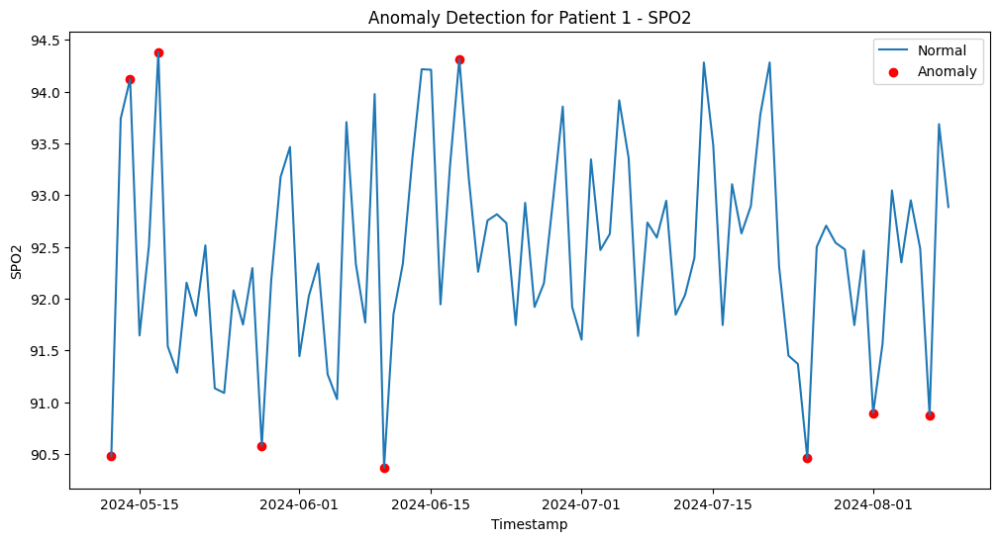

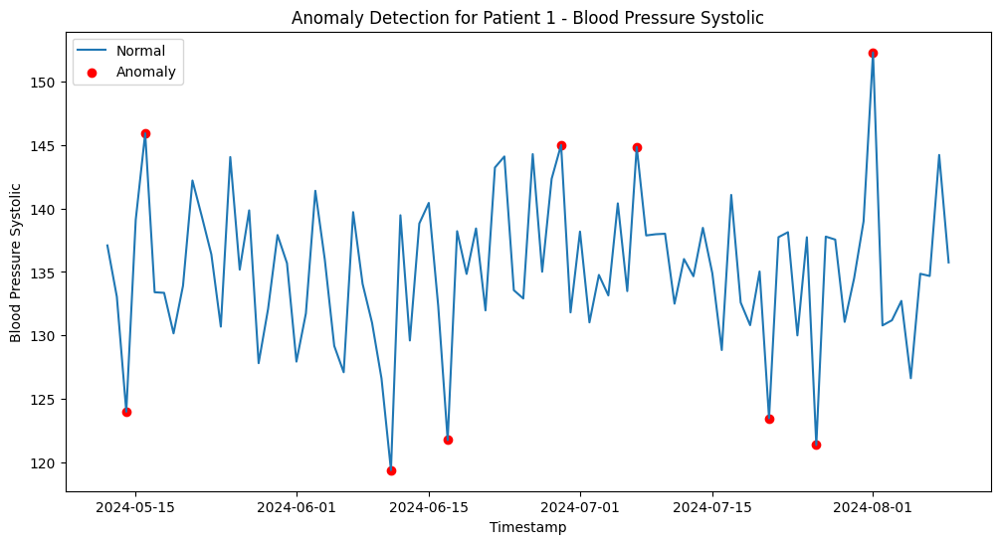

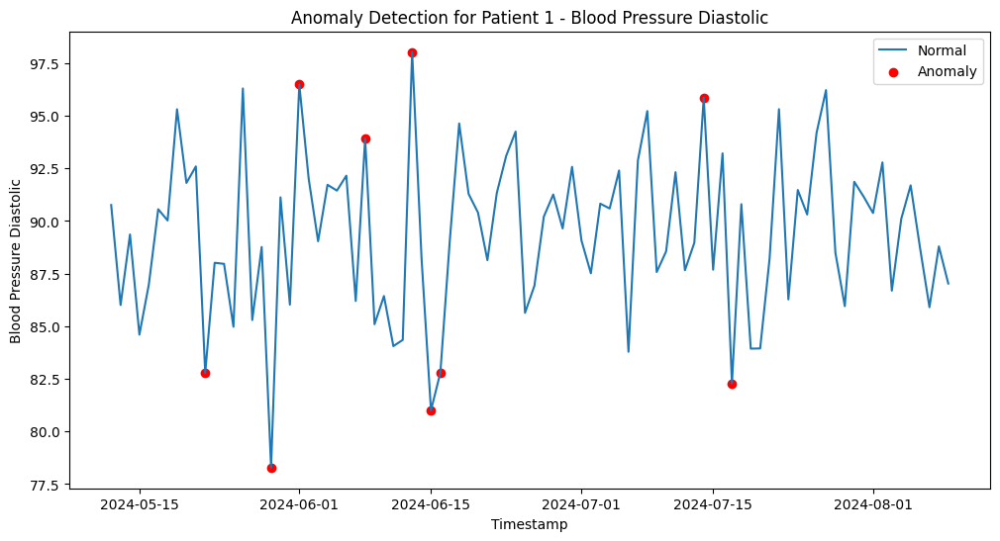

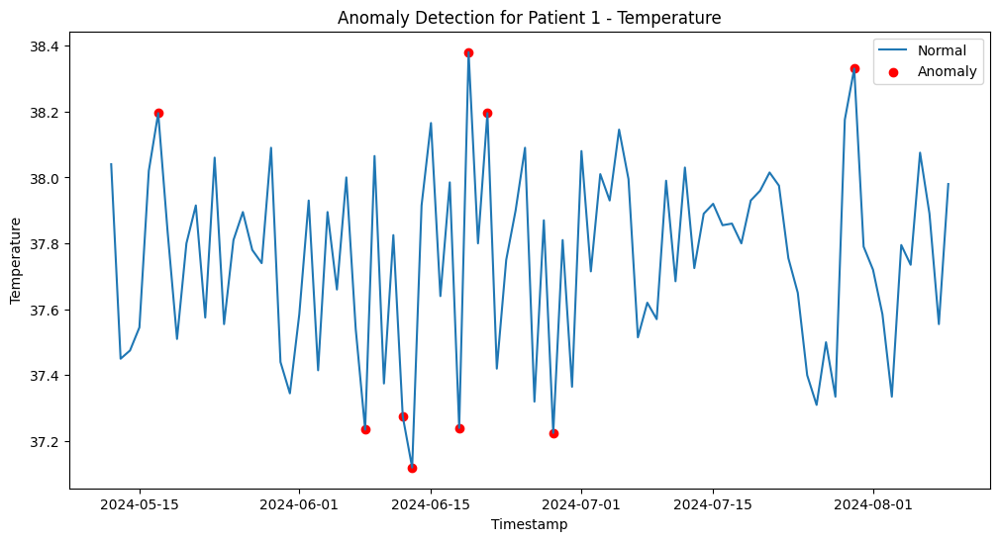

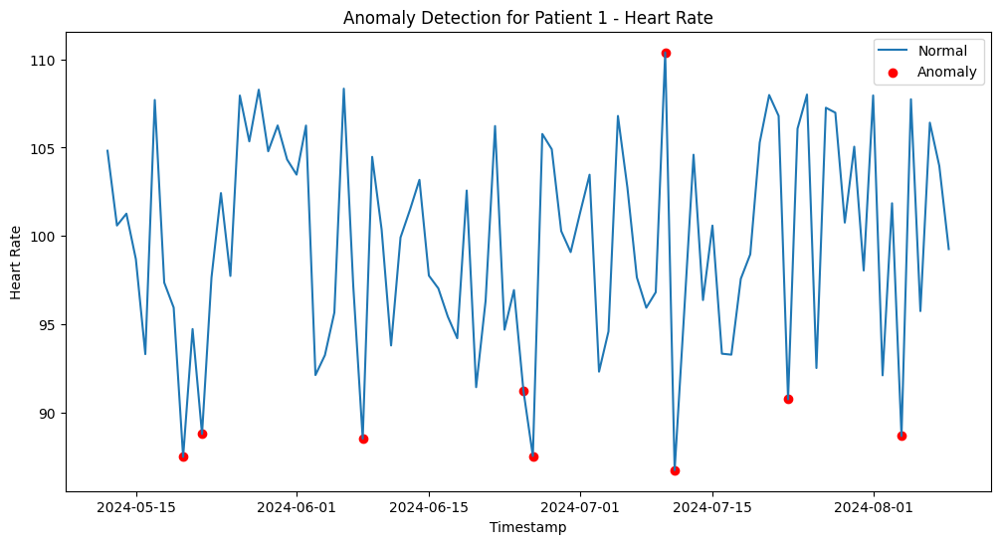

...

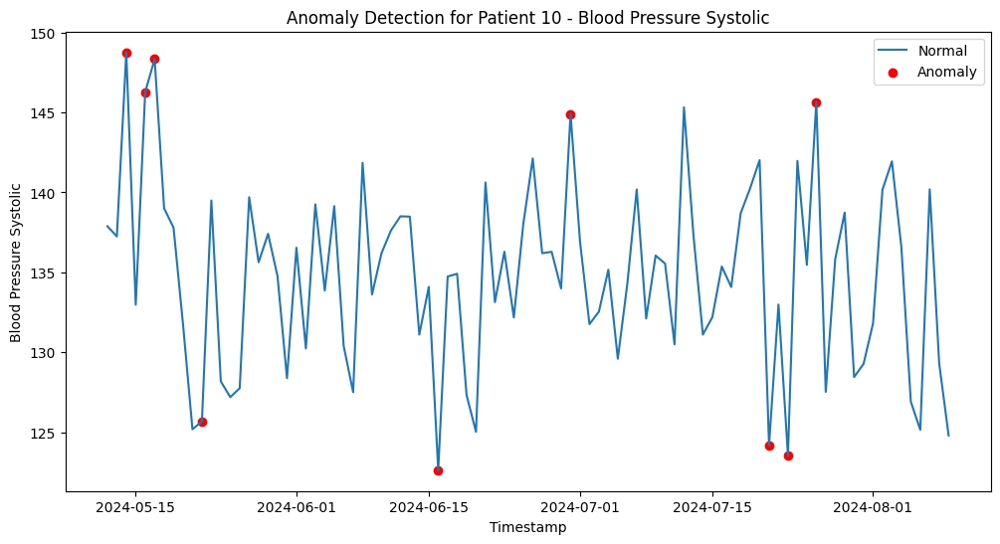

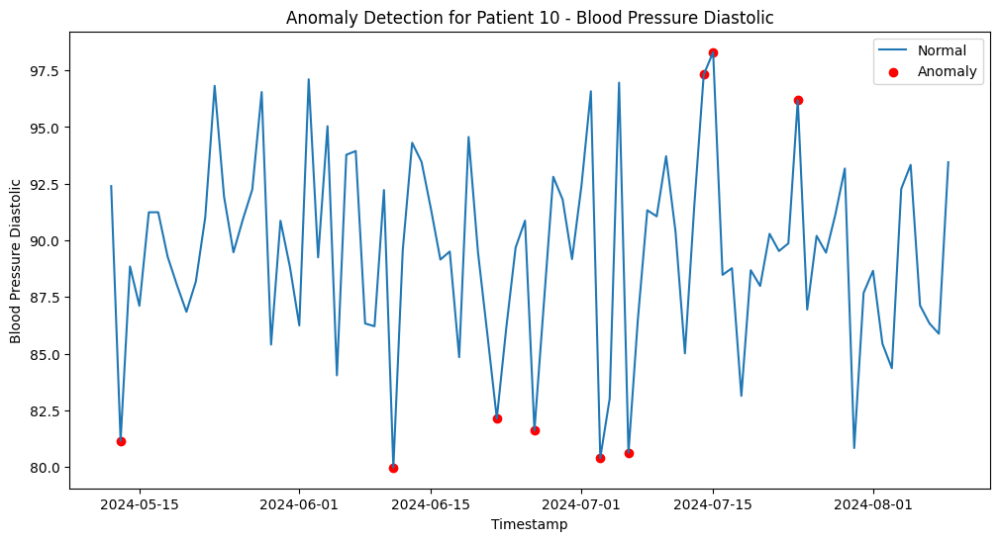

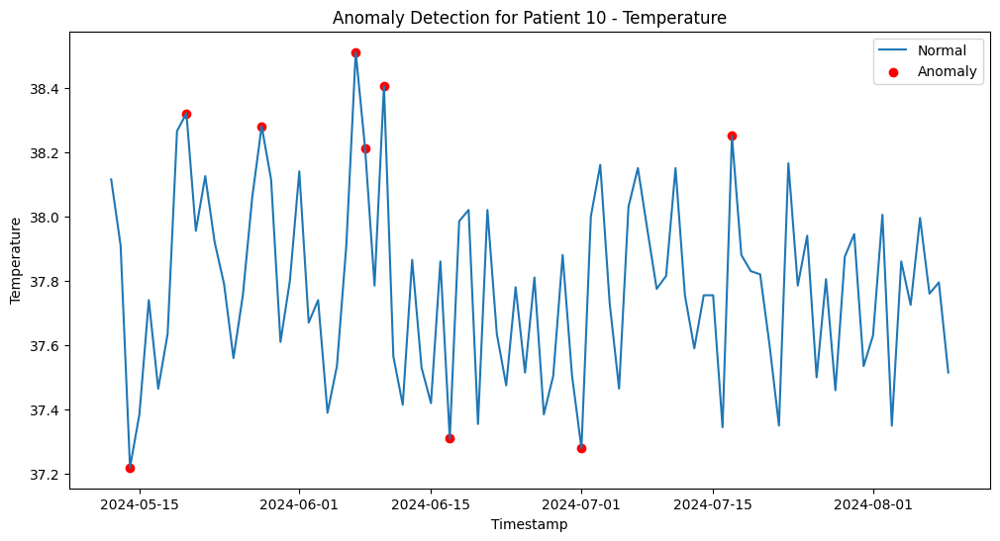

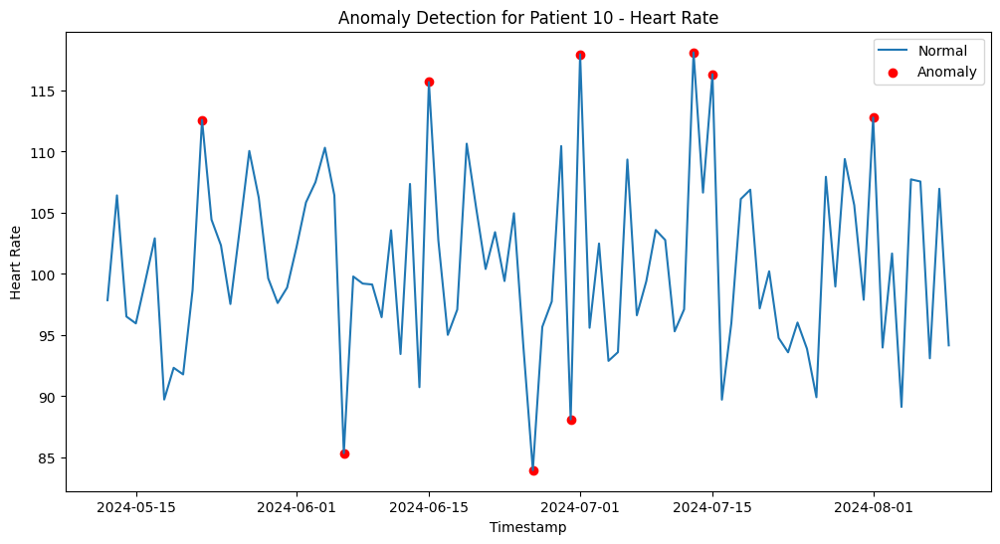

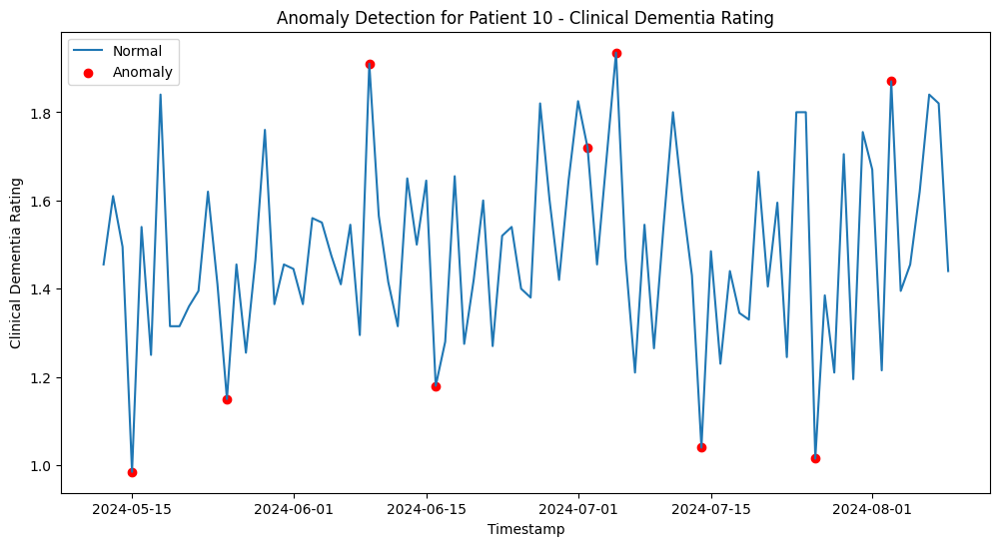

In [ ]:
for patient_id, group in df_resampled.groupby('Patient ID'):
    for vital in vital_signs:
        plot_anomalies(group, vital, patient_id)

# **ARIMA MODEL(univariate model):**

In [ ]:
pip install pmdarima

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 27.6 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pmdarima import auto_arima
from sklearn.metrics import mean_squared_error
from math import sqrt

In [ ]:
def build_arima_model(patient_data):
    # Fit auto_arima model
    model = auto_arima(patient_data, start_p=1, start_q=1, max_p=5, max_q=5, m=7,
                       start_P=0, seasonal=True, d=1, D=1, trace=True,
                       error_action='ignore', suppress_warnings=True, stepwise=True)

    # Print the model summary
    print(model.summary())

    # Split data into train and test sets
    train_size = int(len(patient_data) * 0.8)
    train, test = patient_data[:train_size], patient_data[train_size:]

    # Fit the model on the training data
    model.fit(train)

    # Make predictions
    forecast = model.predict(n_periods=len(test))

    # Calculate RMSE
    rmse = sqrt(mean_squared_error(test, forecast))
    print(f'RMSE: {rmse}')

    # Plot the results
    plt.figure(figsize=(12, 6))
    plt.plot(train.index, train, label='Training Data')
    plt.plot(test.index, test, label='True Test Data')
    plt.plot(test.index, forecast, label='Predictions')
    plt.title(f'ARIMA Forecast (RMSE: {rmse:.2f})')
    plt.legend()
    plt.show()

    return model, rmse


Building ARIMA model for Patient 1
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.87 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=79.502, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=42.957, Time=0.23 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=1.68 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=60.609, Time=0.14 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=21.519, Time=1.03 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=6.25 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=inf, Time=4.22 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=37.190, Time=0.58 sec
 ARIMA(2,1,0)(2,1,0)[7]             : AIC=8.965, Time=0.51 sec
 ARIMA(2,1,0)(1,1,0)[7]             : AIC=31.066, Time=0.40 sec
 ARIMA(2,1,0)(2,1,1)[7]             : AIC=inf, Time=4.68 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=inf, Time=4.32 sec
 ARIMA(3,1,0)(2,1,0)[7]             : AIC=8.355, Time=3.86 sec
 ARIMA(3,1,0)(1,1,0)[7]             : AIC=29.

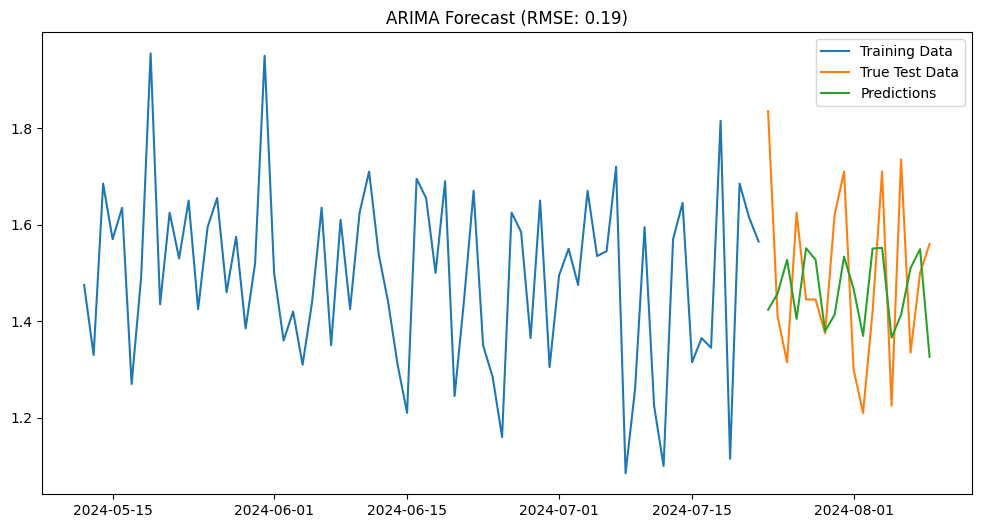


Building ARIMA model for Patient 2
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.56 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=82.698, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=33.643, Time=0.09 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.37 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=42.228, Time=0.04 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=31.582, Time=0.22 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=0.90 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=inf, Time=0.59 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=52.904, Time=0.14 sec
 ARIMA(2,1,0)(2,1,0)[7]             : AIC=23.895, Time=0.29 sec
 ARIMA(2,1,0)(1,1,0)[7]             : AIC=26.046, Time=0.13 sec
 ARIMA(2,1,0)(2,1,1)[7]             : AIC=inf, Time=0.84 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=inf, Time=0.68 sec
 ARIMA(3,1,0)(2,1,0)[7]             : AIC=12.872, Time=0.39 sec
 ARIMA(3,1,0)(1,1,0)[7]             : AIC=1

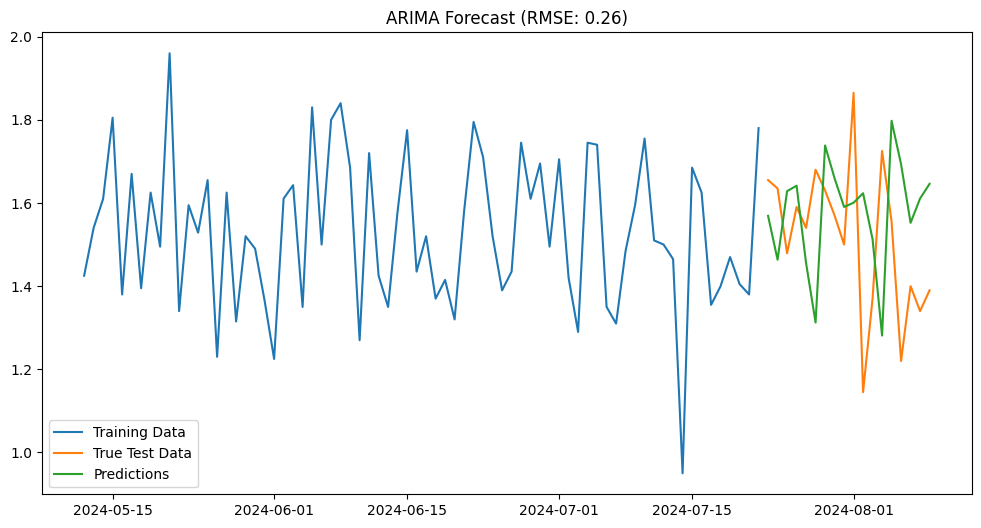


Building ARIMA model for Patient 3
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.94 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=90.617, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=47.488, Time=0.81 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.35 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=68.292, Time=0.14 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=26.782, Time=1.93 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=5.19 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=inf, Time=0.52 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=48.628, Time=0.12 sec
 ARIMA(2,1,0)(2,1,0)[7]             : AIC=7.237, Time=0.21 sec
 ARIMA(2,1,0)(1,1,0)[7]             : AIC=23.569, Time=0.13 sec
 ARIMA(2,1,0)(2,1,1)[7]             : AIC=inf, Time=0.95 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=inf, Time=0.72 sec
 ARIMA(3,1,0)(2,1,0)[7]             : AIC=7.986, Time=0.32 sec
 ARIMA(2,1,1)(2,1,0)[7]             : AIC=-0.

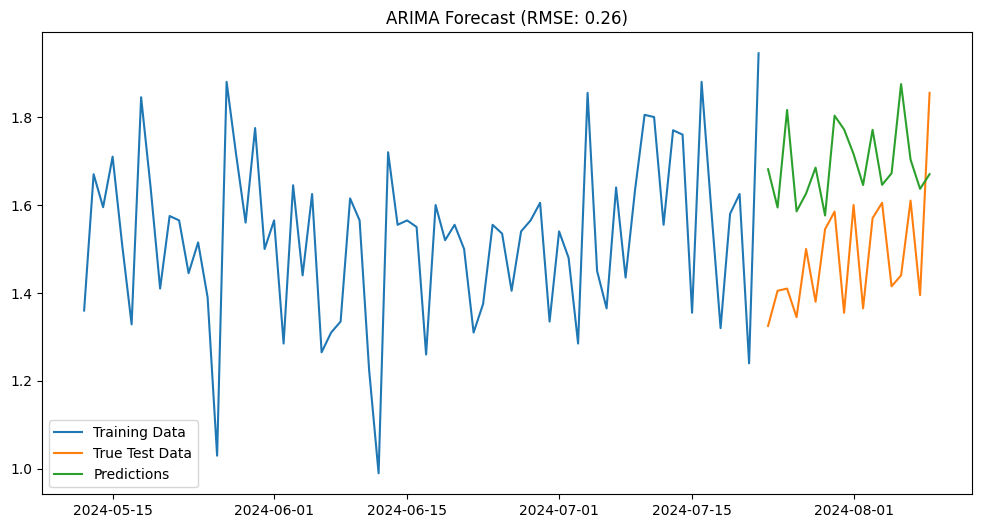


Building ARIMA model for Patient 4
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.42 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=91.638, Time=0.05 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=38.379, Time=0.10 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.25 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=68.031, Time=0.04 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=32.349, Time=0.22 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=0.87 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=inf, Time=0.47 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=52.270, Time=0.13 sec
 ARIMA(2,1,0)(2,1,0)[7]             : AIC=28.475, Time=0.23 sec
 ARIMA(2,1,0)(1,1,0)[7]             : AIC=33.810, Time=0.14 sec
 ARIMA(2,1,0)(2,1,1)[7]             : AIC=inf, Time=0.93 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=inf, Time=0.66 sec
 ARIMA(3,1,0)(2,1,0)[7]             : AIC=18.333, Time=0.45 sec
 ARIMA(3,1,0)(1,1,0)[7]             : AIC=2

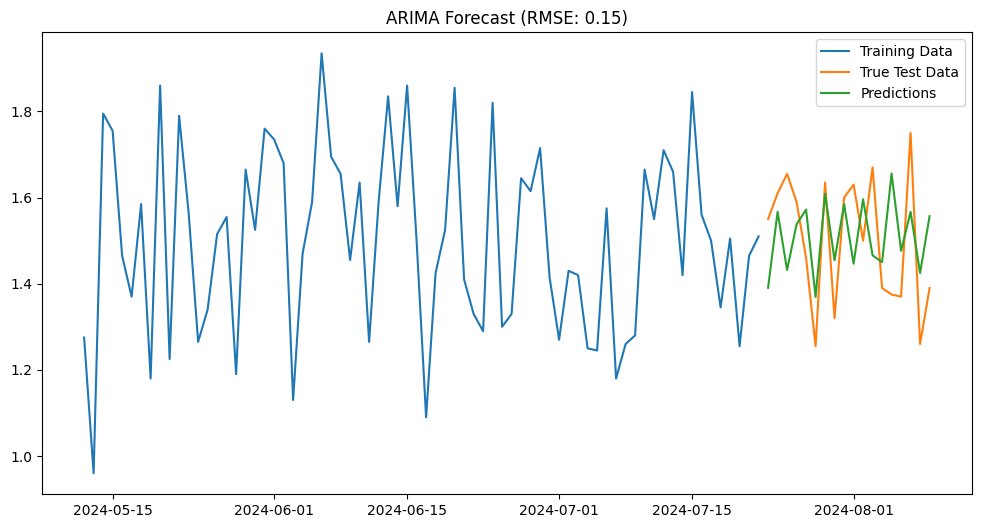


Building ARIMA model for Patient 5
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=-12.965, Time=0.51 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=49.891, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=27.058, Time=0.16 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=-14.936, Time=0.23 sec
 ARIMA(0,1,1)(0,1,0)[7]             : AIC=inf, Time=0.17 sec
 ARIMA(0,1,1)(1,1,1)[7]             : AIC=inf, Time=0.50 sec
 ARIMA(0,1,1)(0,1,2)[7]             : AIC=inf, Time=0.58 sec
 ARIMA(0,1,1)(1,1,0)[7]             : AIC=-1.808, Time=0.28 sec
 ARIMA(0,1,1)(1,1,2)[7]             : AIC=inf, Time=0.93 sec
 ARIMA(0,1,0)(0,1,1)[7]             : AIC=31.084, Time=0.11 sec
 ARIMA(0,1,2)(0,1,1)[7]             : AIC=-12.980, Time=0.34 sec
 ARIMA(1,1,0)(0,1,1)[7]             : AIC=15.259, Time=0.13 sec
 ARIMA(1,1,2)(0,1,1)[7]             : AIC=-11.041, Time=0.40 sec
 ARIMA(0,1,1)(0,1,1)[7] intercept   : AIC=inf, Time=0.55 sec

Best model:  ARIMA(0,1,1)(0,1,1)[7]

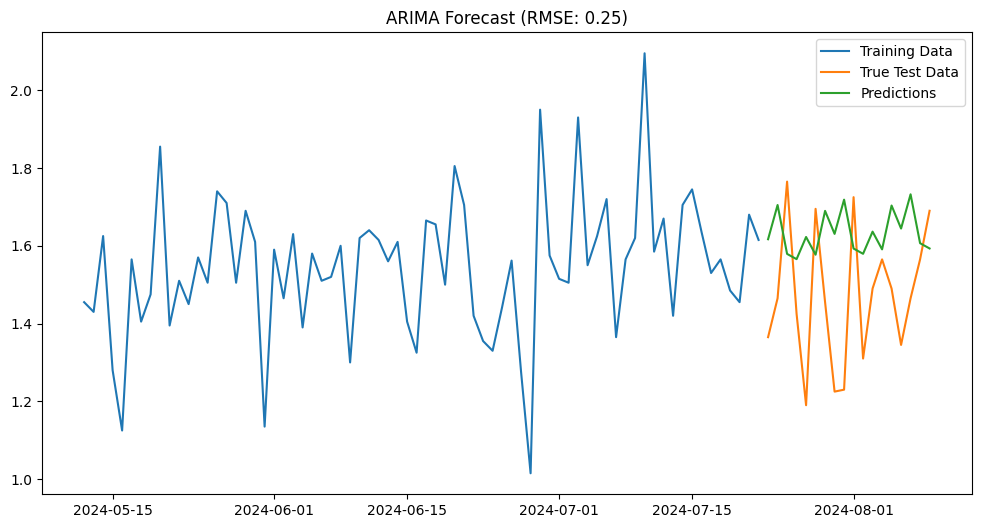


Building ARIMA model for Patient 6
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.69 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=72.366, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=39.534, Time=0.09 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.36 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=55.771, Time=0.04 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=27.819, Time=0.25 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=2.40 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=inf, Time=2.35 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=54.690, Time=1.49 sec
 ARIMA(2,1,0)(2,1,0)[7]             : AIC=16.926, Time=0.36 sec
 ARIMA(2,1,0)(1,1,0)[7]             : AIC=31.196, Time=0.14 sec
 ARIMA(2,1,0)(2,1,1)[7]             : AIC=12.561, Time=0.65 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=inf, Time=0.58 sec
 ARIMA(2,1,0)(2,1,2)[7]             : AIC=11.207, Time=0.87 sec
 ARIMA(2,1,0)(1,1,2)[7]             : AI

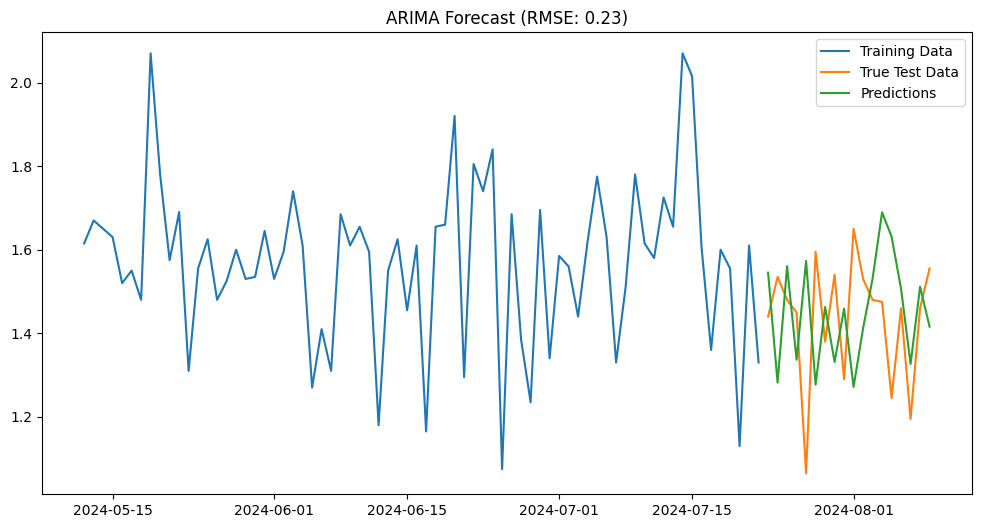


Building ARIMA model for Patient 7
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.42 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=80.883, Time=0.07 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=33.416, Time=0.11 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=-11.172, Time=0.30 sec
 ARIMA(0,1,1)(0,1,0)[7]             : AIC=inf, Time=0.12 sec
 ARIMA(0,1,1)(1,1,1)[7]             : AIC=-10.341, Time=0.26 sec
 ARIMA(0,1,1)(0,1,2)[7]             : AIC=-10.021, Time=0.38 sec
 ARIMA(0,1,1)(1,1,0)[7]             : AIC=-1.385, Time=0.19 sec
 ARIMA(0,1,1)(1,1,2)[7]             : AIC=inf, Time=2.19 sec
 ARIMA(0,1,0)(0,1,1)[7]             : AIC=inf, Time=0.68 sec
 ARIMA(0,1,2)(0,1,1)[7]             : AIC=inf, Time=1.67 sec
 ARIMA(1,1,0)(0,1,1)[7]             : AIC=inf, Time=1.92 sec
 ARIMA(1,1,2)(0,1,1)[7]             : AIC=inf, Time=0.92 sec
 ARIMA(0,1,1)(0,1,1)[7] intercept   : AIC=inf, Time=0.58 sec

Best model:  ARIMA(0,1,1)(0,1,1)[7]          

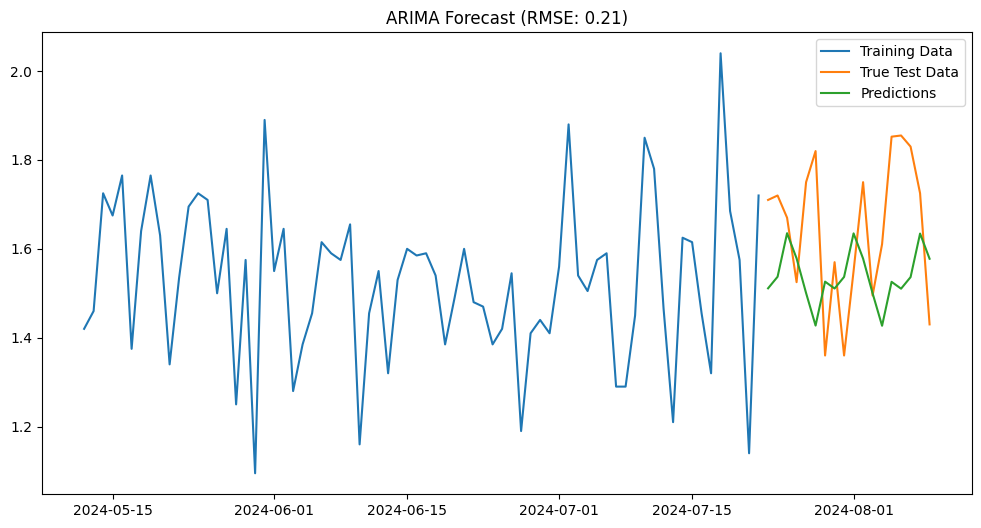


Building ARIMA model for Patient 8
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.73 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=93.497, Time=0.02 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=39.806, Time=0.08 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.26 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=55.386, Time=0.03 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=26.185, Time=0.23 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=0.87 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=inf, Time=0.37 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=71.348, Time=0.23 sec
 ARIMA(2,1,0)(2,1,0)[7]             : AIC=14.865, Time=0.27 sec
 ARIMA(2,1,0)(1,1,0)[7]             : AIC=24.252, Time=0.14 sec
 ARIMA(2,1,0)(2,1,1)[7]             : AIC=6.829, Time=0.73 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=inf, Time=0.98 sec
 ARIMA(2,1,0)(2,1,2)[7]             : AIC=inf, Time=1.30 sec
 ARIMA(2,1,0)(1,1,2)[7]             : AIC=in

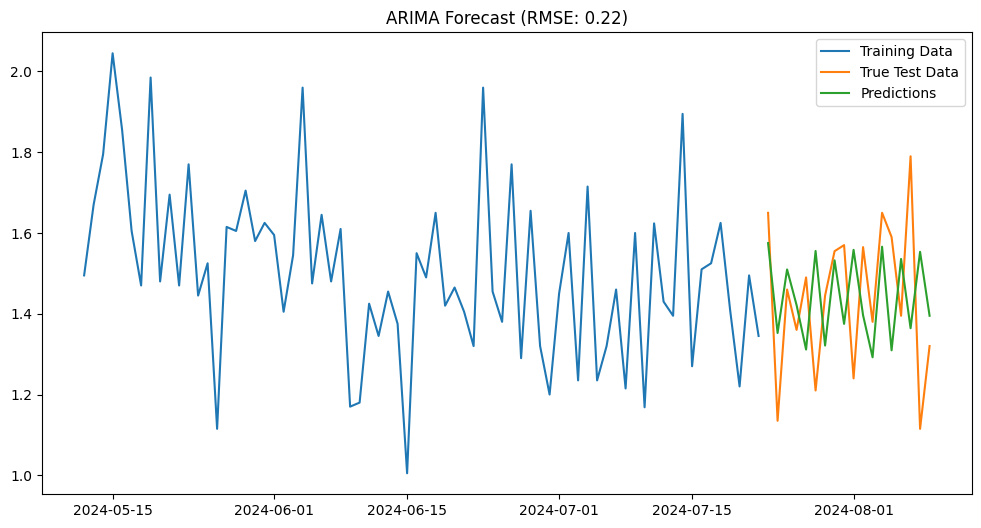


Building ARIMA model for Patient 9
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.56 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=77.689, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=34.834, Time=0.10 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.32 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=56.513, Time=0.05 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=31.009, Time=0.26 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=1.31 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=24.499, Time=0.23 sec
 ARIMA(1,1,0)(0,1,1)[7]             : AIC=22.545, Time=0.23 sec
 ARIMA(1,1,0)(0,1,2)[7]             : AIC=24.508, Time=0.45 sec
 ARIMA(1,1,0)(1,1,2)[7]             : AIC=inf, Time=1.28 sec
 ARIMA(0,1,0)(0,1,1)[7]             : AIC=47.080, Time=0.09 sec
 ARIMA(2,1,0)(0,1,1)[7]             : AIC=inf, Time=0.37 sec
 ARIMA(2,1,1)(0,1,1)[7]             : AIC=-2.336, Time=0.77 sec
 ARIMA(2,1,1)(0,1,0)[7]             : AI

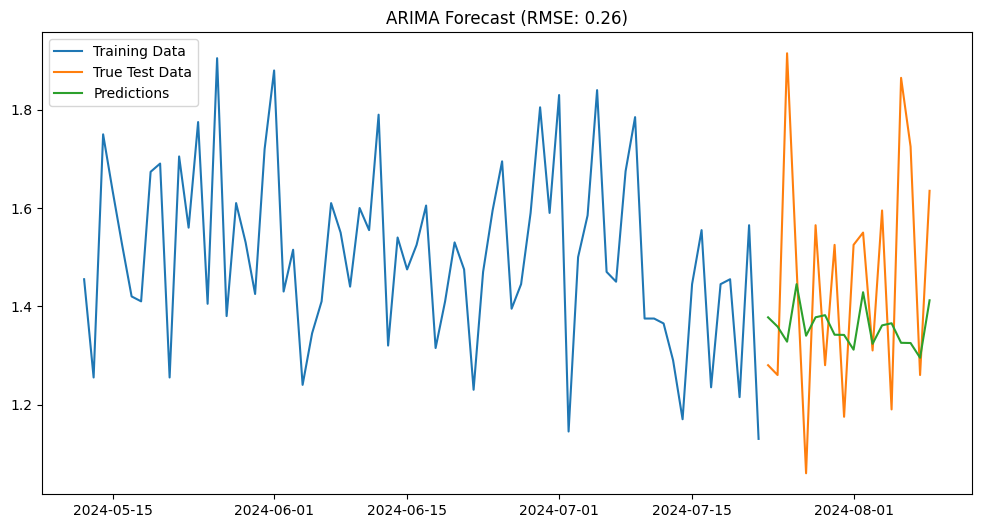


Building ARIMA model for Patient 10
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.78 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=72.874, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=35.307, Time=0.09 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.38 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=58.394, Time=0.04 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=35.873, Time=0.27 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=34.069, Time=0.18 sec
 ARIMA(1,1,0)(0,1,1)[7]             : AIC=32.369, Time=0.14 sec
 ARIMA(1,1,0)(0,1,2)[7]             : AIC=34.260, Time=0.26 sec
 ARIMA(1,1,0)(1,1,2)[7]             : AIC=34.846, Time=0.52 sec
 ARIMA(0,1,0)(0,1,1)[7]             : AIC=51.799, Time=0.09 sec
 ARIMA(2,1,0)(0,1,1)[7]             : AIC=20.035, Time=0.42 sec
 ARIMA(2,1,0)(0,1,0)[7]             : AIC=45.347, Time=0.09 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=21.930, Time=1.22 sec
 ARIMA(2,1,0)(0,1,2)[7]       

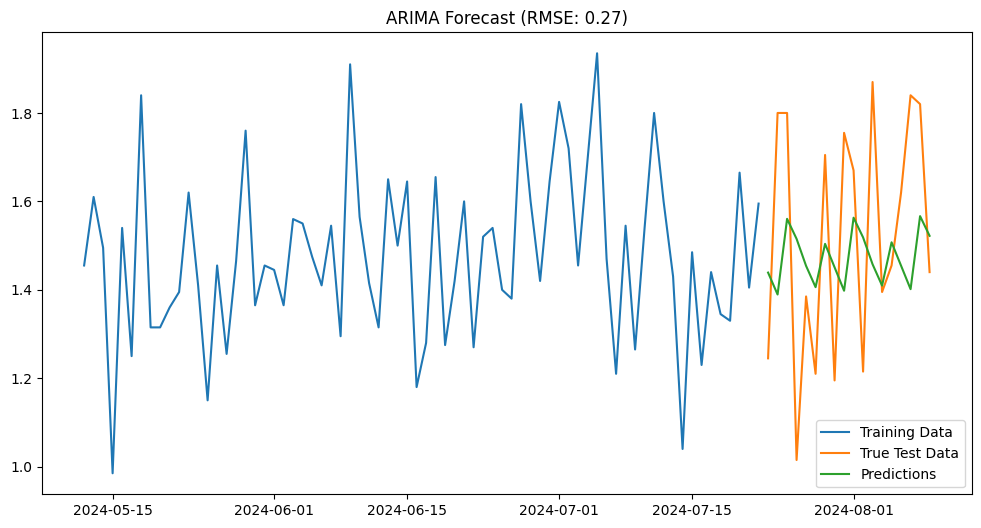

In [ ]:
# Build ARIMA models for each patient
arima_models = {}
for patient in df_resampled['Patient ID'].unique():
    print(f"\nBuilding ARIMA model for Patient {patient}")
    patient_data = df_resampled[df_resampled['Patient ID'] == patient].set_index('Timestamp')['Clinical Dementia Rating']
    model, rmse = build_arima_model(patient_data)
    arima_models[patient] = {'model': model, 'rmse': rmse}

In [ ]:
# Print summary of all models
for patient, model_info in arima_models.items():
    print(f"\nPatient {patient}:")
    print(f"Best ARIMA order: {model_info['model'].order}")
    print(f"RMSE: {model_info['rmse']:.2f}")


Patient 1:
Best ARIMA order: (4, 1, 1)
RMSE: 0.19

Patient 2:
Best ARIMA order: (3, 1, 0)
RMSE: 0.26

Patient 3:
Best ARIMA order: (0, 1, 1)
RMSE: 0.26

Patient 4:
Best ARIMA order: (2, 1, 1)
RMSE: 0.15

Patient 5:
Best ARIMA order: (0, 1, 1)
RMSE: 0.25

Patient 6:
Best ARIMA order: (3, 1, 0)
RMSE: 0.23

Patient 7:
Best ARIMA order: (0, 1, 1)
RMSE: 0.21

Patient 8:
Best ARIMA order: (4, 1, 0)
RMSE: 0.22

Patient 9:
Best ARIMA order: (2, 1, 1)
RMSE: 0.26

Patient 10:
Best ARIMA order: (2, 1, 1)
RMSE: 0.27


# **SARIMAX MODEL:**
target = 'Clinical Dementia Rating'


exog_vars = ['SPO2', 'Blood Pressure Systolic', 'Blood Pressure Diastolic', 'Temperature', 'Heart Rate']


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_squared_error
from math import sqrt

In [ ]:
def build_sarimax_model(patient_data, target='Clinical Dementia Rating', exog_features=['SPO2', 'Blood Pressure Systolic', 'Blood Pressure Diastolic', 'Temperature', 'Heart Rate']):
    # Prepare the data
    y = patient_data[target]
    X = patient_data[exog_features]

    # Split data into train and test sets
    train_size = int(len(y) * 0.8)
    y_train, y_test = y[:train_size], y[train_size:]
    X_train, X_test = X[:train_size], X[train_size:]

    # Fit SARIMAX model
    # Note: You may need to adjust the order and seasonal_order parameters
    model = SARIMAX(y_train, exog=X_train, order=(1, 1, 1), seasonal_order=(1, 1, 1, 7))
    results = model.fit()

    # Print model summary
    print(results.summary())

    # Make predictions
    forecast = results.get_forecast(steps=len(y_test), exog=X_test)
    forecast_mean = forecast.predicted_mean

    # Calculate RMSE
    rmse = sqrt(mean_squared_error(y_test, forecast_mean))
    print(f'RMSE: {rmse}')

    # Plot the results
    plt.figure(figsize=(12, 6))
    plt.plot(y_train.index, y_train, label='Training Data')
    plt.plot(y_test.index, y_test, label='True Test Data')
    plt.plot(y_test.index, forecast_mean, label='Predictions')
    plt.title(f'SARIMAX Forecast (RMSE: {rmse:.2f})')
    plt.legend()
    plt.show()

    return results, rmse


Building SARIMAX model for Patient 1


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                     SARIMAX Results                                     
Dep. Variable:          Clinical Dementia Rating   No. Observations:                   72
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood                   9.217
Date:                           Mon, 26 Aug 2024   AIC                              1.566
Time:                                   07:21:59   BIC                             23.155
Sample:                               05-12-2024   HQIC                            10.071
                                    - 07-22-2024                                         
Covariance Type:                             opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
SPO2                         0.0158      0.027      0.586      0.558      -0.037       0.069
B

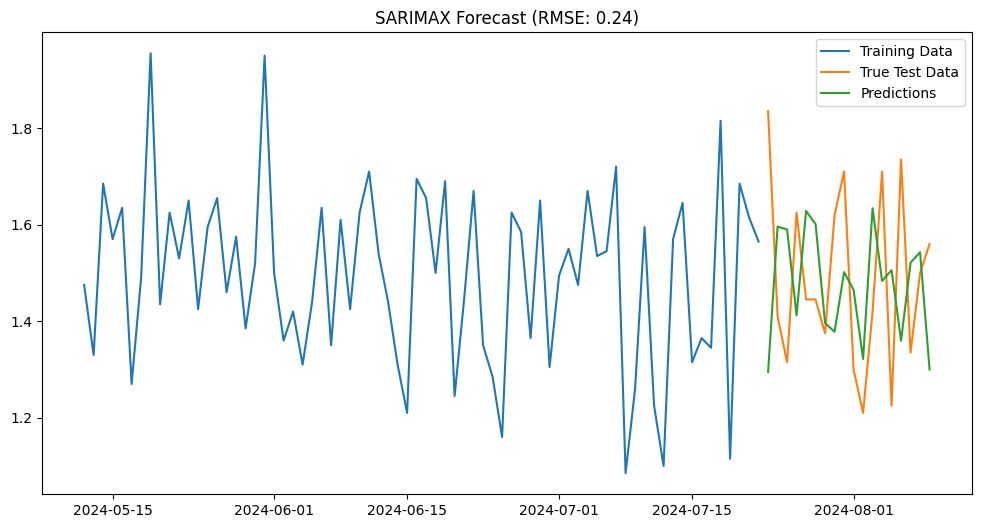


Building SARIMAX model for Patient 2


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                     SARIMAX Results                                     
Dep. Variable:          Clinical Dementia Rating   No. Observations:                   72
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood                   5.836
Date:                           Mon, 26 Aug 2024   AIC                              8.329
Time:                                   07:22:00   BIC                             29.918
Sample:                               05-12-2024   HQIC                            16.834
                                    - 07-22-2024                                         
Covariance Type:                             opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
SPO2                         0.0267      0.032      0.826      0.409      -0.037       0.090
B

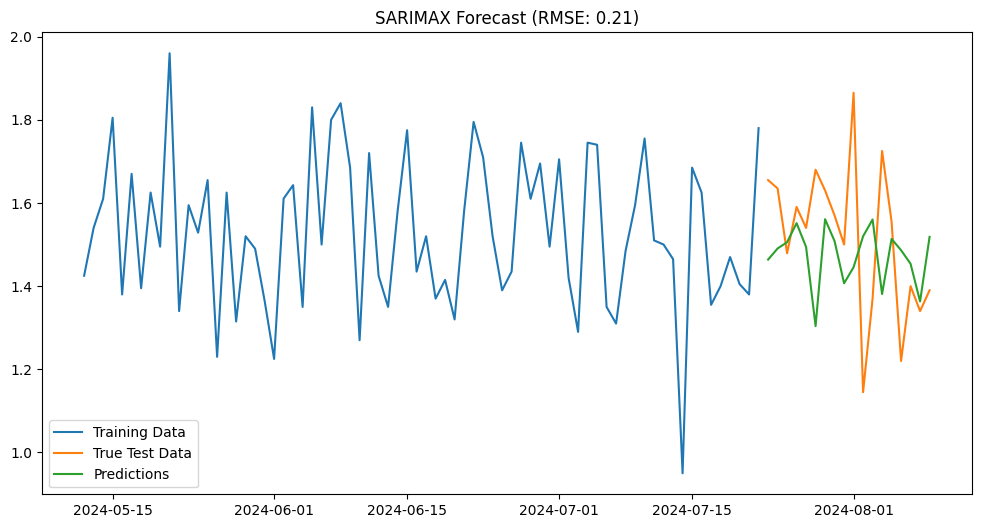


Building SARIMAX model for Patient 3


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                     SARIMAX Results                                     
Dep. Variable:          Clinical Dementia Rating   No. Observations:                   72
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood                   6.458
Date:                           Mon, 26 Aug 2024   AIC                              7.084
Time:                                   07:22:02   BIC                             28.673
Sample:                               05-12-2024   HQIC                            15.589
                                    - 07-22-2024                                         
Covariance Type:                             opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
SPO2                        -0.0001      0.030     -0.004      0.997      -0.058       0.058
B

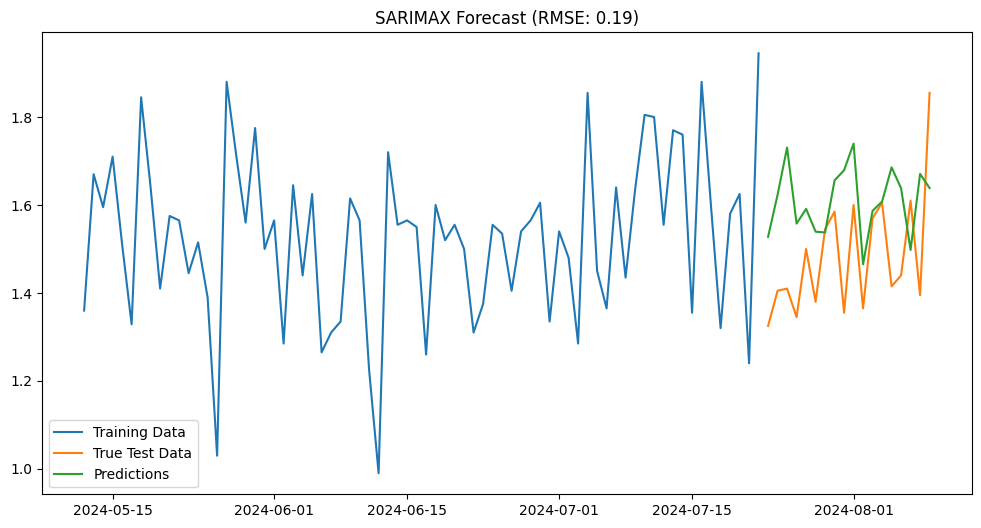


Building SARIMAX model for Patient 4


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                     SARIMAX Results                                     
Dep. Variable:          Clinical Dementia Rating   No. Observations:                   72
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood                   2.182
Date:                           Mon, 26 Aug 2024   AIC                             15.636
Time:                                   07:22:03   BIC                             37.225
Sample:                               05-12-2024   HQIC                            24.141
                                    - 07-22-2024                                         
Covariance Type:                             opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
SPO2                        -0.0177      0.027     -0.661      0.509      -0.070       0.035
B

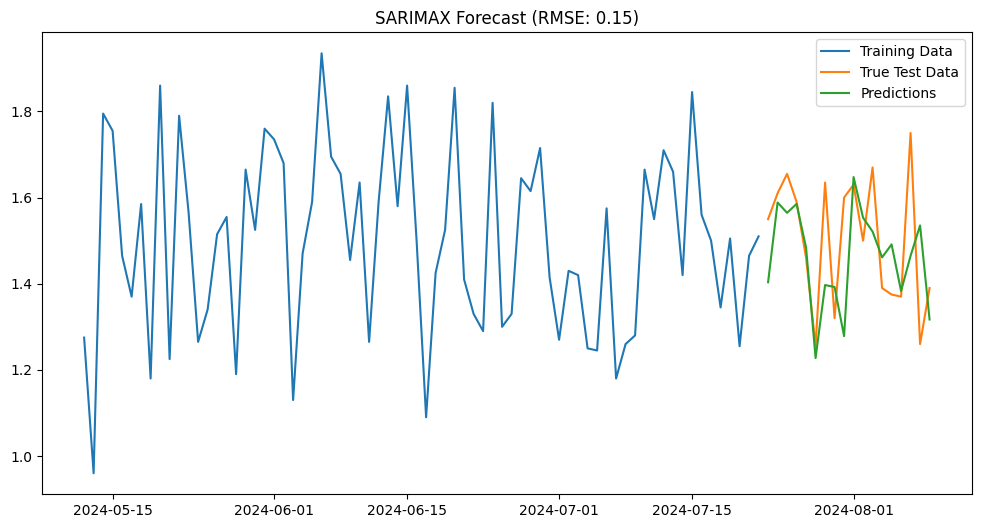


Building SARIMAX model for Patient 5


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                     SARIMAX Results                                     
Dep. Variable:          Clinical Dementia Rating   No. Observations:                   72
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood                  10.912
Date:                           Mon, 26 Aug 2024   AIC                             -1.824
Time:                                   07:22:05   BIC                             19.765
Sample:                               05-12-2024   HQIC                             6.681
                                    - 07-22-2024                                         
Covariance Type:                             opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
SPO2                         0.0297      0.029      1.010      0.313      -0.028       0.087
B

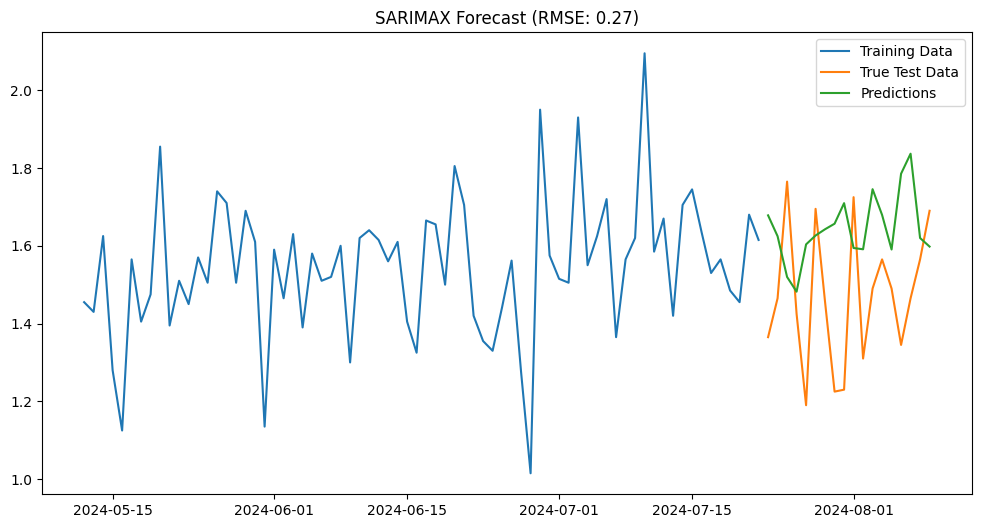


Building SARIMAX model for Patient 6


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                     SARIMAX Results                                     
Dep. Variable:          Clinical Dementia Rating   No. Observations:                   72
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood                   1.701
Date:                           Mon, 26 Aug 2024   AIC                             16.597
Time:                                   07:22:06   BIC                             38.186
Sample:                               05-12-2024   HQIC                            25.102
                                    - 07-22-2024                                         
Covariance Type:                             opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
SPO2                         0.0541      0.031      1.752      0.080      -0.006       0.115
B

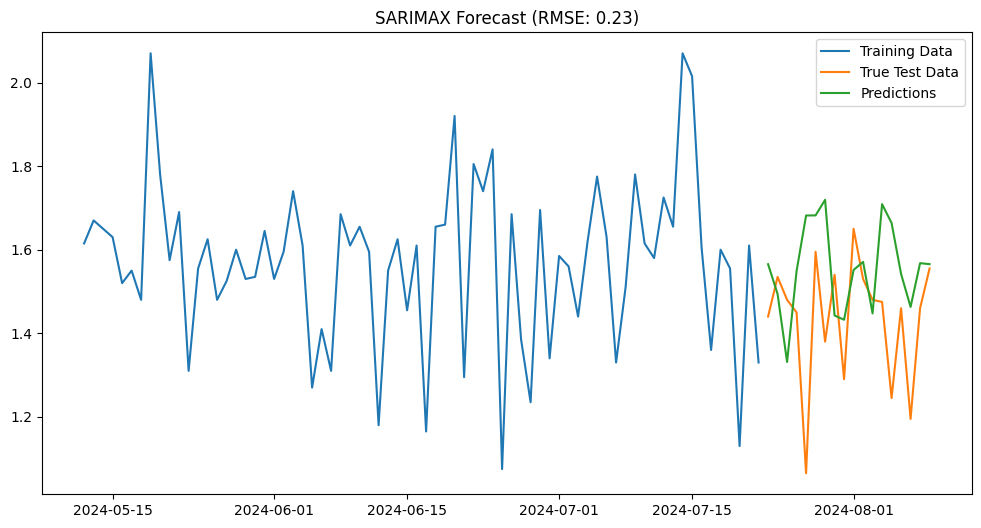


Building SARIMAX model for Patient 7


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimiz

                                     SARIMAX Results                                     
Dep. Variable:          Clinical Dementia Rating   No. Observations:                   72
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood                   7.572
Date:                           Mon, 26 Aug 2024   AIC                              4.856
Time:                                   07:22:07   BIC                             26.445
Sample:                               05-12-2024   HQIC                            13.361
                                    - 07-22-2024                                         
Covariance Type:                             opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
SPO2                         0.0531      0.027      1.979      0.048       0.001       0.106
B

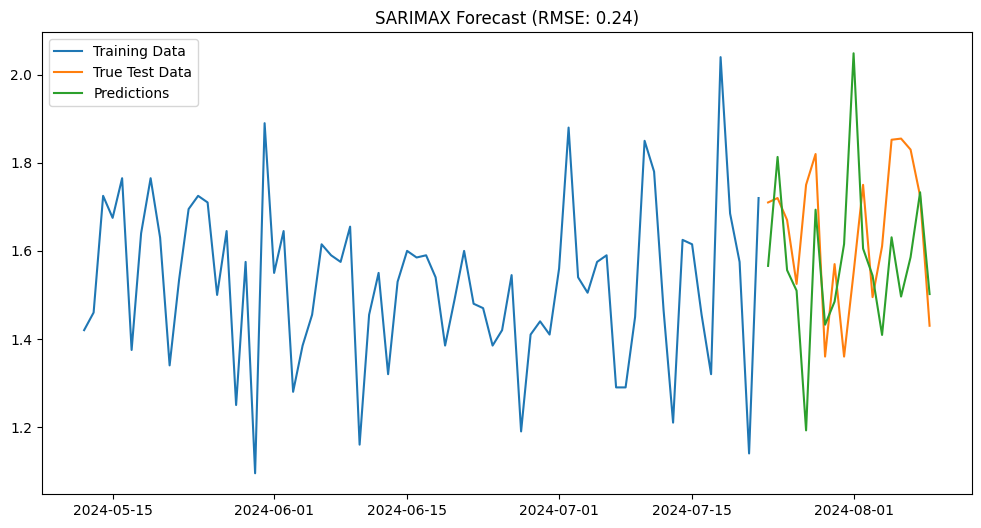


Building SARIMAX model for Patient 8


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                     SARIMAX Results                                     
Dep. Variable:          Clinical Dementia Rating   No. Observations:                   72
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood                   8.383
Date:                           Mon, 26 Aug 2024   AIC                              3.233
Time:                                   07:22:09   BIC                             24.822
Sample:                               05-12-2024   HQIC                            11.738
                                    - 07-22-2024                                         
Covariance Type:                             opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
SPO2                         0.0353      0.025      1.420      0.156      -0.013       0.084
B

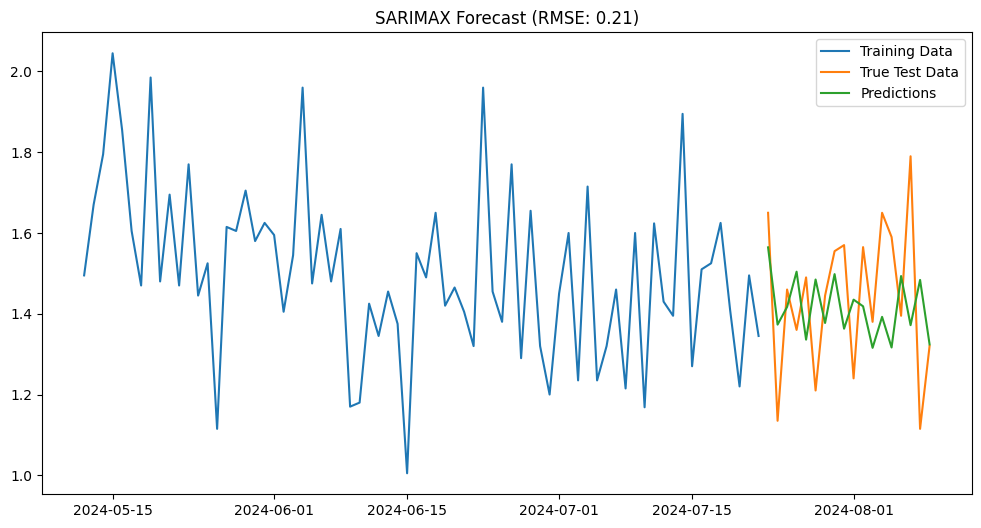


Building SARIMAX model for Patient 9


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                     SARIMAX Results                                     
Dep. Variable:          Clinical Dementia Rating   No. Observations:                   72
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood                  11.624
Date:                           Mon, 26 Aug 2024   AIC                             -3.247
Time:                                   07:22:15   BIC                             18.342
Sample:                               05-12-2024   HQIC                             5.258
                                    - 07-22-2024                                         
Covariance Type:                             opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
SPO2                         0.0280      0.021      1.305      0.192      -0.014       0.070
B

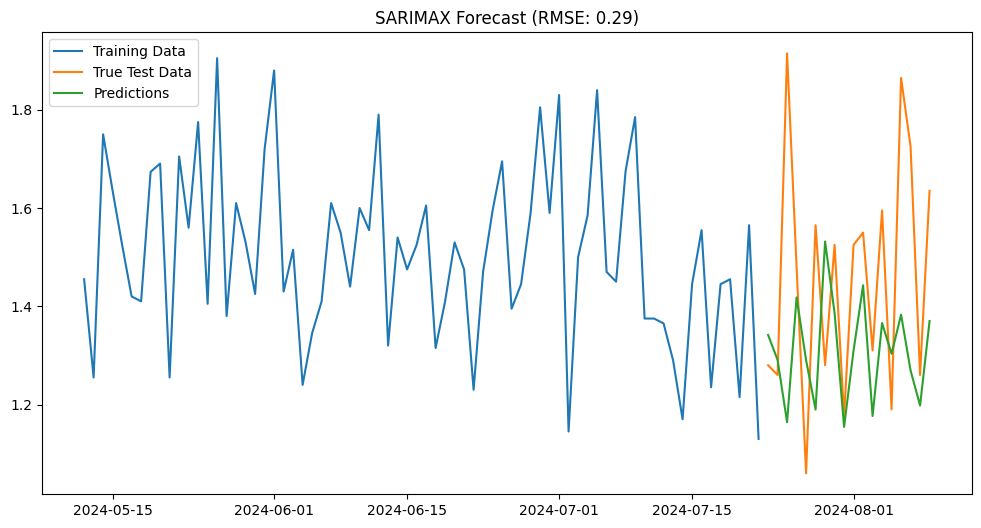


Building SARIMAX model for Patient 10


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                     SARIMAX Results                                     
Dep. Variable:          Clinical Dementia Rating   No. Observations:                   72
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood                   4.399
Date:                           Mon, 26 Aug 2024   AIC                             11.202
Time:                                   07:22:17   BIC                             32.791
Sample:                               05-12-2024   HQIC                            19.707
                                    - 07-22-2024                                         
Covariance Type:                             opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
SPO2                        -0.0223      0.024     -0.935      0.350      -0.069       0.024
B

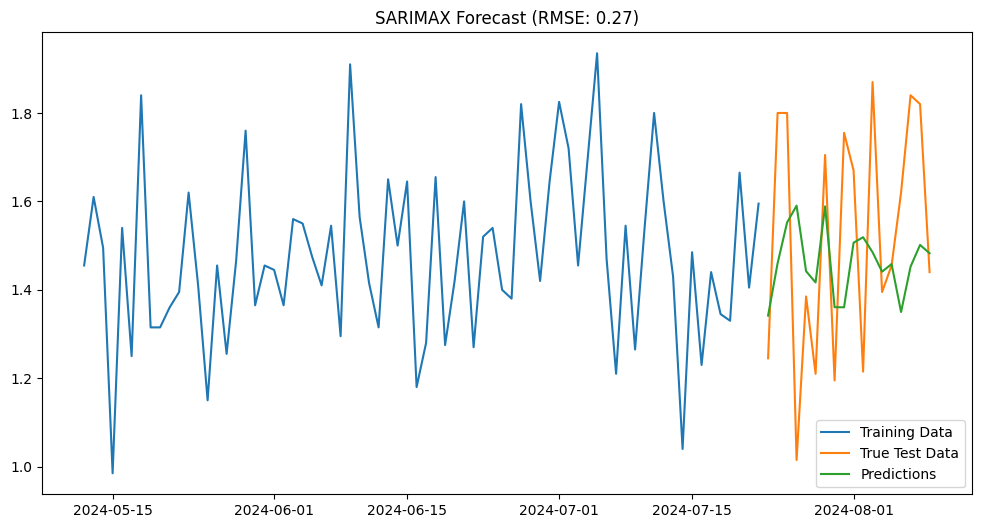

In [ ]:
# Build SARIMAX models for each patient
sarimax_models = {}
for patient in df_resampled['Patient ID'].unique():
    print(f"\nBuilding SARIMAX model for Patient {patient}")
    patient_data = df_resampled[df_resampled['Patient ID'] == patient].set_index('Timestamp')
    model, rmse = build_sarimax_model(patient_data)
    sarimax_models[patient] = {'model': model, 'rmse': rmse}

In [ ]:
# Print summary of all models
for patient, model_info in sarimax_models.items():
    print(f"\nPatient {patient}:")
    print(f"RMSE: {model_info['rmse']:.2f}")


Patient 1:
RMSE: 0.24

Patient 2:
RMSE: 0.21

Patient 3:
RMSE: 0.19

Patient 4:
RMSE: 0.15

Patient 5:
RMSE: 0.27

Patient 6:
RMSE: 0.23

Patient 7:
RMSE: 0.24

Patient 8:
RMSE: 0.21

Patient 9:
RMSE: 0.29

Patient 10:
RMSE: 0.27


# **ARIMAX Model:**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from itertools import product
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

In [ ]:
target = 'Clinical Dementia Rating'
exog_vars = ['SPO2', 'Blood Pressure Systolic', 'Blood Pressure Diastolic', 'Temperature', 'Heart Rate']


In [ ]:
df_resampled = df_resampled.reset_index()

In [ ]:
# Function to evaluate ARIMAX model for a single patient
def evaluate_arimax(data, order, seasonal_order, exog):
    # Split data into train and test sets
    train_size = int(len(data) * 0.8)
    train, test = data[:train_size], data[train_size:]

    # Fit the model
    model = SARIMAX(train[target], exog=train[exog], order=order, seasonal_order=seasonal_order,
                    enforce_stationarity=False, enforce_invertibility=False)
    try:
        results = model.fit(disp=False, maxiter=200)
    except:
        return None, None, None, None

    # Make predictions
    predictions = results.forecast(steps=len(test), exog=test[exog])

    # Calculate error metrics
    mse = mean_squared_error(test[target], predictions)
    mae = mean_absolute_error(test[target], predictions)
    rmse = np.sqrt(mse)
    r2 = r2_score(test[target], predictions)

    return results, mse, mae, rmse, r2


In [ ]:
# Define parameter ranges for grid search
p = d = q = range(0, 2)
pdq = list(product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(product(p, d, q))]

In [ ]:
# Perform grid search for each patient
best_models = {}
for patient_id, group in tqdm(df_resampled.groupby('Patient ID')):
    best_score = float('inf')
    best_model = None
    best_params = None
    best_seasonal_params = None

    for param in pdq:
        for param_seasonal in seasonal_pdq:
            results, mse, mae, rmse, r2 = evaluate_arimax(group, param, param_seasonal, exog_vars)
            if results is not None and mse < best_score:
                best_score = mse
                best_model = results
                best_params = param
                best_seasonal_params = param_seasonal

    best_models[patient_id] = {
        'model': best_model,
        'params': best_params,
        'seasonal_params': best_seasonal_params,
        'mse': best_score
    }

100%|██████████| 10/10 [07:29<00:00, 44.93s/it]


In [ ]:
# Make predictions for all patients
all_predictions = []
for patient_id, group in df_resampled.groupby('Patient ID'):
    model = best_models[patient_id]['model']
    predictions = model.get_forecast(steps=len(group), exog=group[exog_vars])
    predicted_mean = predictions.predicted_mean
    all_predictions.append(pd.DataFrame({
        'Patient ID': patient_id,
        'Timestamp': group['Timestamp'],
        'Actual': group[target],
        'Predicted': predicted_mean
    }))

In [ ]:
results_df = pd.concat(all_predictions, ignore_index=True)

In [ ]:
# Print information about NaN values
print("NaN values in results:")
print(results_df.isna().sum())

# Remove rows with NaN values
results_df_clean = results_df.dropna()

NaN values in results:
Patient ID      0
Timestamp     810
Actual        810
Predicted     810
dtype: int64


In [ ]:
print("\nShape before removing NaNs:", results_df.shape)
print("Shape after removing NaNs:", results_df_clean.shape)

# Calculate overall error metrics
mse = mean_squared_error(results_df_clean['Actual'], results_df_clean['Predicted'])
mae = mean_absolute_error(results_df_clean['Actual'], results_df_clean['Predicted'])
rmse = np.sqrt(mse)
r2 = r2_score(results_df_clean['Actual'], results_df_clean['Predicted'])


Shape before removing NaNs: (1710, 4)
Shape after removing NaNs: (90, 4)


In [ ]:
print(f'\nOverall Model Performance:')
print(f'MSE: {mse}')
print(f'MAE: {mae}')
print(f'RMSE: {rmse}')
print(f'R-squared: {r2}')


Overall Model Performance:
MSE: 0.034702561675122985
MAE: 0.15435908775717902
RMSE: 0.18628623587136808
R-squared: -0.045185105679014015


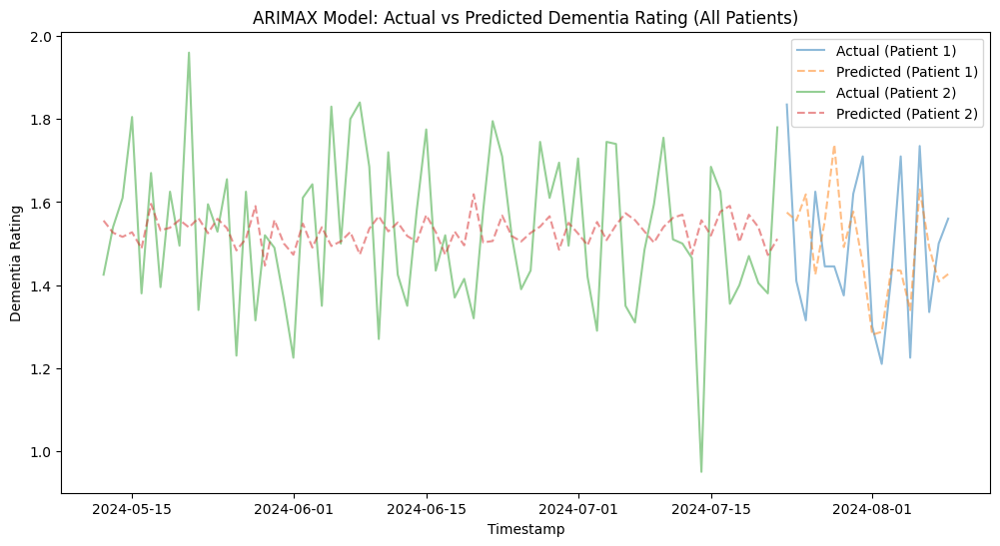

In [ ]:
# Plot overall results
plt.figure(figsize=(12, 6))
for patient_id, group in results_df_clean.groupby('Patient ID'):
    plt.plot(group['Timestamp'], group['Actual'], label=f'Actual (Patient {patient_id})', alpha=0.5)
    plt.plot(group['Timestamp'], group['Predicted'], label=f'Predicted (Patient {patient_id})', linestyle='--', alpha=0.5)

plt.title('ARIMAX Model: Actual vs Predicted Dementia Rating (All Patients)')
plt.xlabel('Timestamp')
plt.ylabel('Dementia Rating')
plt.legend()
plt.show()

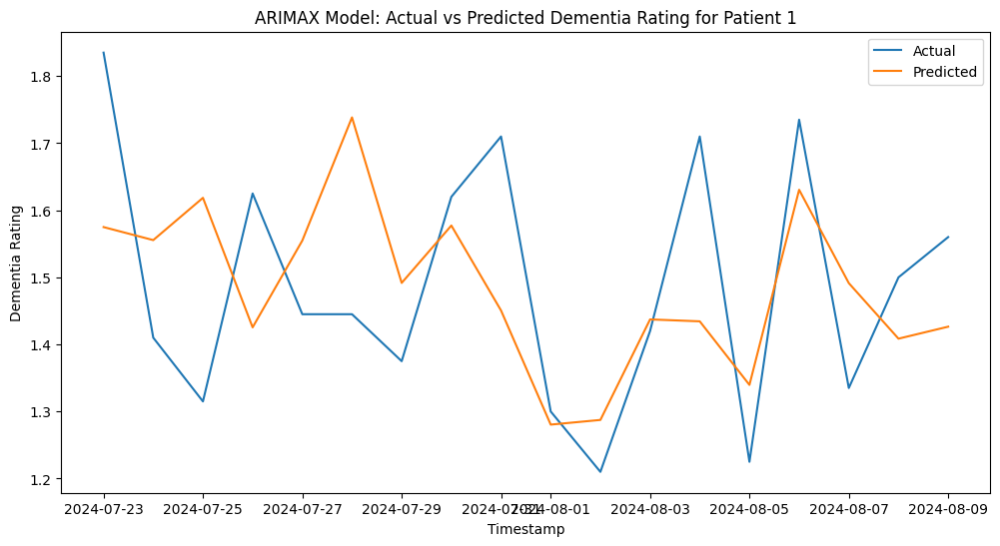

In [ ]:
# Plot results for a single patient
patient_id = results_df_clean['Patient ID'].unique()[0]  # Get the first patient ID
patient_results = results_df_clean[results_df_clean['Patient ID'] == patient_id]

plt.figure(figsize=(12, 6))
plt.plot(patient_results['Timestamp'], patient_results['Actual'], label='Actual')
plt.plot(patient_results['Timestamp'], patient_results['Predicted'], label='Predicted')
plt.title(f'ARIMAX Model: Actual vs Predicted Dementia Rating for Patient {patient_id}')
plt.xlabel('Timestamp')
plt.ylabel('Dementia Rating')
plt.legend()
plt.show()

# **LSTM model:**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, r2_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
from math import sqrt

In [ ]:
def create_sequences(data, target, seq_length):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i:(i + seq_length)])
        y.append(target[i + seq_length])
    return np.array(X), np.array(y)

In [ ]:
def build_lstm_model(patient_data, seq_length=7):
    # Define features and target
    features = ['SPO2', 'Blood Pressure Systolic', 'Blood Pressure Diastolic', 'Temperature', 'Heart Rate']
    target = 'Clinical Dementia Rating'

    # Normalize the data
    scaler_X = MinMaxScaler(feature_range=(0, 1))
    scaler_y = MinMaxScaler(feature_range=(0, 1))

    scaled_features = scaler_X.fit_transform(patient_data[features])
    scaled_target = scaler_y.fit_transform(patient_data[[target]])

    # Create sequences
    X, y = create_sequences(scaled_features, scaled_target, seq_length)

    # Split into train and test sets
    train_size = int(len(X) * 0.8)
    X_train, X_test = X[:train_size], X[train_size:]
    y_train, y_test = y[:train_size], y[train_size:]

    # Build the LSTM model
    model = Sequential([
        LSTM(50, activation='relu', input_shape=(seq_length, len(features))),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2, verbose=0)

    # Make predictions
    train_predict = model.predict(X_train)
    test_predict = model.predict(X_test)

    # Invert predictions to original scale
    train_predict = scaler_y.inverse_transform(train_predict)
    y_train = scaler_y.inverse_transform(y_train)
    test_predict = scaler_y.inverse_transform(test_predict)
    y_test = scaler_y.inverse_transform(y_test)

    # Calculate RMSE and R2 score
    train_rmse = sqrt(mean_squared_error(y_train, train_predict))
    test_rmse = sqrt(mean_squared_error(y_test, test_predict))
    train_r2 = r2_score(y_train, train_predict)
    test_r2 = r2_score(y_test, test_predict)

    print(f'Train RMSE: {train_rmse:.3f}')
    print(f'Test RMSE: {test_rmse:.3f}')
    print(f'Train R2 Score: {train_r2:.3f}')
    print(f'Test R2 Score: {test_r2:.3f}')

    # Plot results
    plt.figure(figsize=(12, 6))
    plt.plot(patient_data.index[seq_length:train_size+seq_length], y_train, label='Train Actual')
    plt.plot(patient_data.index[seq_length:train_size+seq_length], train_predict, label='Train Predict')
    plt.plot(patient_data.index[train_size+seq_length:], y_test, label='Test Actual')
    plt.plot(patient_data.index[train_size+seq_length:], test_predict, label='Test Predict')
    plt.title('LSTM Model: Clinical Dementia Rating Prediction')
    plt.legend()
    plt.show()

    # Plot loss
    plt.figure(figsize=(12, 6))
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()
    plt.show()

    return model, train_rmse, test_rmse, train_r2, test_r2


Building LSTM model for Patient 1
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Train RMSE: 0.177
Test RMSE: 0.177
Train R2 Score: 0.129
Test R2 Score: -0.164


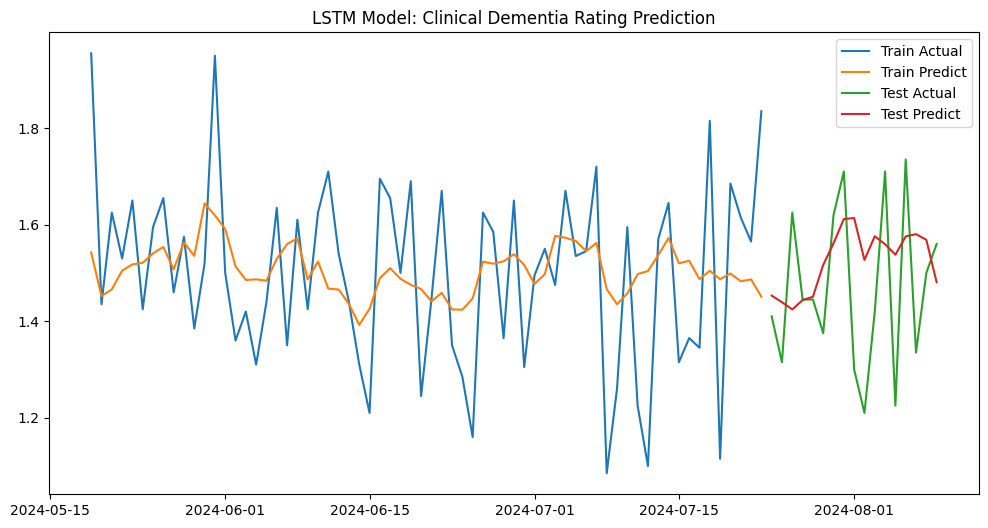

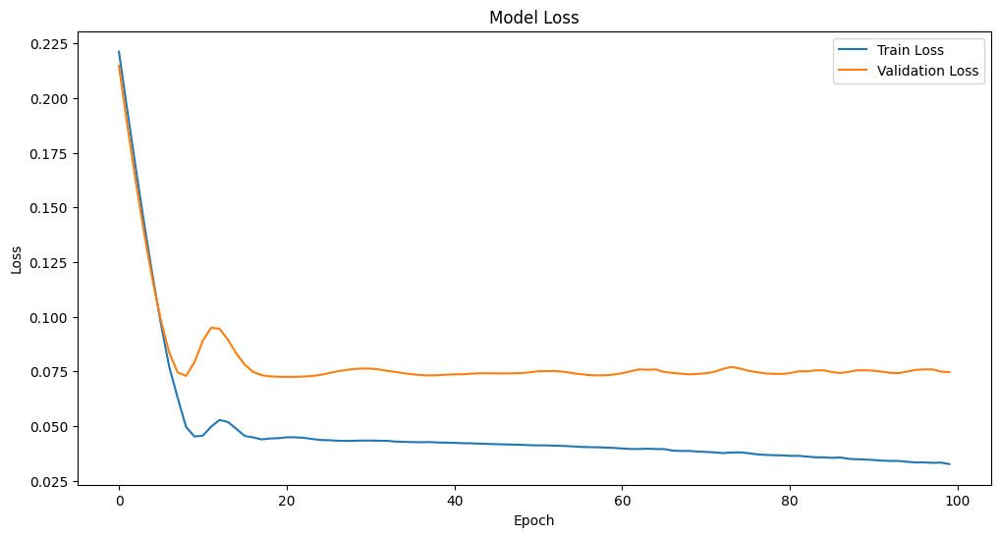


Building LSTM model for Patient 2
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Train RMSE: 0.177
Test RMSE: 0.179
Train R2 Score: 0.078
Test R2 Score: -0.018


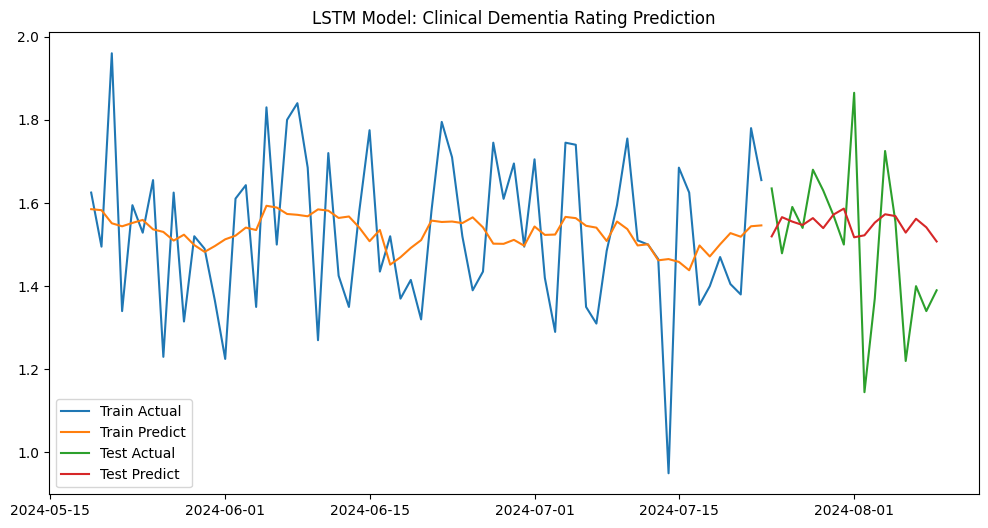

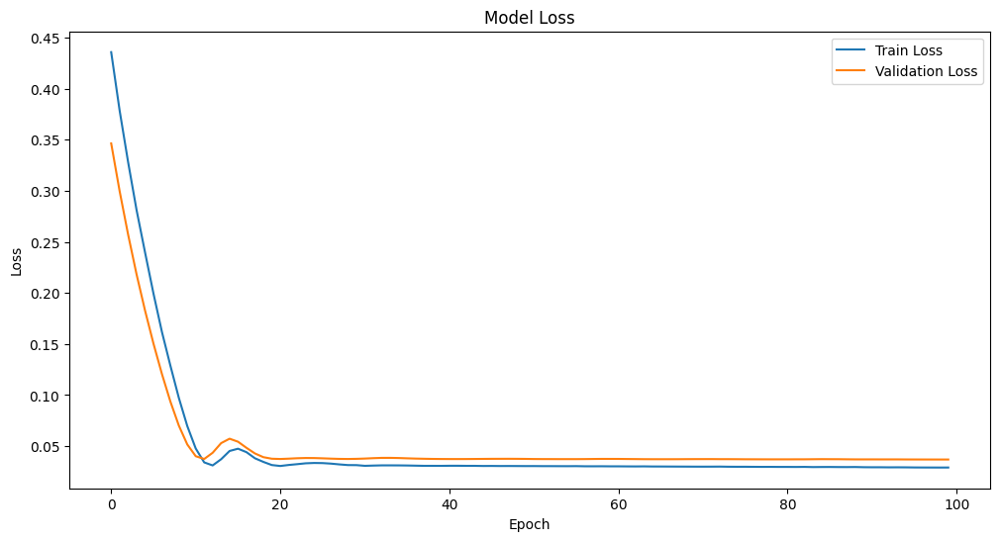


Building LSTM model for Patient 3


1/3 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Train RMSE: 0.188
Test RMSE: 0.134
Train R2 Score: 0.032
Test R2 Score: -0.058


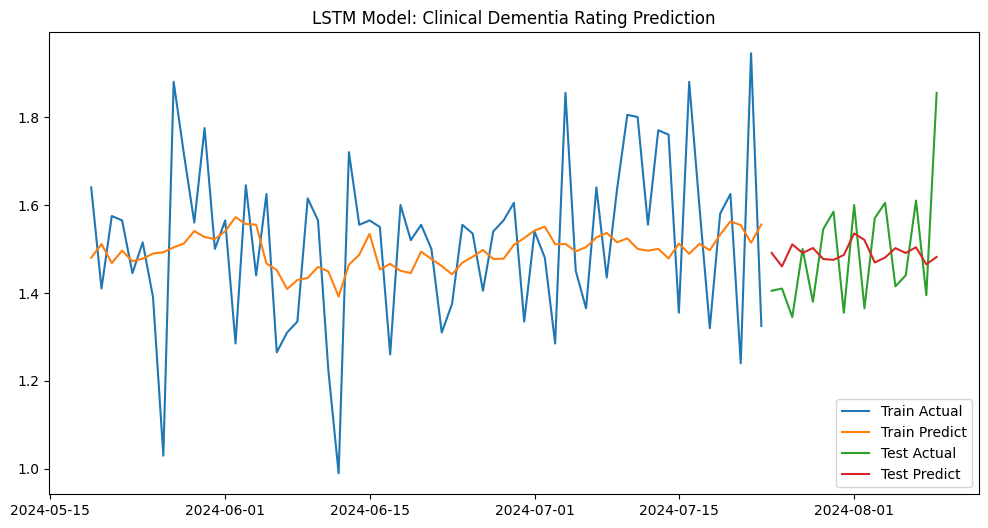

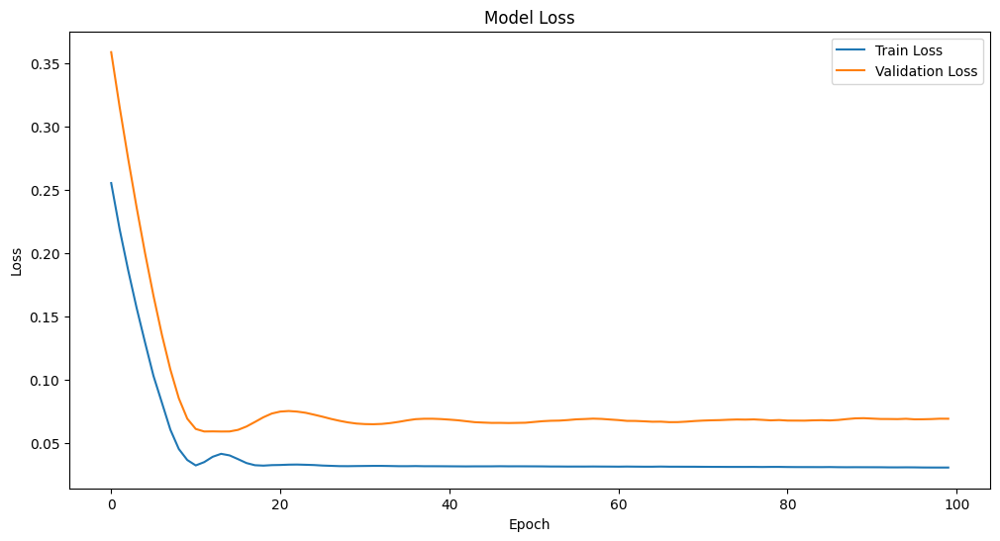


Building LSTM model for Patient 4
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Train RMSE: 0.203
Test RMSE: 0.166
Train R2 Score: 0.047
Test R2 Score: -0.201


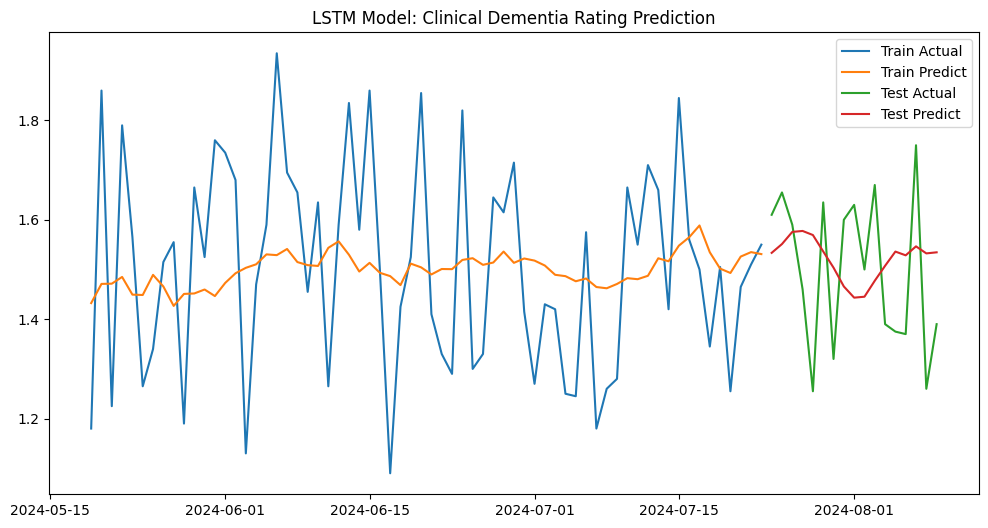

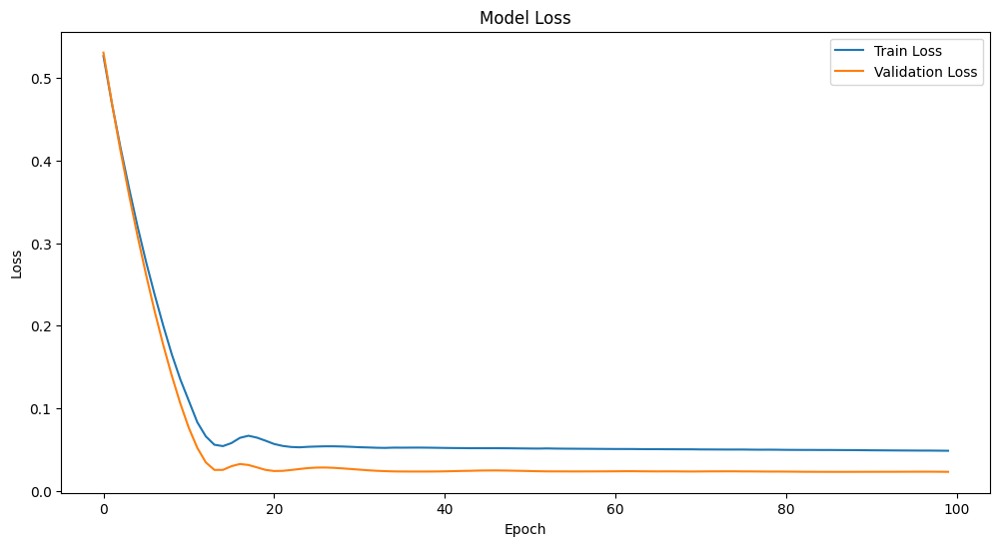


Building LSTM model for Patient 5
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Train RMSE: 0.167
Test RMSE: 0.171
Train R2 Score: 0.096
Test R2 Score: 0.021


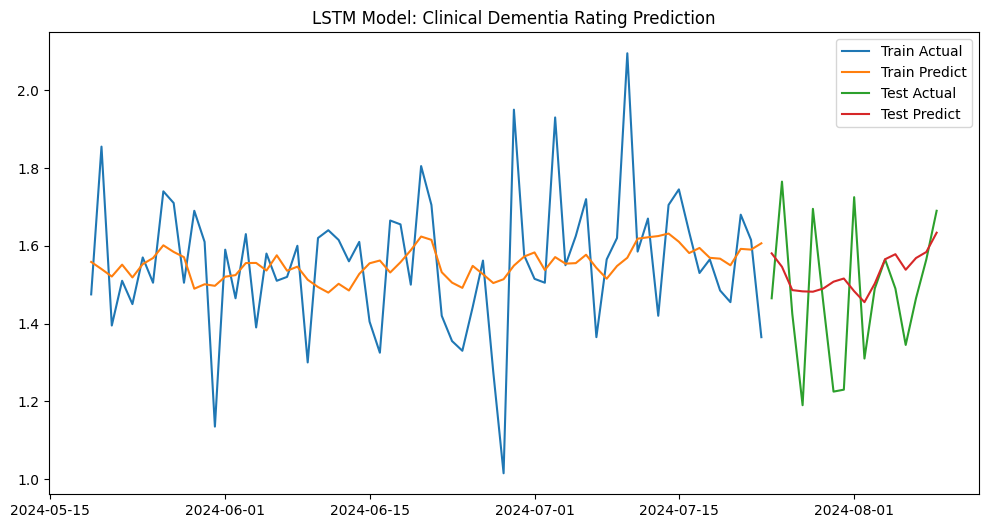

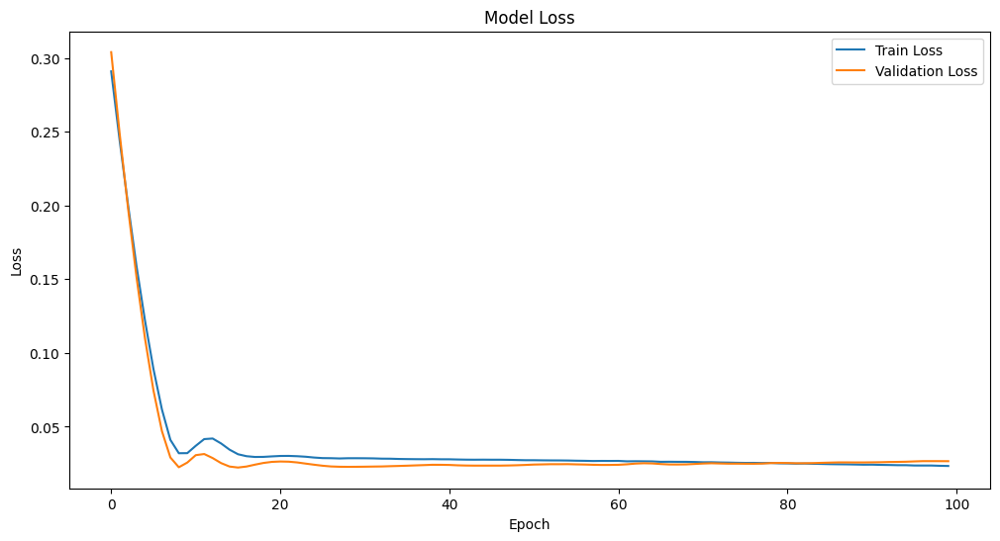


Building LSTM model for Patient 6
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Train RMSE: 0.188
Test RMSE: 0.196
Train R2 Score: 0.161
Test R2 Score: -0.729


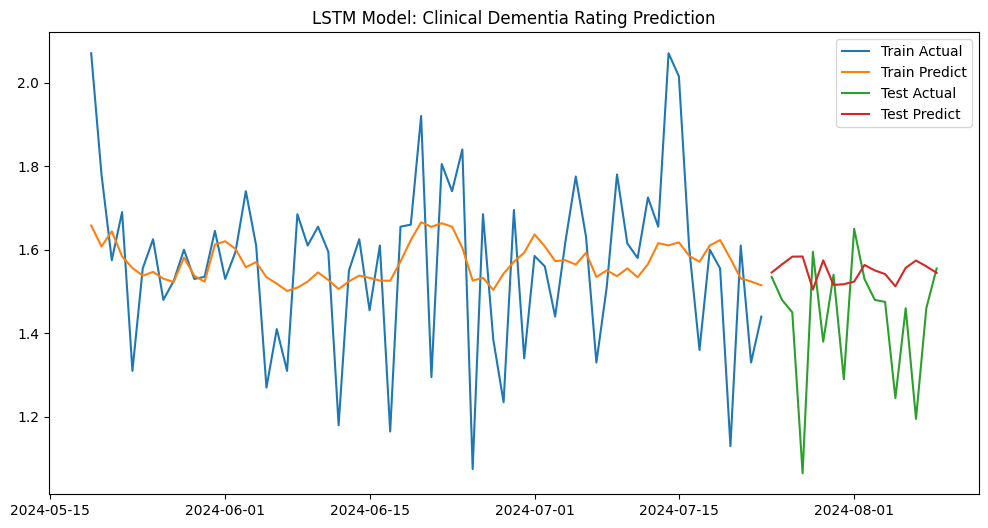

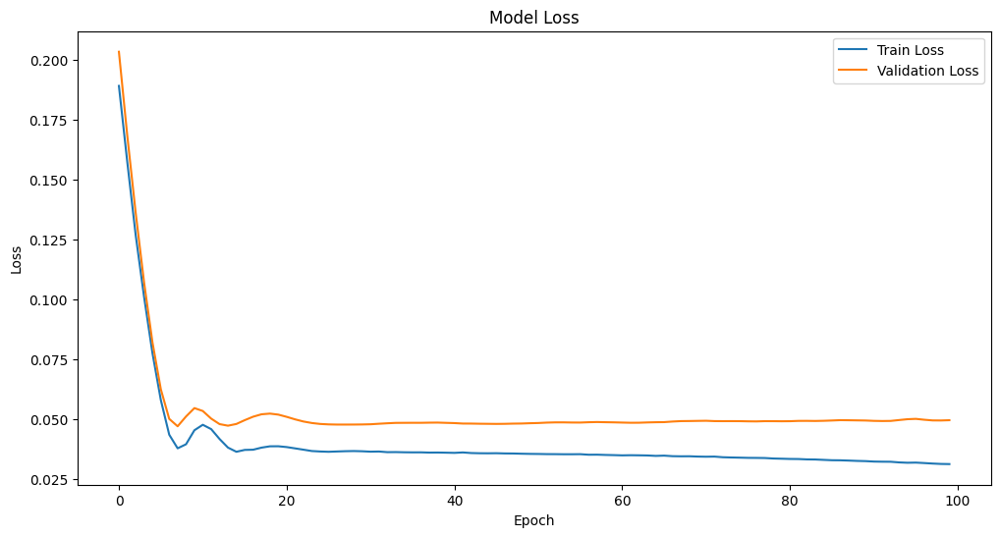


Building LSTM model for Patient 7
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Train RMSE: 0.184
Test RMSE: 0.195
Train R2 Score: 0.012
Test R2 Score: -0.440


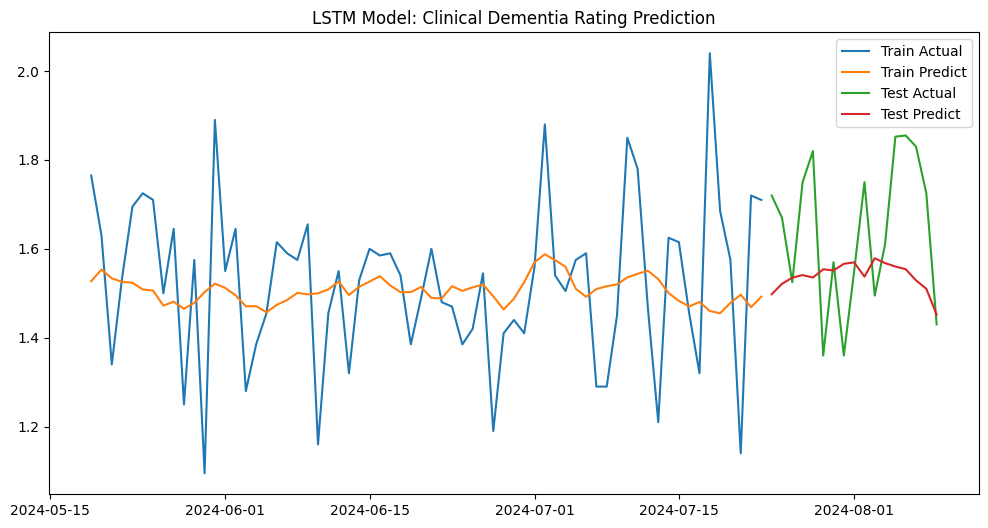

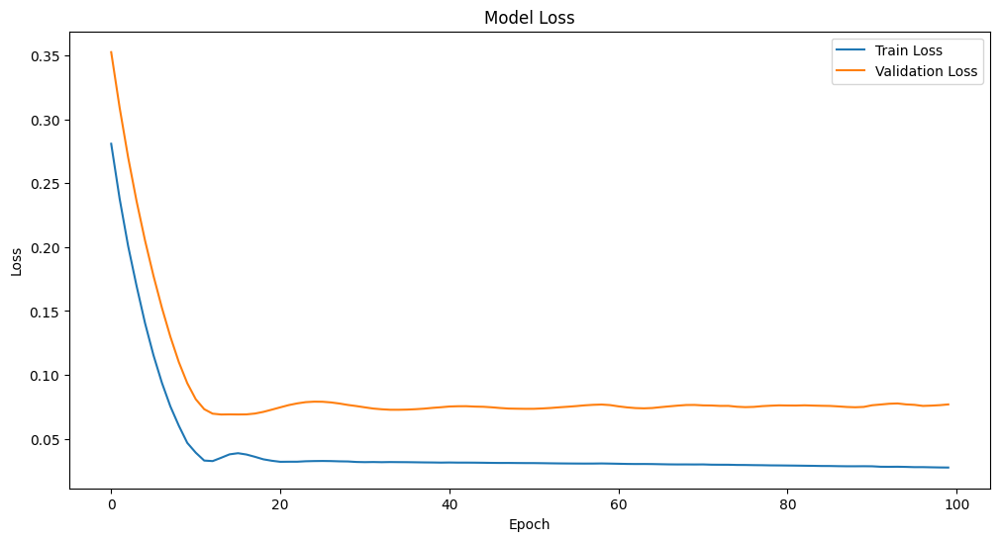


Building LSTM model for Patient 8
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Train RMSE: 0.184
Test RMSE: 0.189
Train R2 Score: 0.184
Test R2 Score: -0.102


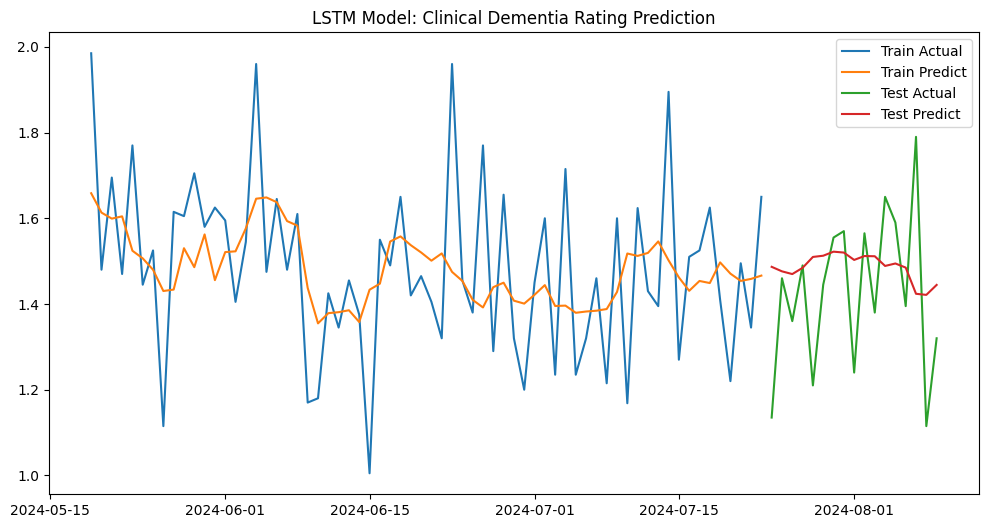

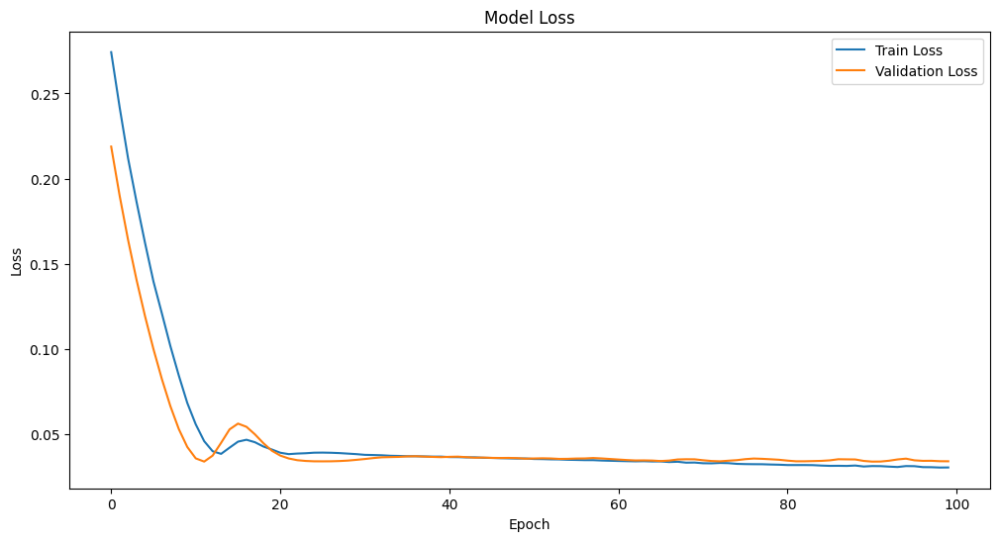


Building LSTM model for Patient 9
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Train RMSE: 0.249
Test RMSE: 0.261
Train R2 Score: -0.832
Test R2 Score: -0.196


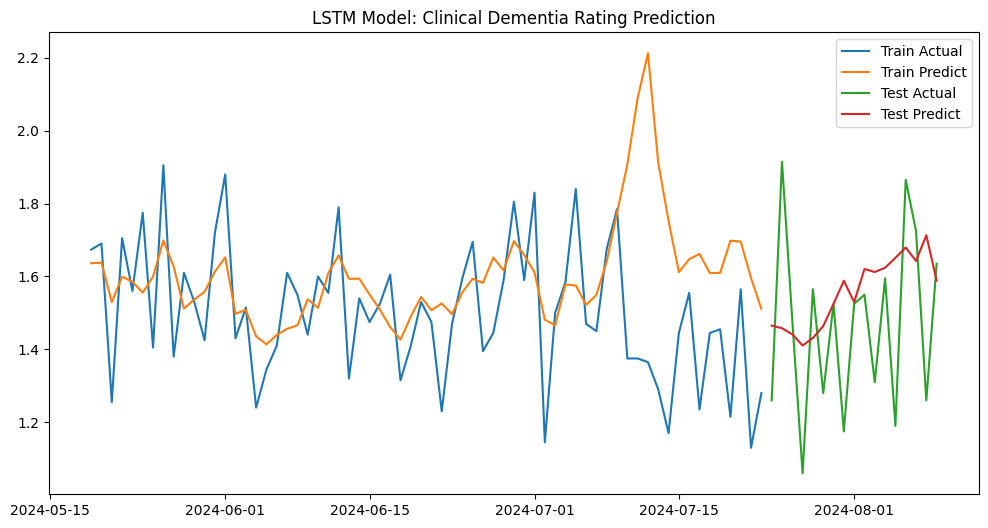

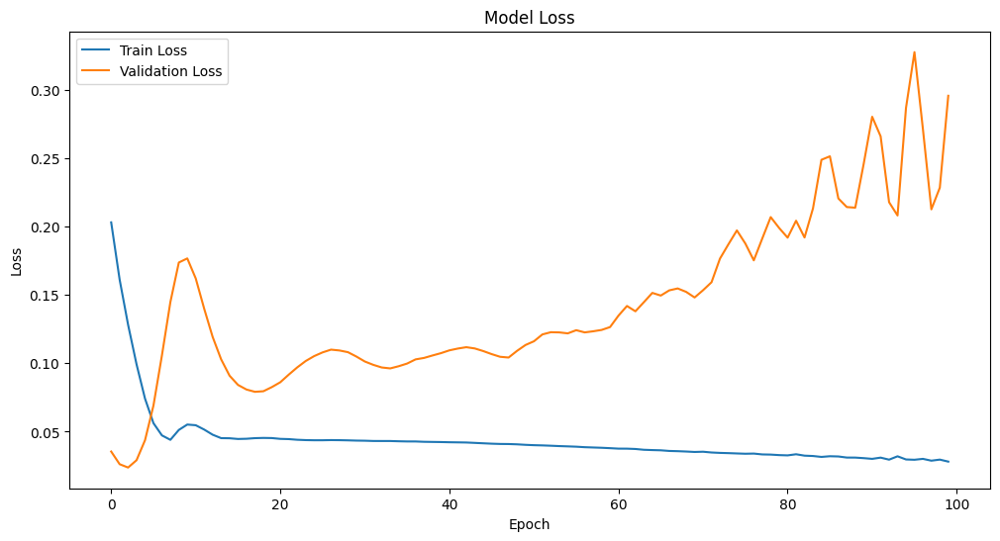


Building LSTM model for Patient 10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Train RMSE: 0.176
Test RMSE: 0.291
Train R2 Score: 0.080
Test R2 Score: -0.220


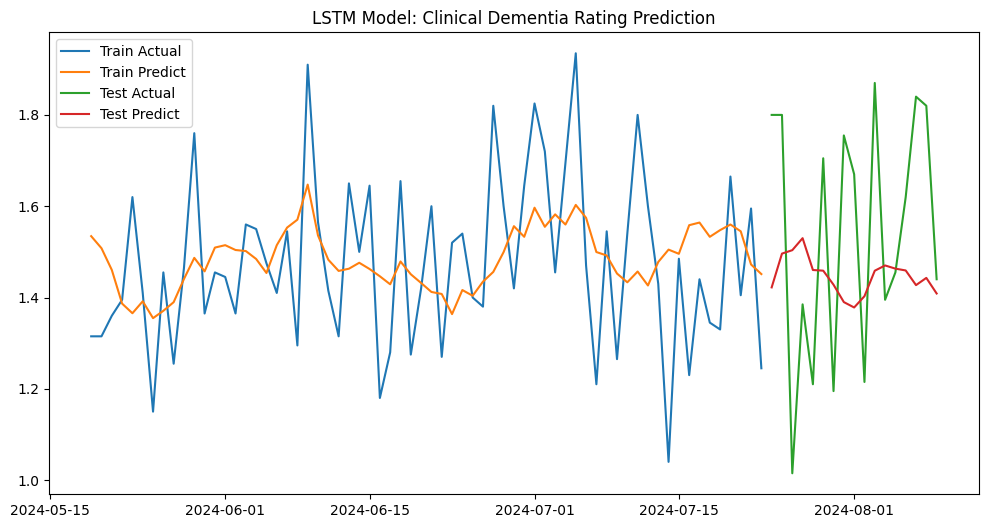

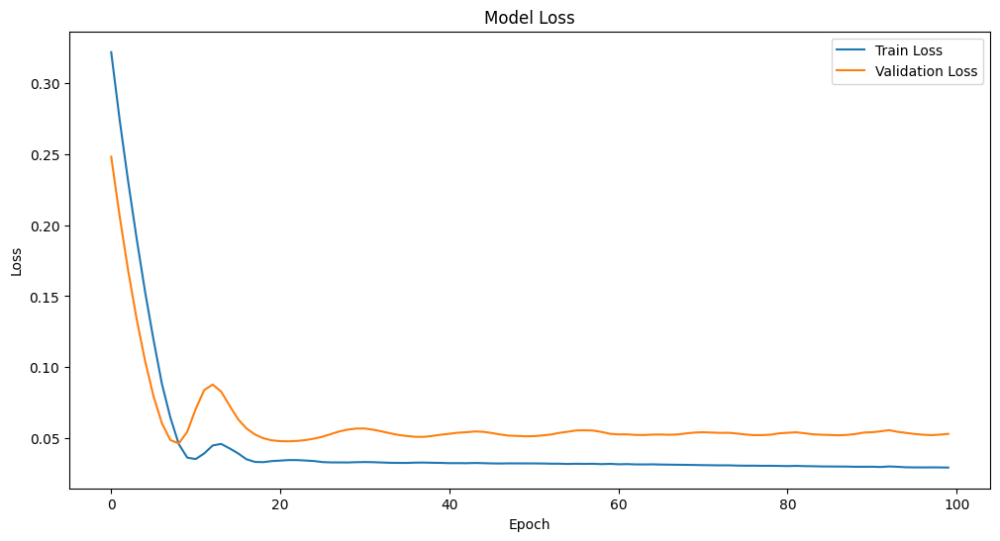

In [ ]:
# Build LSTM models for each patient
lstm_models = {}
for patient in df_resampled['Patient ID'].unique():
    print(f"\nBuilding LSTM model for Patient {patient}")
    patient_data = df_resampled[df_resampled['Patient ID'] == patient].set_index('Timestamp')
    model, train_rmse, test_rmse, train_r2, test_r2 = build_lstm_model(patient_data)
    lstm_models[patient] = {
        'model': model,
        'train_rmse': train_rmse,
        'test_rmse': test_rmse,
        'train_r2': train_r2,
        'test_r2': test_r2
    }

In [ ]:
# Print summary of all models
for patient, model_info in lstm_models.items():
    print(f"\nPatient {patient}:")
    print(f"Train RMSE: {model_info['train_rmse']:.3f}")
    print(f"Test RMSE: {model_info['test_rmse']:.3f}")
    print(f"Train R2 Score: {model_info['train_r2']:.3f}")
    print(f"Test R2 Score: {model_info['test_r2']:.3f}")


Patient 1:
Train RMSE: 0.177
Test RMSE: 0.177
Train R2 Score: 0.129
Test R2 Score: -0.164

Patient 2:
Train RMSE: 0.177
Test RMSE: 0.179
Train R2 Score: 0.078
Test R2 Score: -0.018

Patient 3:
Train RMSE: 0.188
Test RMSE: 0.134
Train R2 Score: 0.032
Test R2 Score: -0.058

Patient 4:
Train RMSE: 0.203
Test RMSE: 0.166
Train R2 Score: 0.047
Test R2 Score: -0.201

Patient 5:
Train RMSE: 0.167
Test RMSE: 0.171
Train R2 Score: 0.096
Test R2 Score: 0.021

Patient 6:
Train RMSE: 0.188
Test RMSE: 0.196
Train R2 Score: 0.161
Test R2 Score: -0.729

Patient 7:
Train RMSE: 0.184
Test RMSE: 0.195
Train R2 Score: 0.012
Test R2 Score: -0.440

Patient 8:
Train RMSE: 0.184
Test RMSE: 0.189
Train R2 Score: 0.184
Test R2 Score: -0.102

Patient 9:
Train RMSE: 0.249
Test RMSE: 0.261
Train R2 Score: -0.832
Test R2 Score: -0.196

Patient 10:
Train RMSE: 0.176
Test RMSE: 0.291
Train R2 Score: 0.080
Test R2 Score: -0.220


# **Prophet Model:**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from prophet import Prophet
from prophet.plot import plot_plotly, plot_components_plotly
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from tqdm import tqdm

In [ ]:
df_resampled['Timestamp'] = pd.to_datetime(df_resampled['Timestamp'])


In [ ]:
target = 'Clinical Dementia Rating'
exog_vars = ['SPO2', 'Blood Pressure Systolic', 'Blood Pressure Diastolic', 'Temperature', 'Heart Rate']

In [ ]:
# Function to prepare data for Prophet
def prepare_prophet_data(data, target, exog_vars):
    df = data.copy()
    df = df.rename(columns={'Timestamp': 'ds', target: 'y'})
    return df[['ds', 'y'] + exog_vars]

In [ ]:
# Function to evaluate Prophet model
def evaluate_prophet(train, test, exog_vars):
    model = Prophet()
    for var in exog_vars:
        model.add_regressor(var)

    model.fit(train)

    future = test[['ds'] + exog_vars]
    forecast = model.predict(future)

    y_true = test['y'].values
    y_pred = forecast['yhat'].values

    mse = mean_squared_error(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)

    return model, mse, mae, rmse, r2

In [ ]:
# Prepare data and evaluate model for each patient
results = {}
for patient_id, group in tqdm(df_resampled.groupby('Patient ID')):
    data = prepare_prophet_data(group, target, exog_vars)

    # Split data into train and test sets
    train_size = int(len(data) * 0.8)
    train, test = data[:train_size], data[train_size:]

    model, mse, mae, rmse, r2 = evaluate_prophet(train, test, exog_vars)

    results[patient_id] = {
        'model': model,
        'mse': mse,
        'mae': mae,
        'rmse': rmse,
        'r2': r2
    }

  0%|          | 0/10 [00:00<?, ?it/s]INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpz8pq03y7/qtf1rl8i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpz8pq03y7/l86lltc3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=85119', 'data', 'file=/tmp/tmpz8pq03y7/qtf1rl8i.json', 'init=/tmp/tmpz8pq03y7/l86lltc3.json', 'output', 'file=/tmp/tmpz8pq03y7/prophet_model54vd3w61/prophet_model-20240826073140.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
07:31:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
07:31:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
 

In [ ]:
# Print average metrics across all patients
avg_mse = np.mean([res['mse'] for res in results.values()])
avg_mae = np.mean([res['mae'] for res in results.values()])
avg_rmse = np.mean([res['rmse'] for res in results.values()])
avg_r2 = np.mean([res['r2'] for res in results.values()])

print(f'Average Model Performance:')
print(f'MSE: {avg_mse}')
print(f'MAE: {avg_mae}')
print(f'RMSE: {avg_rmse}')
print(f'R-squared: {avg_r2}')

Average Model Performance:
MSE: 0.050784840320700145
MAE: 0.18120241633580508
RMSE: 0.22156513304337264
R-squared: -0.6330662694565146


In [ ]:
# Plot results for a single patient (you can change the patient_id as needed)
patient_id = list(results.keys())[0]
model = results[patient_id]['model']
data = prepare_prophet_data(df_resampled[df_resampled['Patient ID'] == patient_id], target, exog_vars)


In [ ]:
future = model.make_future_dataframe(periods=365)  # Forecast for next year
for var in exog_vars:
    future[var] = data[var].mean()  # Use mean values for exogenous variables


In [ ]:
forecast = model.predict(future)

In [ ]:
fig1 = plot_plotly(model, forecast)
fig1.show()

In [ ]:
fig2 = plot_components_plotly(model, forecast)
fig2.show()

# **ARIMA with Future forecast**

In [ ]:
pip install pmdarima

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pmdarima import auto_arima
from sklearn.metrics import mean_squared_error
from math import sqrt

In [ ]:
def build_arima_model(patient_data):
    # Fit auto_arima model
    model = auto_arima(patient_data, start_p=1, start_q=1, max_p=5, max_q=5, m=7,
                       start_P=0, seasonal=True, d=1, D=1, trace=True,
                       error_action='ignore', suppress_warnings=True, stepwise=True)

    # Print the model summary
    print(model.summary())

    # Split data into train and test sets
    train_size = int(len(patient_data) * 0.8)
    train, test = patient_data[:train_size], patient_data[train_size:]

    # Fit the model on the training data
    model.fit(train)

    # Make predictions for the test set
    forecast = model.predict(n_periods=len(test))

    # Calculate RMSE
    rmse = sqrt(mean_squared_error(test, forecast))
    print(f'RMSE: {rmse}')

    # Plot the results
    plt.figure(figsize=(12, 6))
    plt.plot(train.index, train, label='Training Data')
    plt.plot(test.index, test, label='True Test Data')
    plt.plot(test.index, forecast, label='Predictions')
    plt.title(f'ARIMA Forecast (RMSE: {rmse:.2f})')
    plt.legend()
    plt.show()

    # Forecast future 100 days
    future_forecast = model.predict(n_periods=100)
    future_dates = pd.date_range(start=patient_data.index[-1] + pd.Timedelta(days=1), periods=100)

    plt.figure(figsize=(12, 6))
    plt.plot(patient_data.index, patient_data, label='Historical Data')
    plt.plot(future_dates, future_forecast, label='Future Forecast', color='red')
    plt.title(f'ARIMA Forecast - Next 100 Days')
    plt.legend()
    plt.show()

    return model, rmse, future_forecast, future_dates


Building ARIMA model for Patient 1
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.49 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=79.502, Time=0.07 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=42.957, Time=0.11 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.38 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=60.609, Time=0.06 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=21.519, Time=0.67 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=2.67 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=inf, Time=2.59 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=37.190, Time=0.78 sec
 ARIMA(2,1,0)(2,1,0)[7]             : AIC=8.965, Time=1.06 sec
 ARIMA(2,1,0)(1,1,0)[7]             : AIC=31.066, Time=1.25 sec
 ARIMA(2,1,0)(2,1,1)[7]             : AIC=inf, Time=7.06 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=inf, Time=4.43 sec
 ARIMA(3,1,0)(2,1,0)[7]             : AIC=8.355, Time=2.36 sec
 ARIMA(3,1,0)(1,1,0)[7]             : AIC=29.

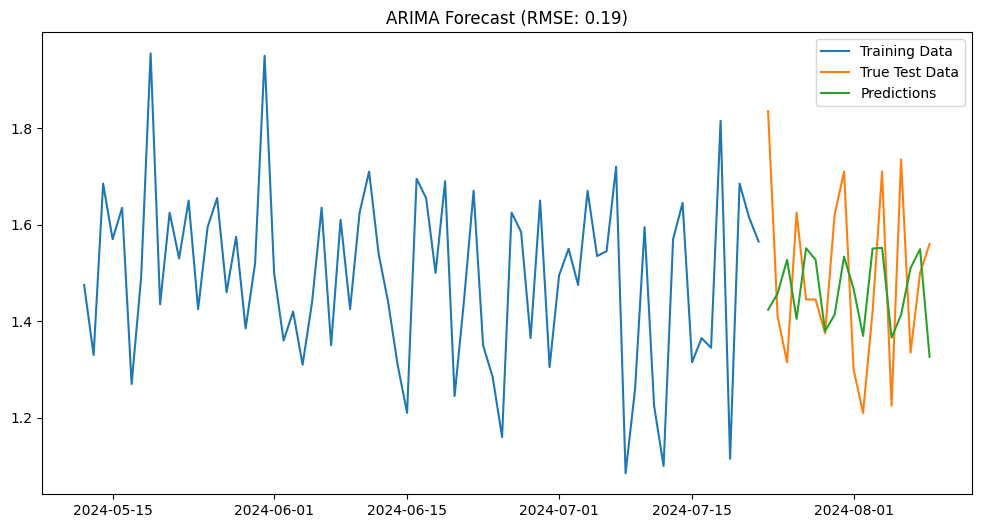

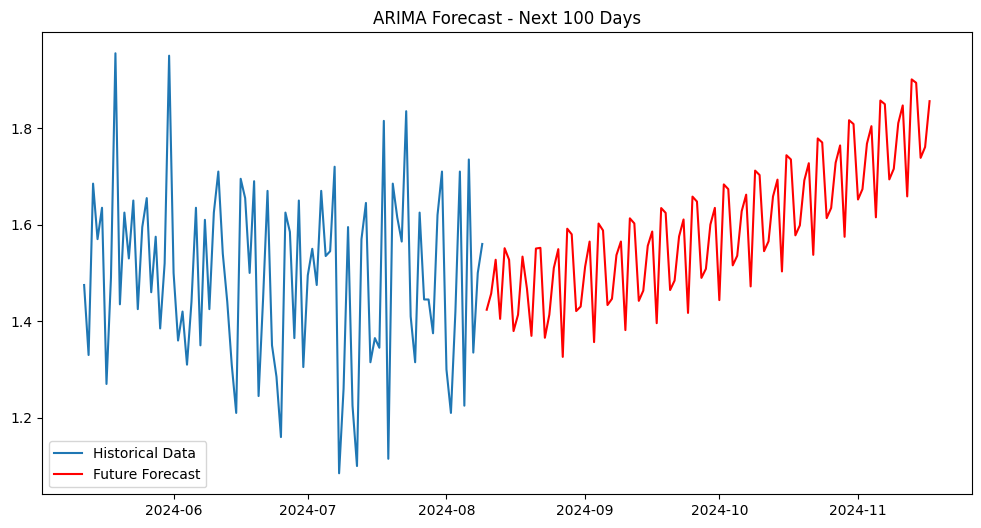


Building ARIMA model for Patient 2
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.61 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=82.698, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=33.643, Time=0.19 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.36 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=42.228, Time=0.04 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=31.582, Time=0.23 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=0.92 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=inf, Time=0.59 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=52.904, Time=0.13 sec
 ARIMA(2,1,0)(2,1,0)[7]             : AIC=23.895, Time=0.32 sec
 ARIMA(2,1,0)(1,1,0)[7]             : AIC=26.046, Time=0.11 sec
 ARIMA(2,1,0)(2,1,1)[7]             : AIC=inf, Time=0.88 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=inf, Time=0.68 sec
 ARIMA(3,1,0)(2,1,0)[7]             : AIC=12.872, Time=0.40 sec
 ARIMA(3,1,0)(1,1,0)[7]             : AIC=1

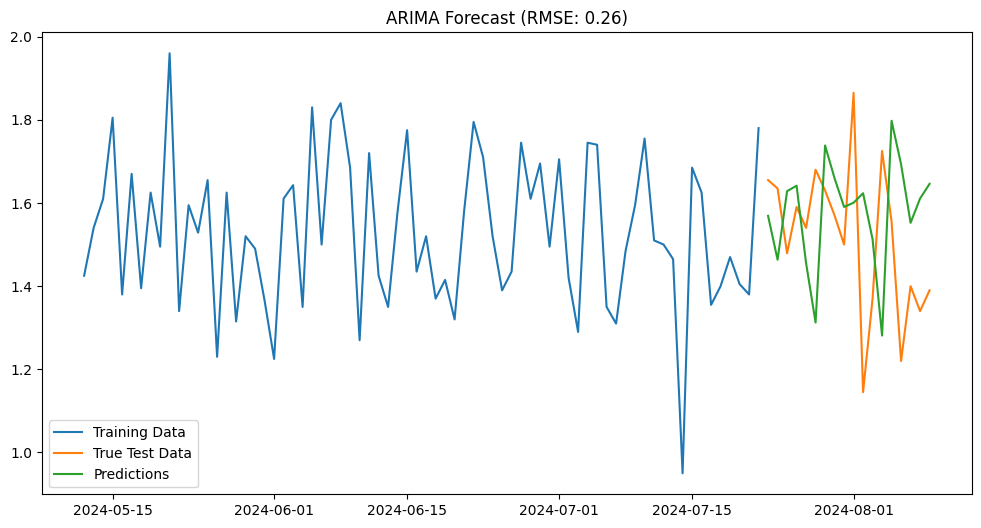

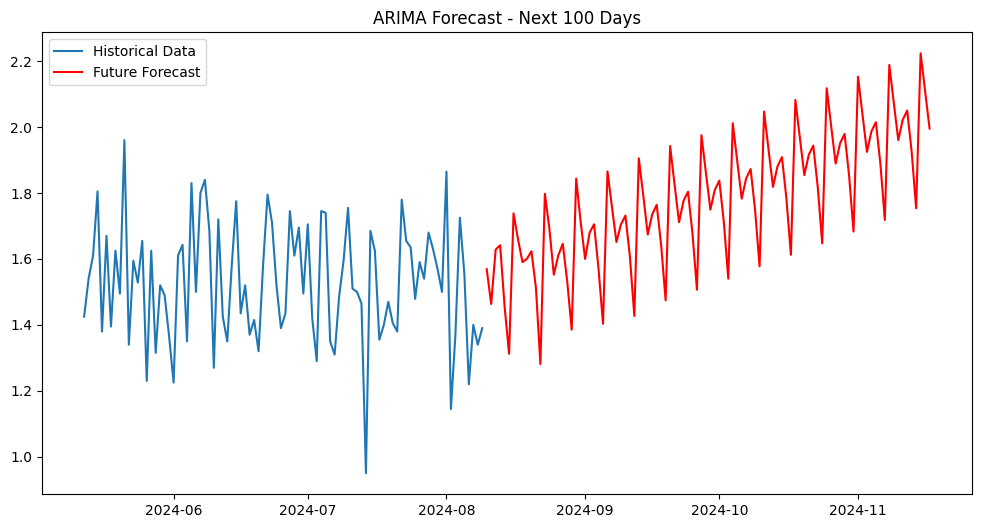


Building ARIMA model for Patient 3
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.65 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=90.617, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=47.488, Time=0.08 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.36 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=68.292, Time=0.05 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=26.782, Time=0.35 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=1.24 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=inf, Time=0.50 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=48.628, Time=0.11 sec
 ARIMA(2,1,0)(2,1,0)[7]             : AIC=7.237, Time=0.23 sec
 ARIMA(2,1,0)(1,1,0)[7]             : AIC=23.569, Time=0.15 sec
 ARIMA(2,1,0)(2,1,1)[7]             : AIC=inf, Time=1.01 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=inf, Time=5.82 sec
 ARIMA(3,1,0)(2,1,0)[7]             : AIC=7.986, Time=0.30 sec
 ARIMA(2,1,1)(2,1,0)[7]             : AIC=-0.

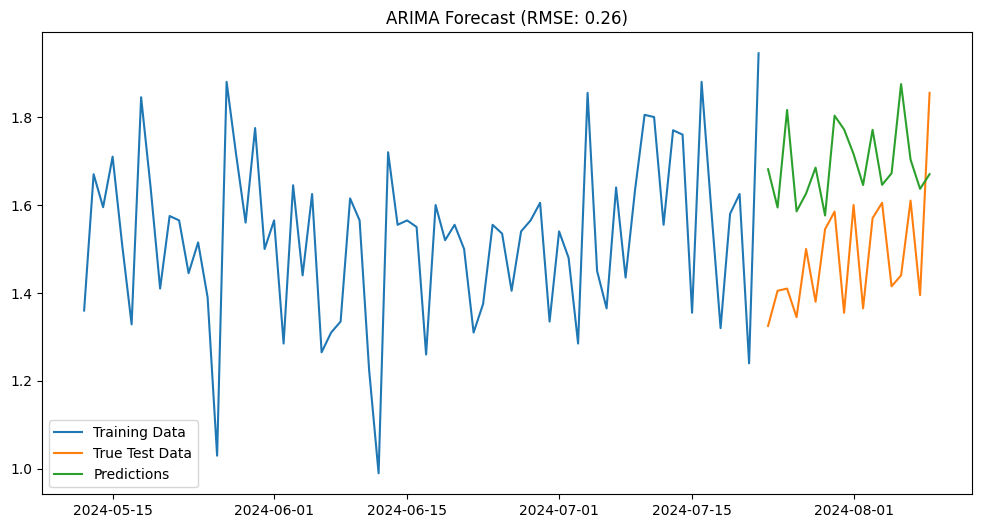

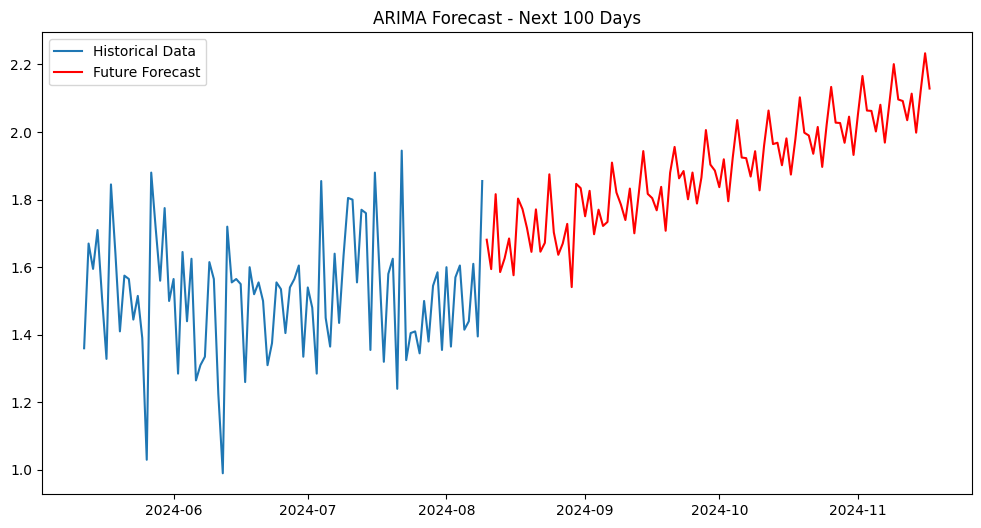


Building ARIMA model for Patient 4
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.45 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=91.638, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=38.379, Time=0.10 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.25 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=68.031, Time=0.04 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=32.349, Time=0.21 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=0.90 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=inf, Time=0.49 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=52.270, Time=0.13 sec
 ARIMA(2,1,0)(2,1,0)[7]             : AIC=28.475, Time=0.23 sec
 ARIMA(2,1,0)(1,1,0)[7]             : AIC=33.810, Time=0.13 sec
 ARIMA(2,1,0)(2,1,1)[7]             : AIC=inf, Time=0.93 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=inf, Time=0.67 sec
 ARIMA(3,1,0)(2,1,0)[7]             : AIC=18.333, Time=0.36 sec
 ARIMA(3,1,0)(1,1,0)[7]             : AIC=2

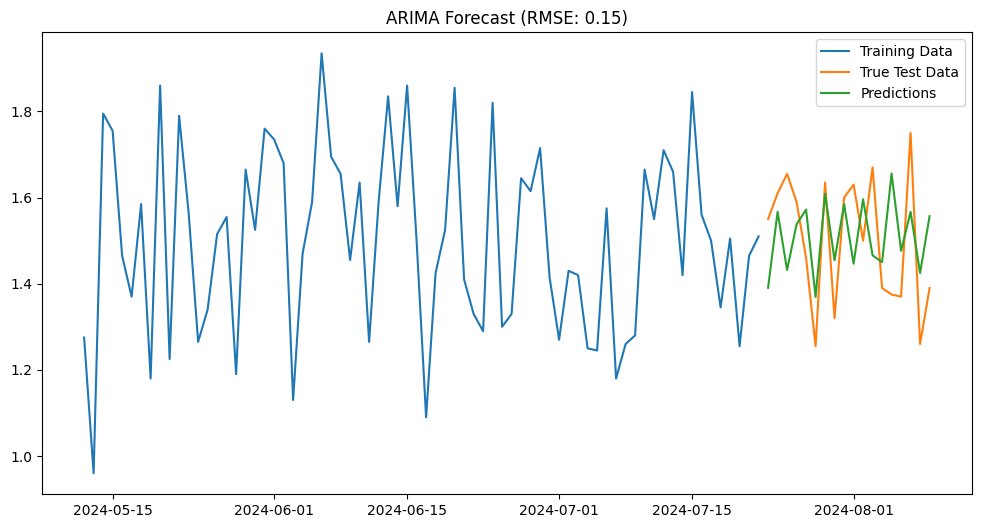

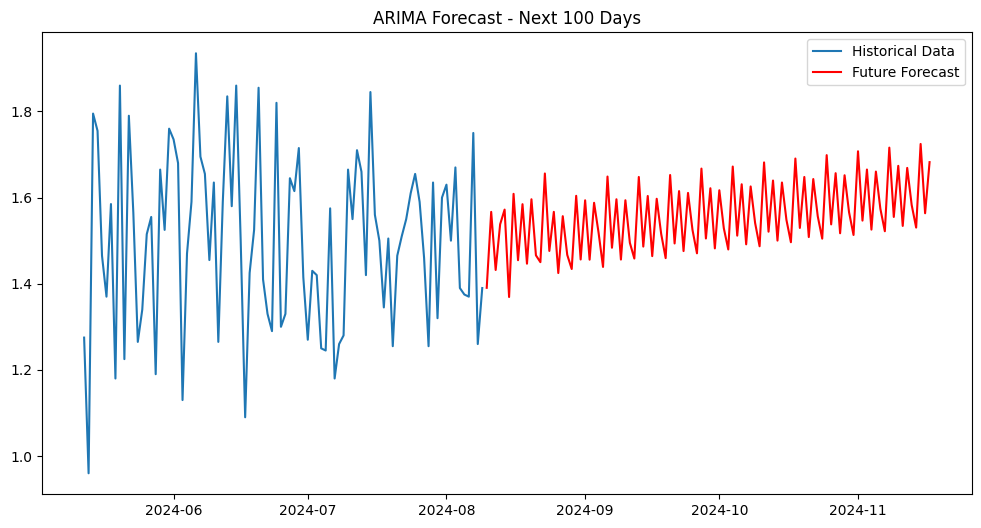


Building ARIMA model for Patient 5
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=-12.965, Time=1.51 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=49.891, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=27.058, Time=0.16 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=-14.936, Time=0.26 sec
 ARIMA(0,1,1)(0,1,0)[7]             : AIC=inf, Time=0.16 sec
 ARIMA(0,1,1)(1,1,1)[7]             : AIC=inf, Time=0.47 sec
 ARIMA(0,1,1)(0,1,2)[7]             : AIC=inf, Time=0.58 sec
 ARIMA(0,1,1)(1,1,0)[7]             : AIC=-1.808, Time=0.28 sec
 ARIMA(0,1,1)(1,1,2)[7]             : AIC=inf, Time=0.92 sec
 ARIMA(0,1,0)(0,1,1)[7]             : AIC=31.084, Time=0.11 sec
 ARIMA(0,1,2)(0,1,1)[7]             : AIC=-12.980, Time=0.33 sec
 ARIMA(1,1,0)(0,1,1)[7]             : AIC=15.259, Time=0.16 sec
 ARIMA(1,1,2)(0,1,1)[7]             : AIC=-11.041, Time=0.40 sec
 ARIMA(0,1,1)(0,1,1)[7] intercept   : AIC=inf, Time=0.47 sec

Best model:  ARIMA(0,1,1)(0,1,1)[7]

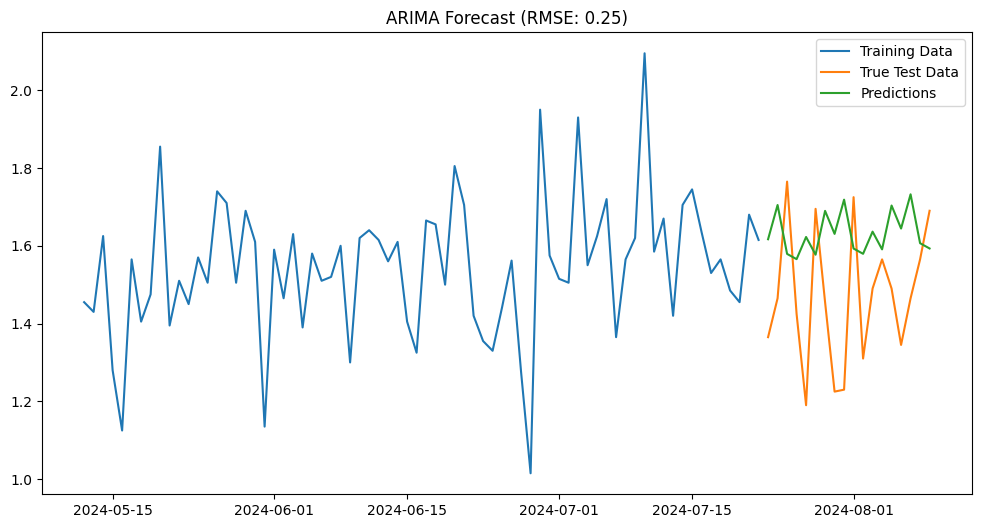

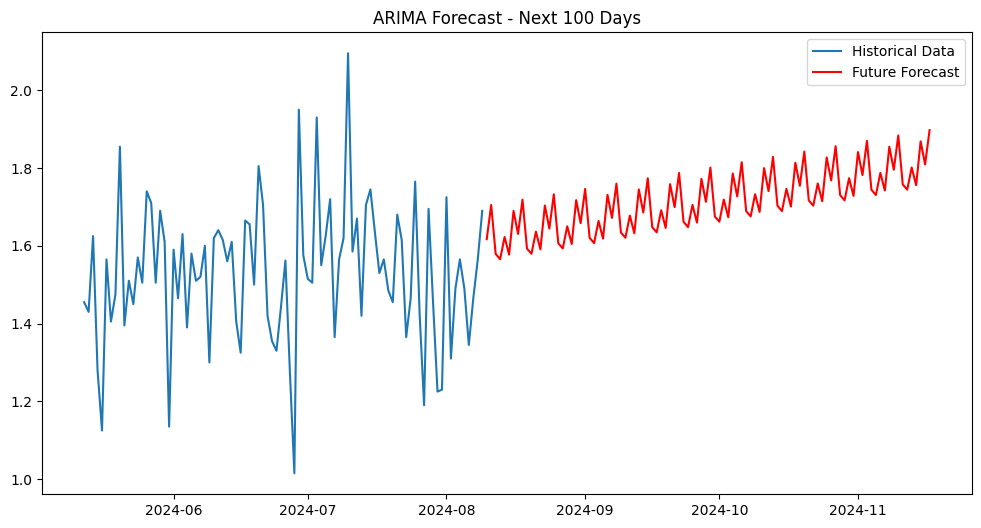


Building ARIMA model for Patient 6
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.72 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=72.366, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=39.534, Time=0.09 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.35 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=55.771, Time=0.04 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=27.819, Time=0.26 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=1.10 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=inf, Time=0.58 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=54.690, Time=0.12 sec
 ARIMA(2,1,0)(2,1,0)[7]             : AIC=16.926, Time=0.28 sec
 ARIMA(2,1,0)(1,1,0)[7]             : AIC=31.196, Time=0.13 sec
 ARIMA(2,1,0)(2,1,1)[7]             : AIC=12.561, Time=0.77 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=inf, Time=2.45 sec
 ARIMA(2,1,0)(2,1,2)[7]             : AIC=11.207, Time=3.11 sec
 ARIMA(2,1,0)(1,1,2)[7]             : AI

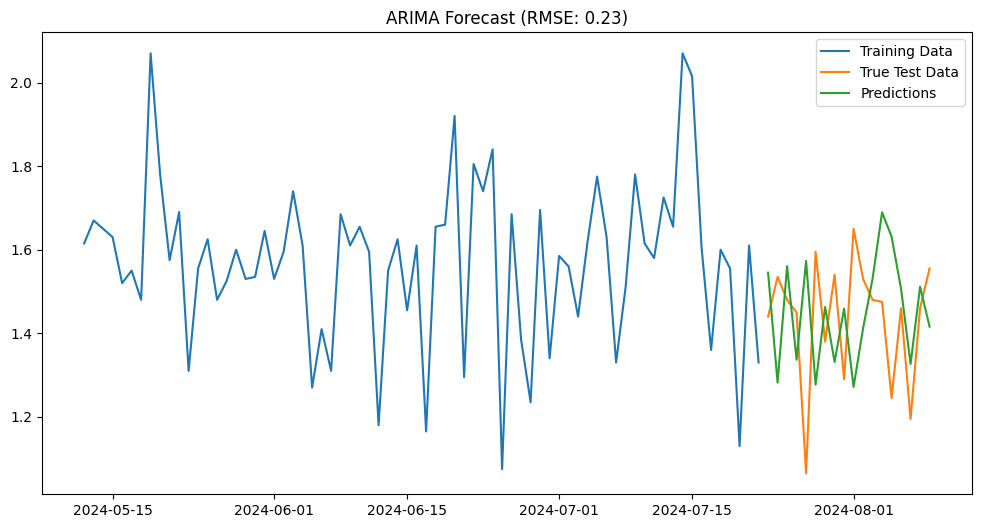

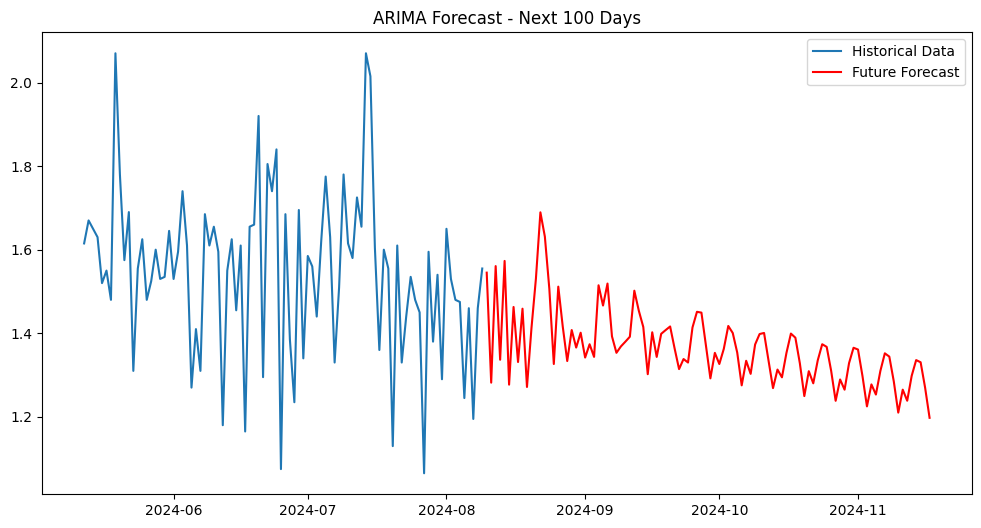


Building ARIMA model for Patient 7
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.43 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=80.883, Time=0.10 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=33.416, Time=0.08 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=-11.172, Time=0.32 sec
 ARIMA(0,1,1)(0,1,0)[7]             : AIC=inf, Time=0.12 sec
 ARIMA(0,1,1)(1,1,1)[7]             : AIC=-10.341, Time=0.28 sec
 ARIMA(0,1,1)(0,1,2)[7]             : AIC=-10.021, Time=0.40 sec
 ARIMA(0,1,1)(1,1,0)[7]             : AIC=-1.385, Time=0.18 sec
 ARIMA(0,1,1)(1,1,2)[7]             : AIC=inf, Time=0.99 sec
 ARIMA(0,1,0)(0,1,1)[7]             : AIC=inf, Time=0.30 sec
 ARIMA(0,1,2)(0,1,1)[7]             : AIC=inf, Time=0.44 sec
 ARIMA(1,1,0)(0,1,1)[7]             : AIC=inf, Time=0.37 sec
 ARIMA(1,1,2)(0,1,1)[7]             : AIC=inf, Time=0.96 sec
 ARIMA(0,1,1)(0,1,1)[7] intercept   : AIC=inf, Time=2.67 sec

Best model:  ARIMA(0,1,1)(0,1,1)[7]          

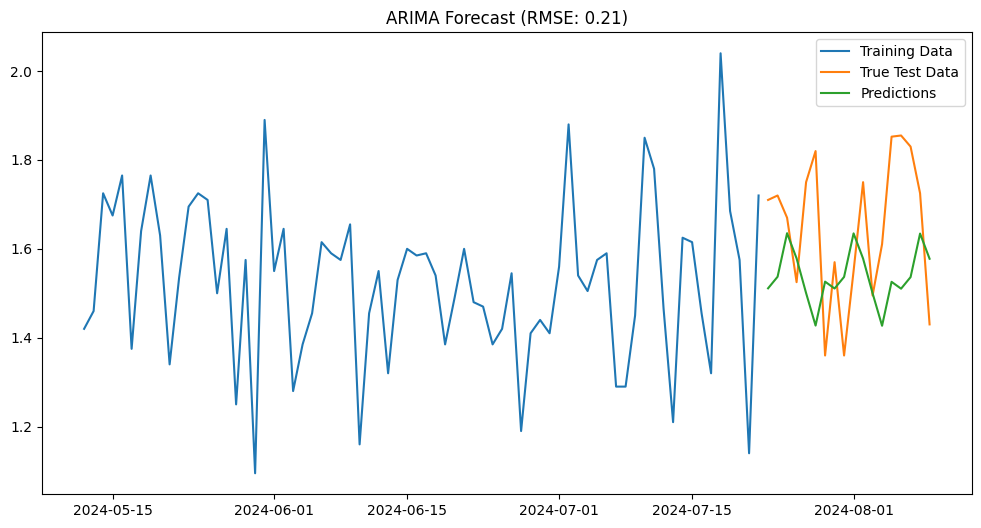

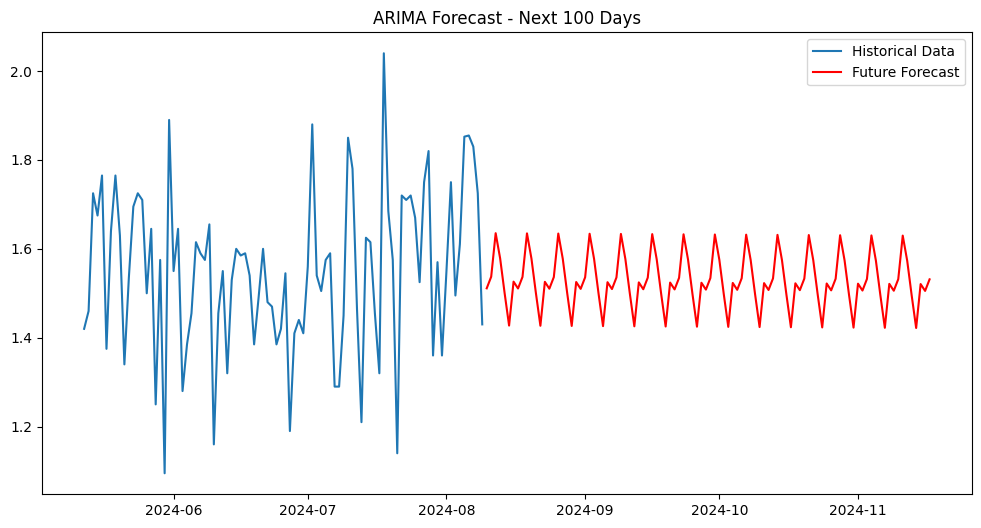


Building ARIMA model for Patient 8
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=1.31 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=93.497, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=39.806, Time=0.08 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.27 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=55.386, Time=0.04 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=26.185, Time=0.25 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=0.90 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=inf, Time=0.37 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=71.348, Time=0.25 sec
 ARIMA(2,1,0)(2,1,0)[7]             : AIC=14.865, Time=0.28 sec
 ARIMA(2,1,0)(1,1,0)[7]             : AIC=24.252, Time=0.15 sec
 ARIMA(2,1,0)(2,1,1)[7]             : AIC=6.829, Time=0.75 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=inf, Time=0.99 sec
 ARIMA(2,1,0)(2,1,2)[7]             : AIC=inf, Time=1.29 sec
 ARIMA(2,1,0)(1,1,2)[7]             : AIC=in

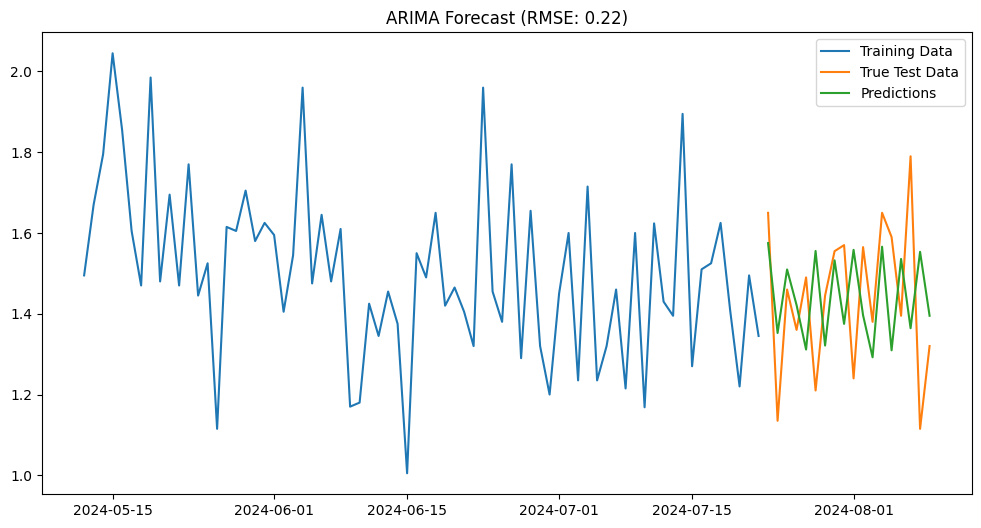

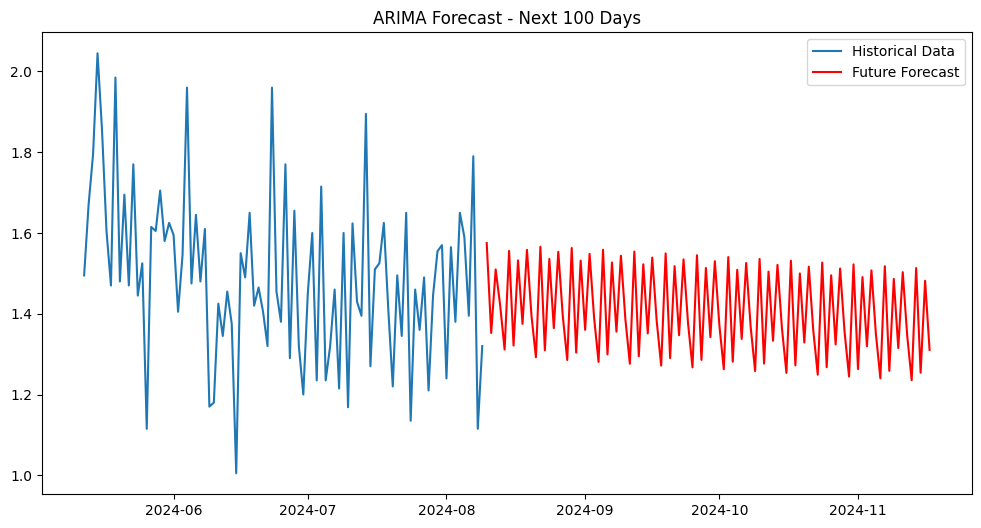


Building ARIMA model for Patient 9
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.82 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=77.689, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=34.834, Time=0.11 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.35 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=56.513, Time=0.04 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=31.009, Time=0.25 sec
 ARIMA(1,1,0)(2,1,1)[7]             : AIC=inf, Time=1.33 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=24.499, Time=0.26 sec
 ARIMA(1,1,0)(0,1,1)[7]             : AIC=22.545, Time=0.24 sec
 ARIMA(1,1,0)(0,1,2)[7]             : AIC=24.508, Time=0.44 sec
 ARIMA(1,1,0)(1,1,2)[7]             : AIC=inf, Time=1.26 sec
 ARIMA(0,1,0)(0,1,1)[7]             : AIC=47.080, Time=0.10 sec
 ARIMA(2,1,0)(0,1,1)[7]             : AIC=inf, Time=0.40 sec
 ARIMA(2,1,1)(0,1,1)[7]             : AIC=-2.336, Time=0.78 sec
 ARIMA(2,1,1)(0,1,0)[7]             : AI

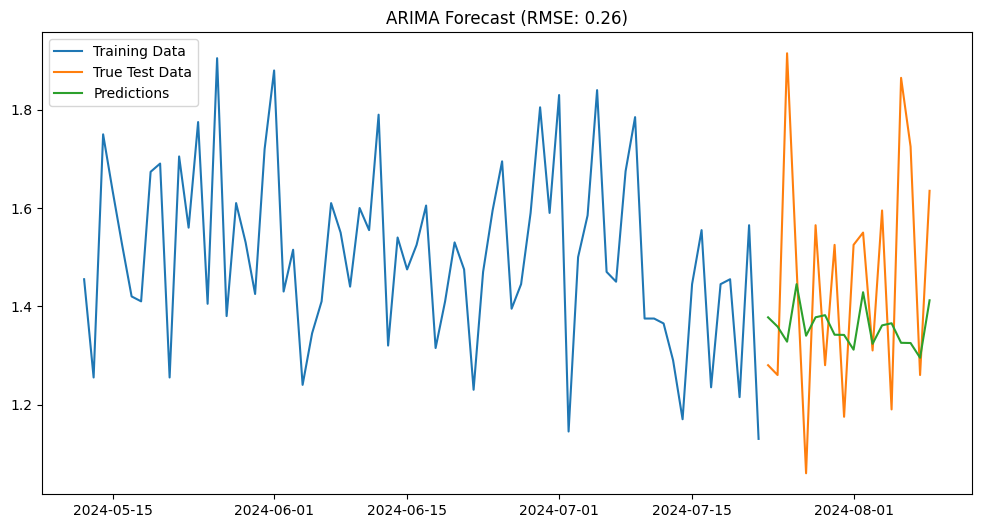

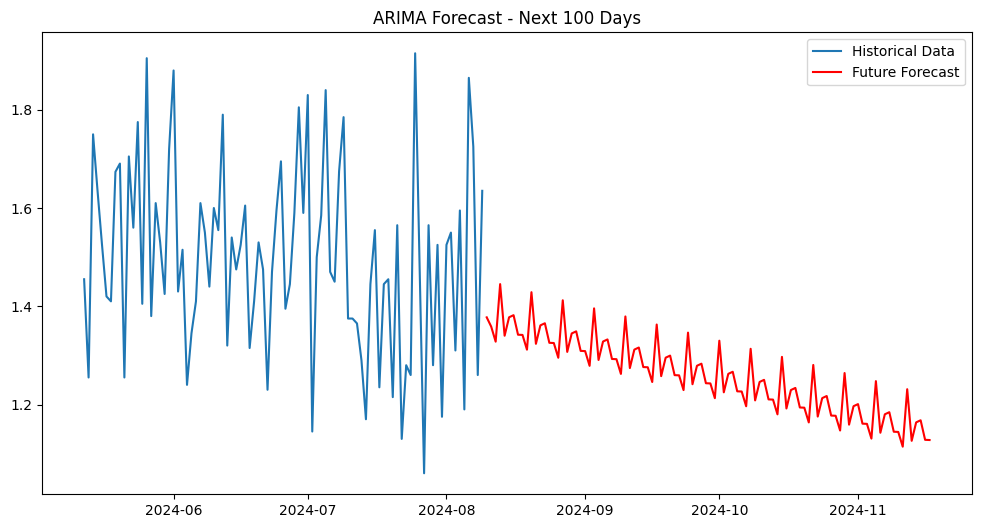


Building ARIMA model for Patient 10
Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[7]             : AIC=inf, Time=0.81 sec
 ARIMA(0,1,0)(0,1,0)[7]             : AIC=72.874, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[7]             : AIC=35.307, Time=0.12 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.46 sec
 ARIMA(1,1,0)(0,1,0)[7]             : AIC=58.394, Time=0.04 sec
 ARIMA(1,1,0)(2,1,0)[7]             : AIC=35.873, Time=0.30 sec
 ARIMA(1,1,0)(1,1,1)[7]             : AIC=34.069, Time=0.19 sec
 ARIMA(1,1,0)(0,1,1)[7]             : AIC=32.369, Time=0.15 sec
 ARIMA(1,1,0)(0,1,2)[7]             : AIC=34.260, Time=0.29 sec
 ARIMA(1,1,0)(1,1,2)[7]             : AIC=34.846, Time=0.49 sec
 ARIMA(0,1,0)(0,1,1)[7]             : AIC=51.799, Time=0.10 sec
 ARIMA(2,1,0)(0,1,1)[7]             : AIC=20.035, Time=0.45 sec
 ARIMA(2,1,0)(0,1,0)[7]             : AIC=45.347, Time=0.05 sec
 ARIMA(2,1,0)(1,1,1)[7]             : AIC=21.930, Time=0.45 sec
 ARIMA(2,1,0)(0,1,2)[7]       

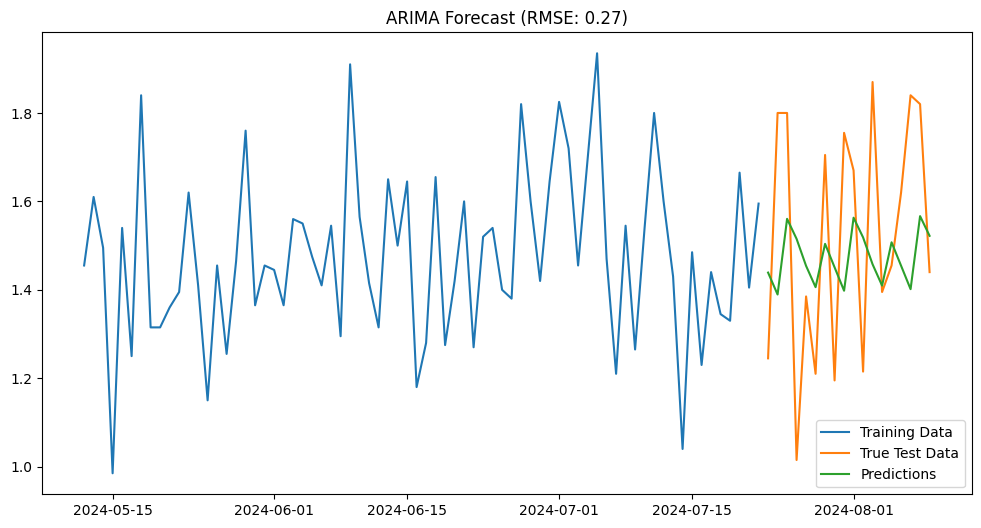

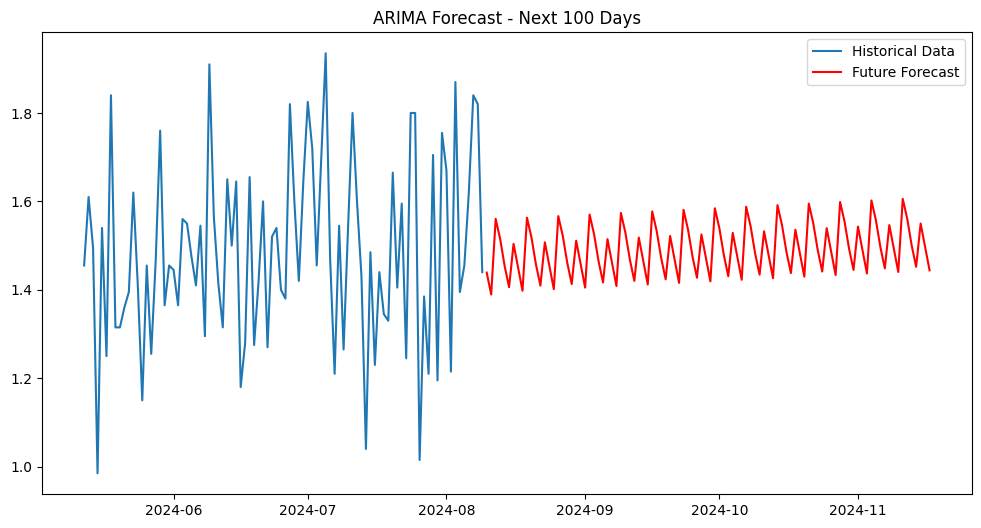

In [ ]:
# Build ARIMA models for each patient
arima_models = {}
for patient in df_resampled['Patient ID'].unique():
    print(f"\nBuilding ARIMA model for Patient {patient}")
    patient_data = df_resampled[df_resampled['Patient ID'] == patient].set_index('Timestamp')['Clinical Dementia Rating']
    model, rmse, future_forecast, future_dates = build_arima_model(patient_data)
    arima_models[patient] = {
        'model': model,
        'rmse': rmse,
        'future_forecast': future_forecast,
        'future_dates': future_dates
    }

In [ ]:
# Print summary of all models and future forecasts
for patient, model_info in arima_models.items():
    print(f"\nPatient {patient}:")
    print(f"Best ARIMA order: {model_info['model'].order}")
    print(f"RMSE: {model_info['rmse']:.2f}")
    print("Future forecast (next 100 days):")
    future_df = pd.DataFrame({
        'Date': model_info['future_dates'],
        'Forecast': model_info['future_forecast']
    })
    print(future_df.head())  # Print first 5 days of forecast
    print("...")
    print(future_df.tail())  # Print last 5 days of forecast


Patient 1:
Best ARIMA order: (4, 1, 1)
RMSE: 0.19
Future forecast (next 100 days):
                 Date  Forecast
2024-07-23 2024-08-10  1.423777
2024-07-24 2024-08-11  1.457308
2024-07-25 2024-08-12  1.527304
2024-07-26 2024-08-13  1.404820
2024-07-27 2024-08-14  1.551218
...
                 Date  Forecast
2024-10-26 2024-11-13  1.900918
2024-10-27 2024-11-14  1.893825
2024-10-28 2024-11-15  1.738380
2024-10-29 2024-11-16  1.760803
2024-10-30 2024-11-17  1.855805

Patient 2:
Best ARIMA order: (3, 1, 0)
RMSE: 0.26
Future forecast (next 100 days):
                 Date  Forecast
2024-07-23 2024-08-10  1.568957
2024-07-24 2024-08-11  1.463433
2024-07-25 2024-08-12  1.628450
2024-07-26 2024-08-13  1.641508
2024-07-27 2024-08-14  1.455282
...
                 Date  Forecast
2024-10-26 2024-11-13  1.924344
2024-10-27 2024-11-14  1.753692
2024-10-28 2024-11-15  2.223714
2024-10-29 2024-11-16  2.109077
2024-10-30 2024-11-17  1.995517

Patient 3:
Best ARIMA order: (0, 1, 1)
RMSE: 0.26
Futur

# **Boosting Methods:**

In [ ]:
pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.2/98.2 MB 5.5 MB/s eta 0:00:00


In [ ]:
pip install dask

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from catboost import CatBoostRegressor
from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
import matplotlib.pyplot as plt

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# Assuming df_resampled is your preprocessed dataframe
df = df_resampled.copy()

In [ ]:
# Define features and target
target = 'Clinical Dementia Rating'
features = ['SPO2', 'Blood Pressure Systolic', 'Blood Pressure Diastolic', 'Temperature', 'Heart Rate']

In [ ]:
# Function to evaluate models
def evaluate_model(y_true, y_pred, model_name):
    mse = mean_squared_error(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)

    return {
        'Model': model_name,
        'MSE': mse,
        'MAE': mae,
        'RMSE': rmse,
        'R-squared': r2
    }

In [ ]:
# Function to plot results
def plot_results(y_true, y_pred, timestamps, model_name, patient_id):
    plt.figure(figsize=(12, 6))
    plt.plot(timestamps, y_true, label='Actual')
    plt.plot(timestamps, y_pred, label='Predicted')
    plt.title(f'{model_name}: Actual vs Predicted Dementia Rating for Patient {patient_id}')
    plt.xlabel('Timestamp')
    plt.ylabel('Dementia Rating')
    plt.legend()
    plt.show()

In [ ]:
# Initialize lists to store results
all_results = []
feature_importance = {model: [] for model in ['CatBoost', 'LightGBM', 'XGBoost']}

Processing Patient 1


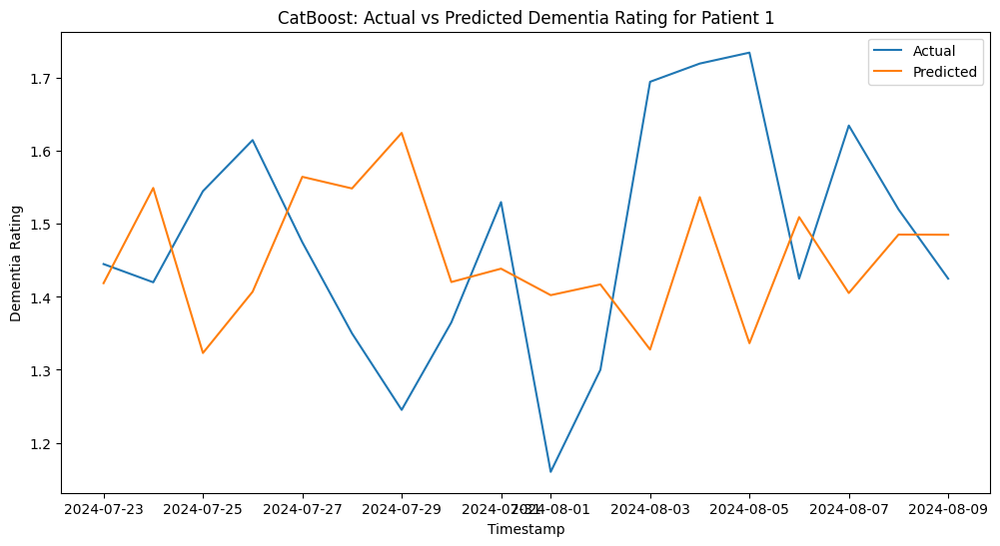

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000197 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 125
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.497014
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

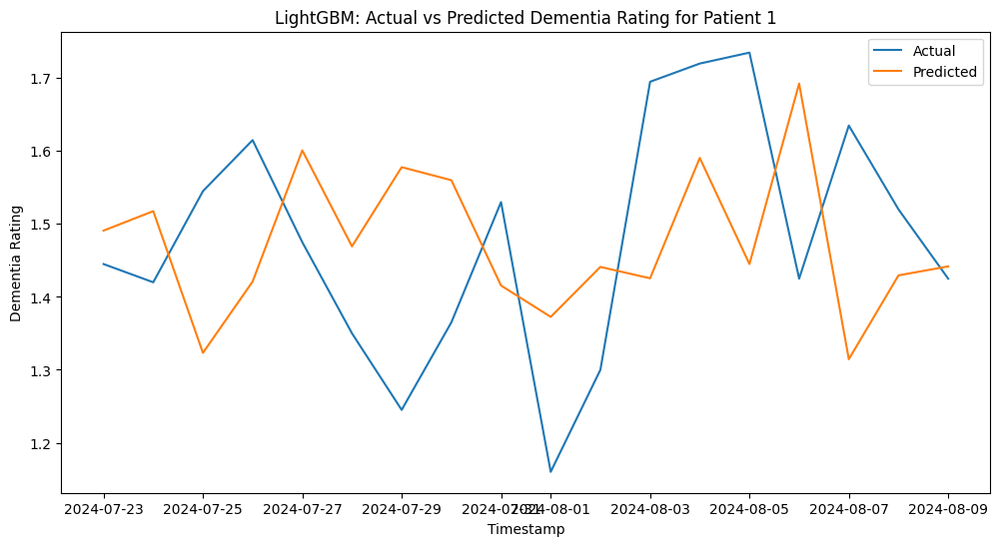

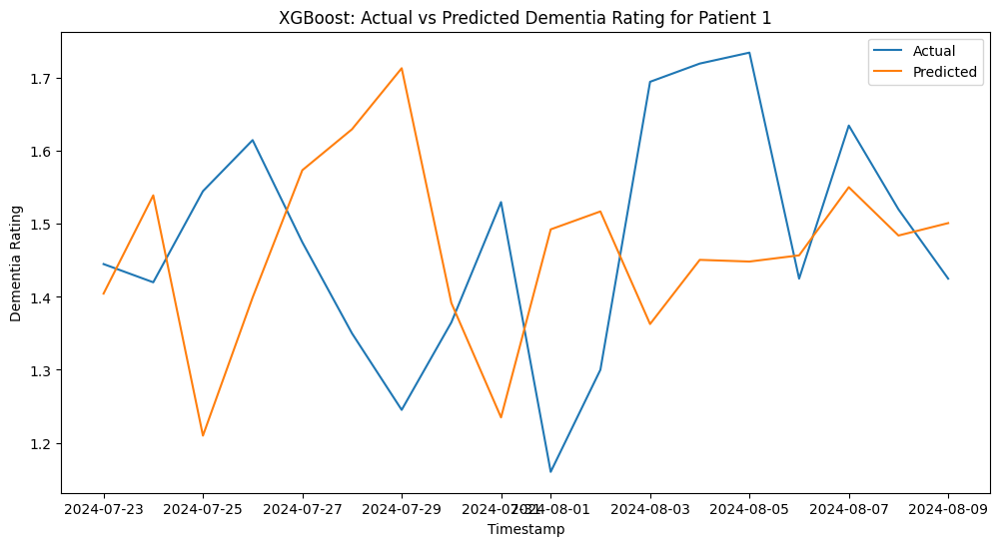

Processing Patient 2


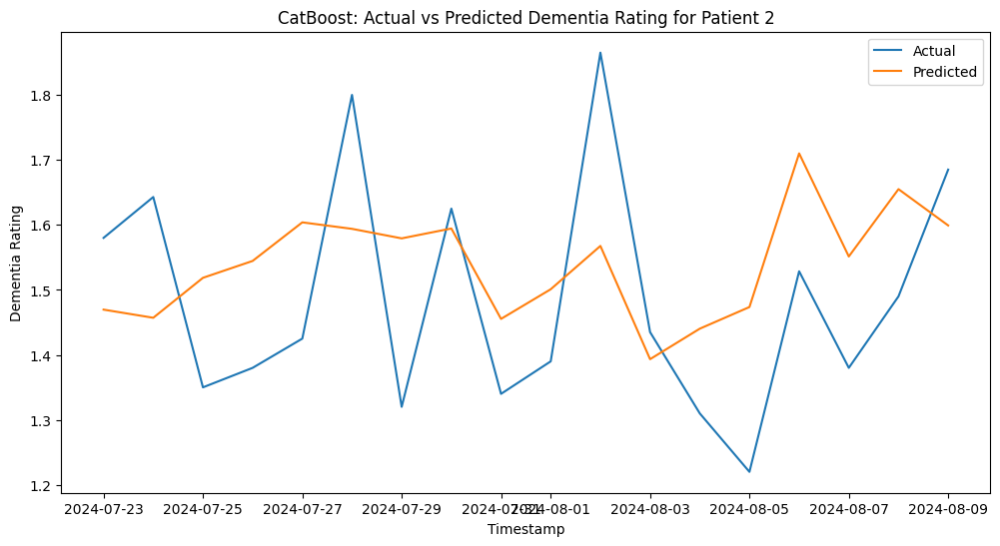

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000043 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 125
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.536801
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

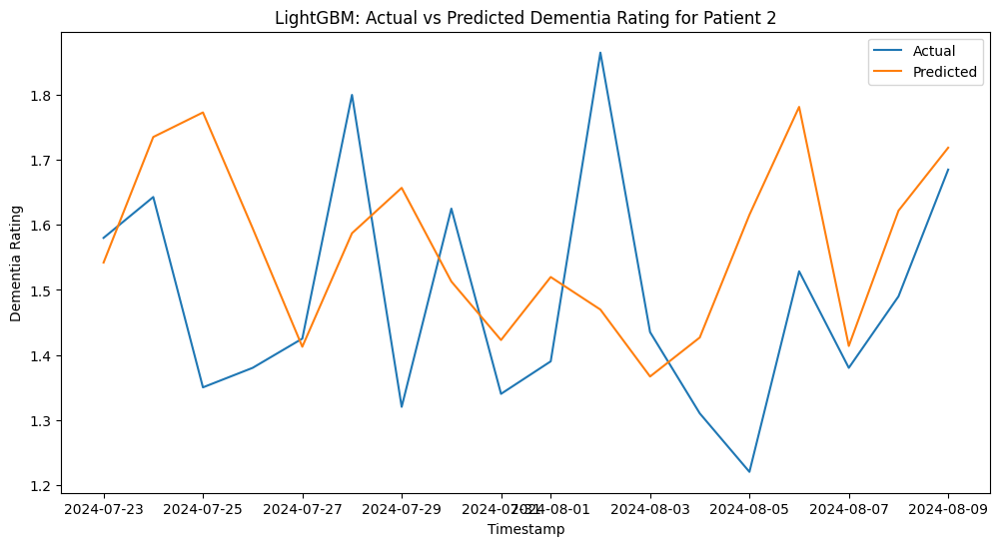

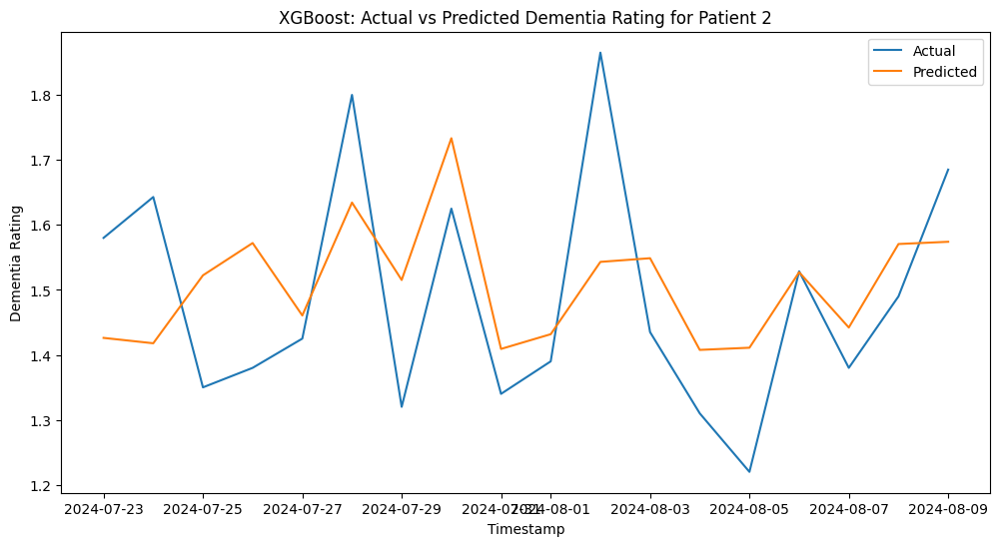

Processing Patient 3


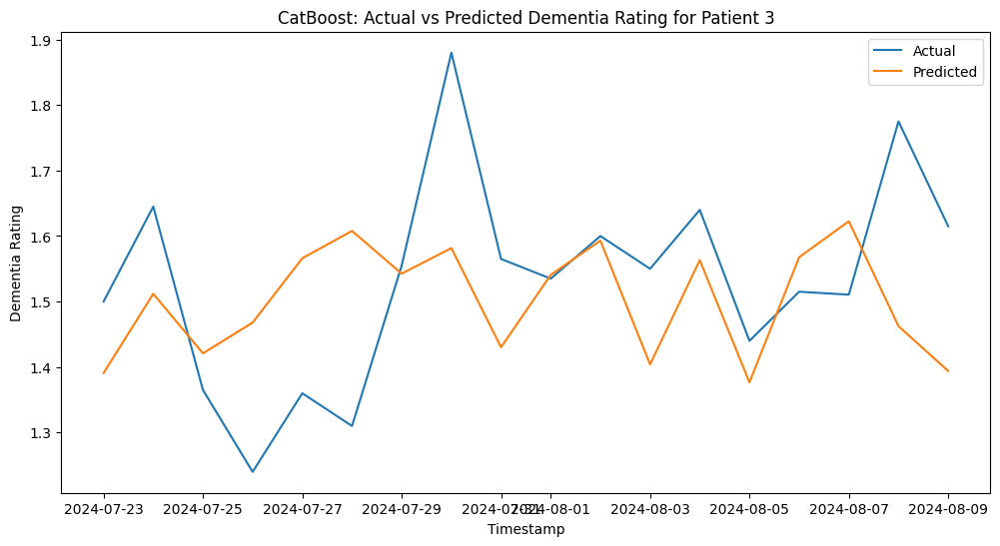

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000041 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 123
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.513244
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

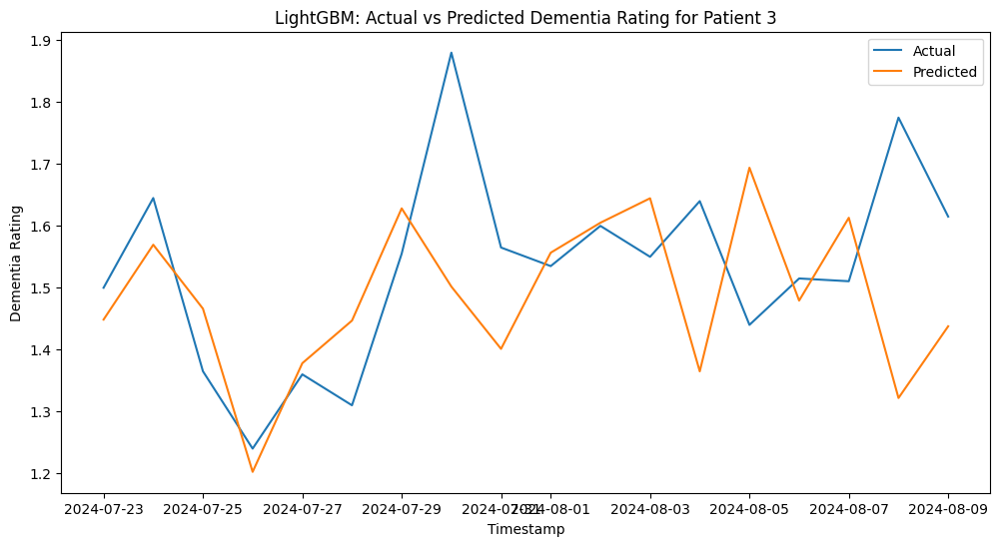

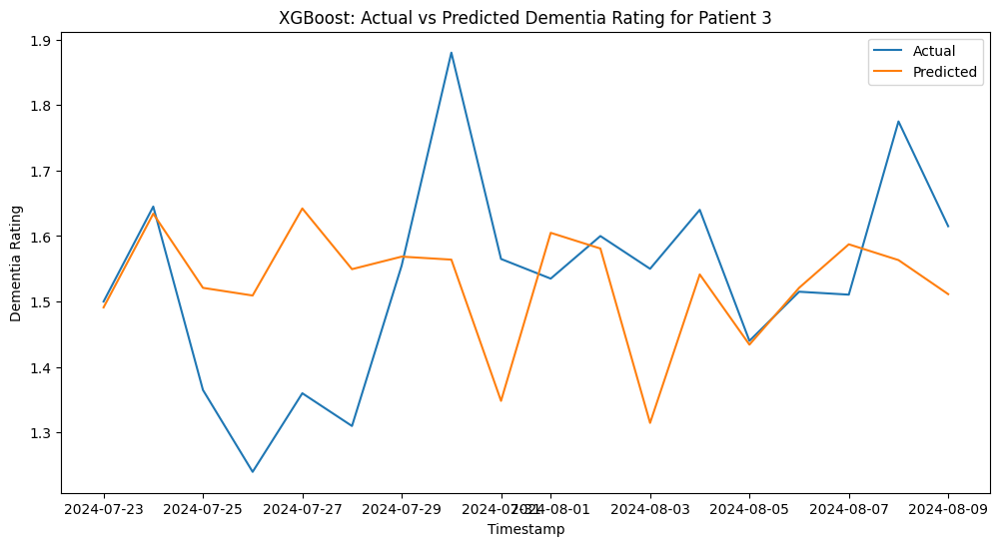

Processing Patient 4


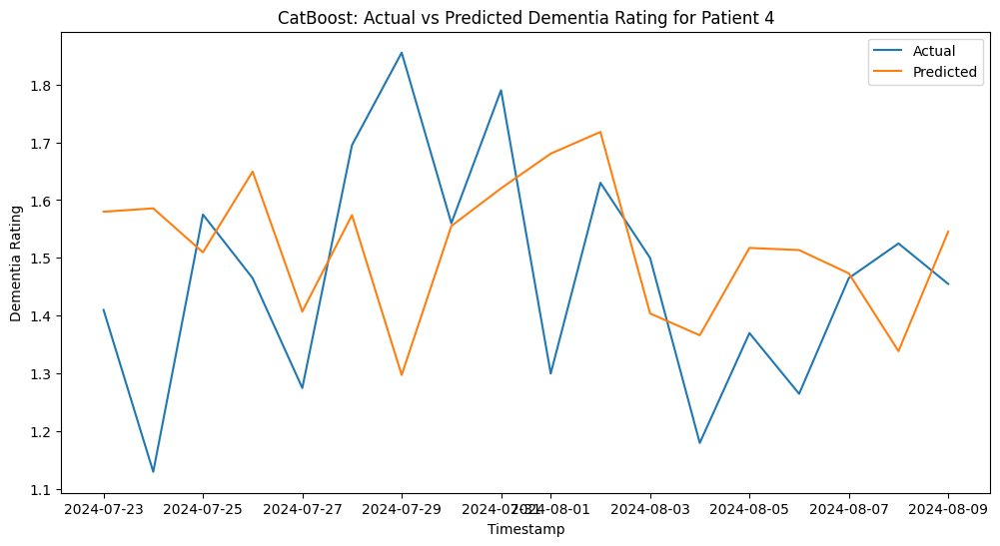

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000041 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 124
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.506667
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

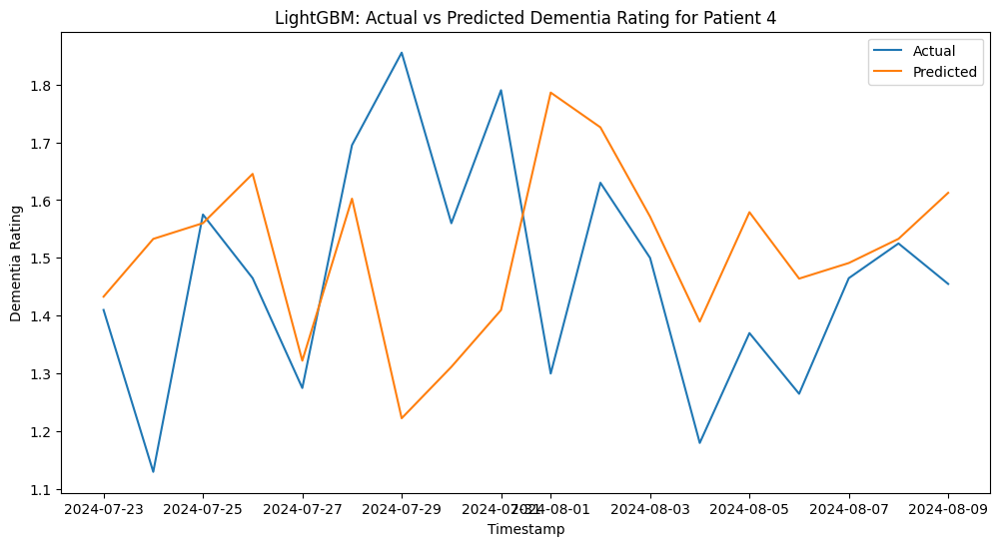

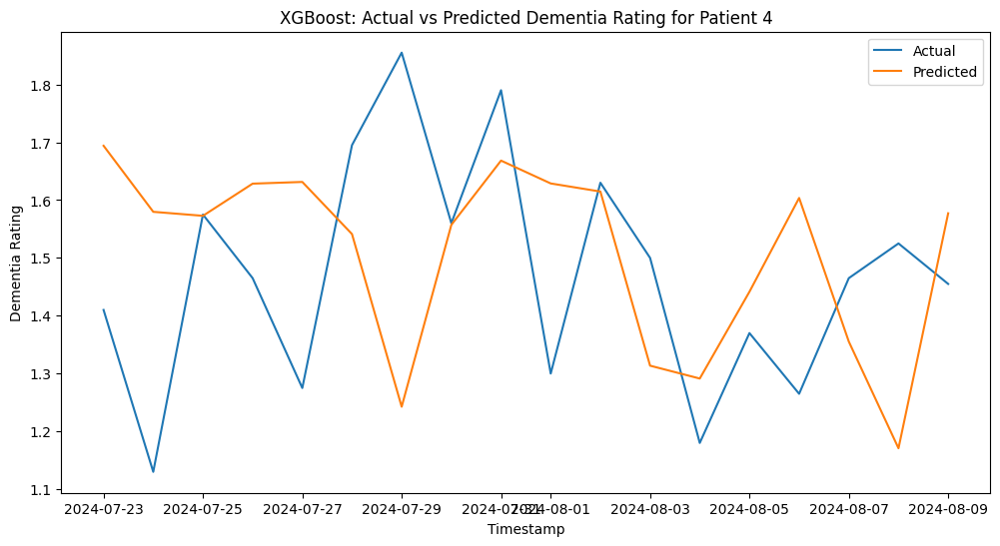

Processing Patient 5


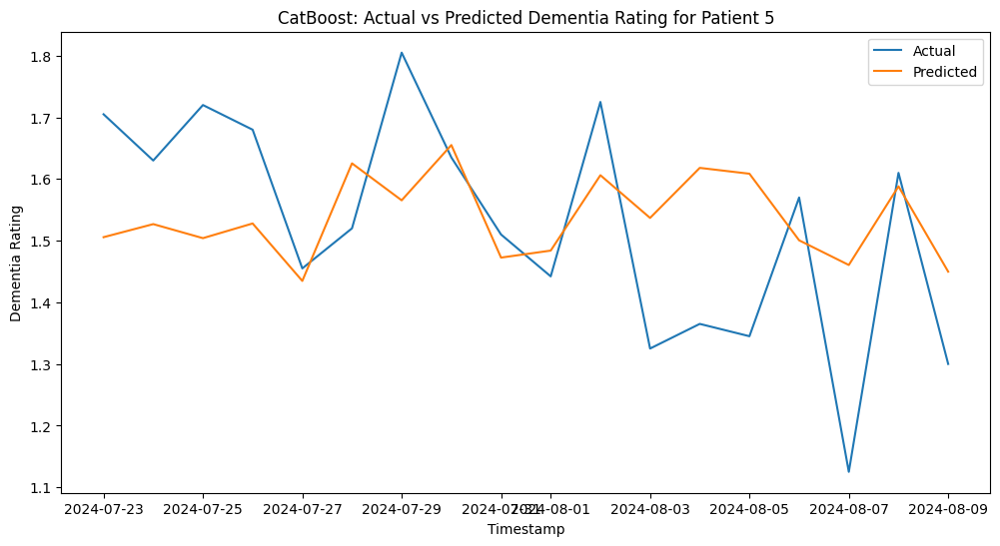

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000038 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 125
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.530860
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

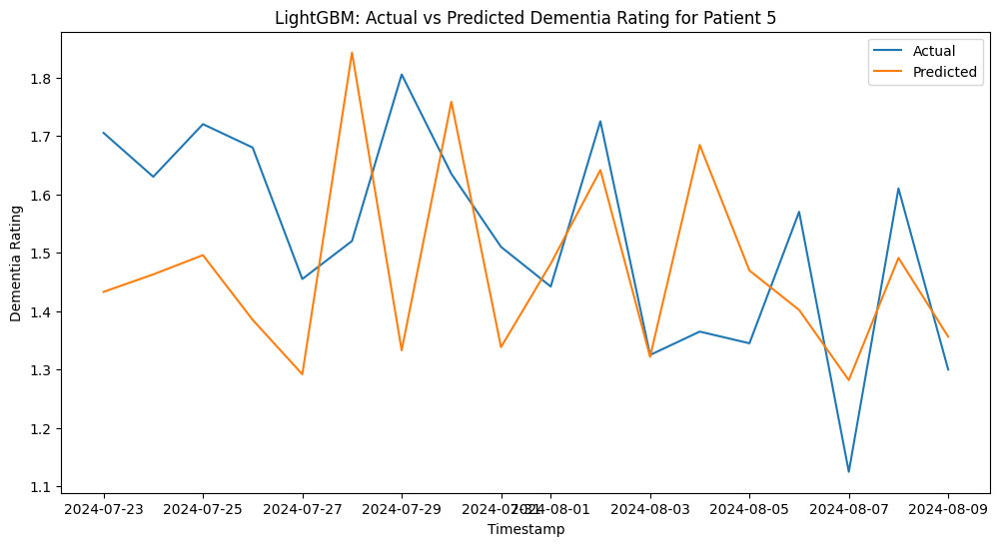

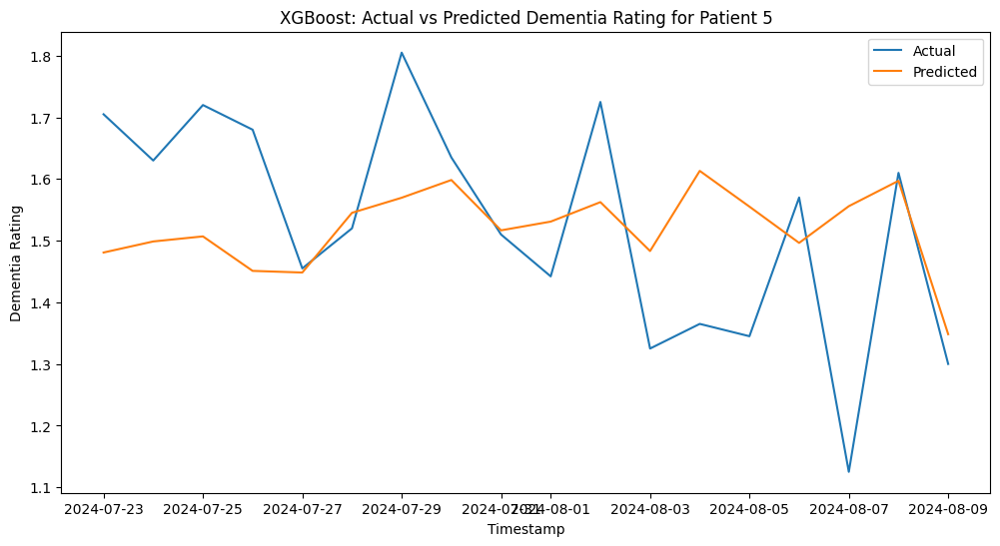

Processing Patient 6


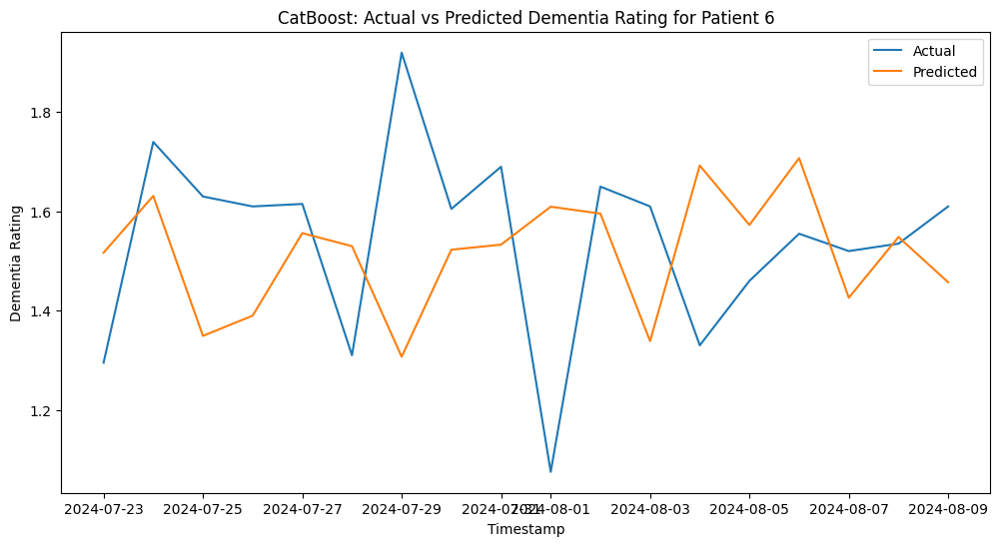

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 123
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.543125
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

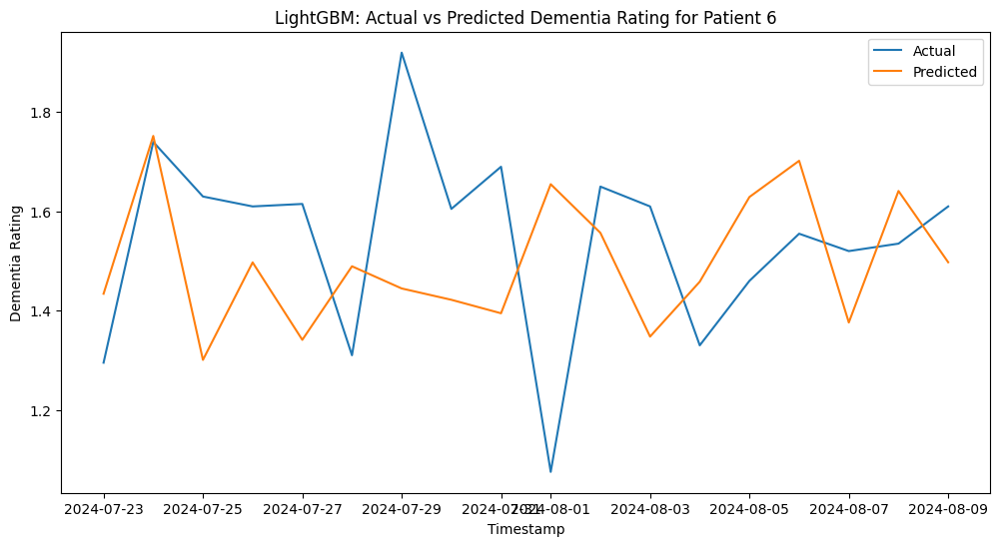

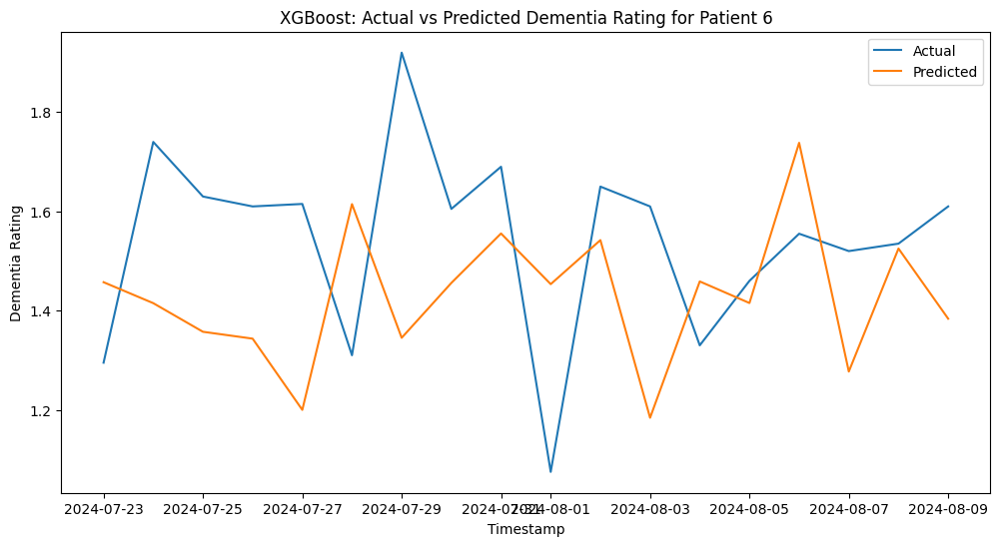

Processing Patient 7


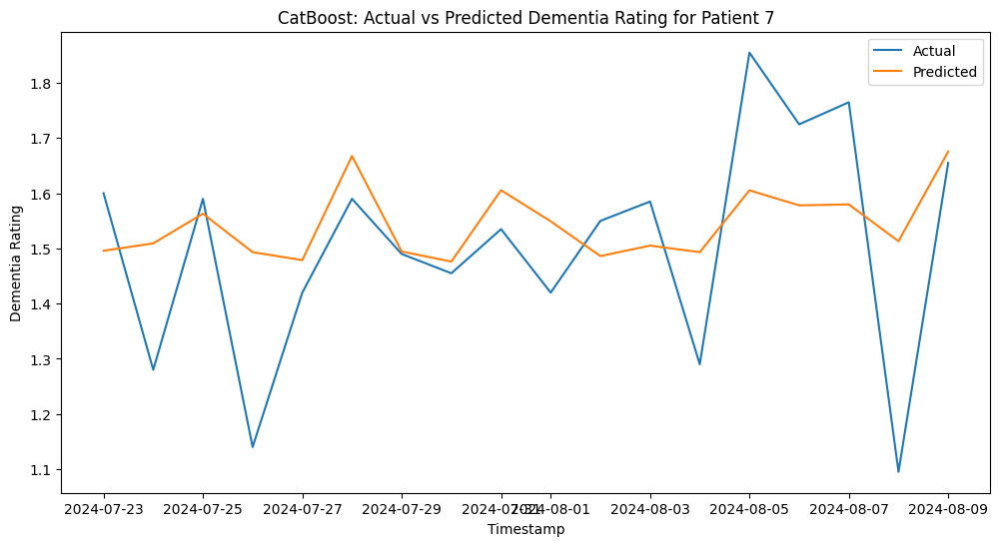

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000050 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 123
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.561429
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

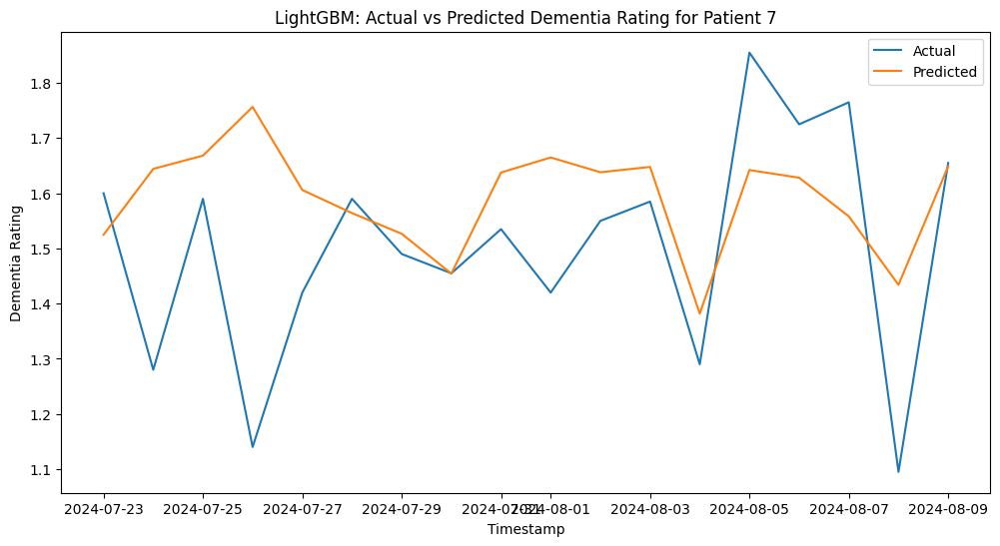

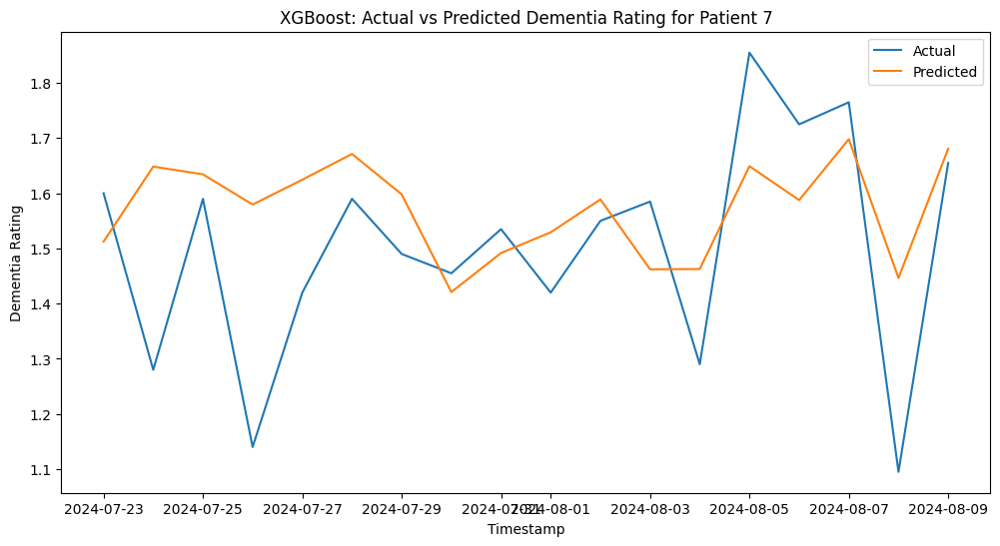

Processing Patient 8


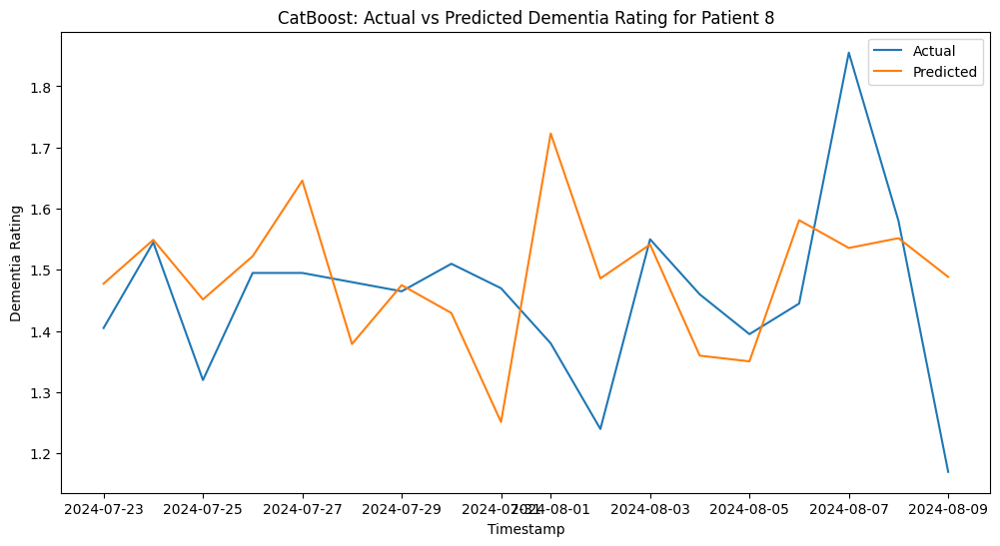

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000036 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 124
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.499337
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

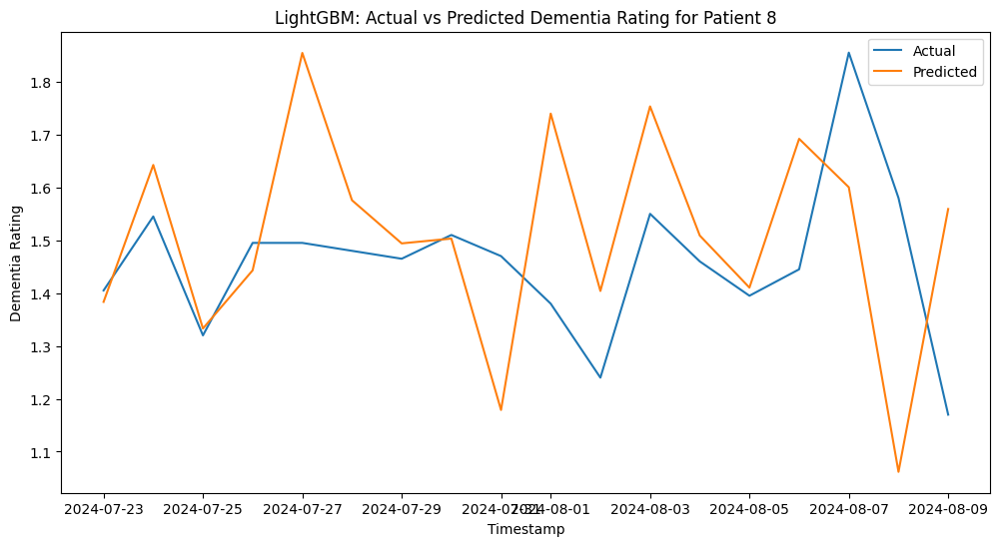

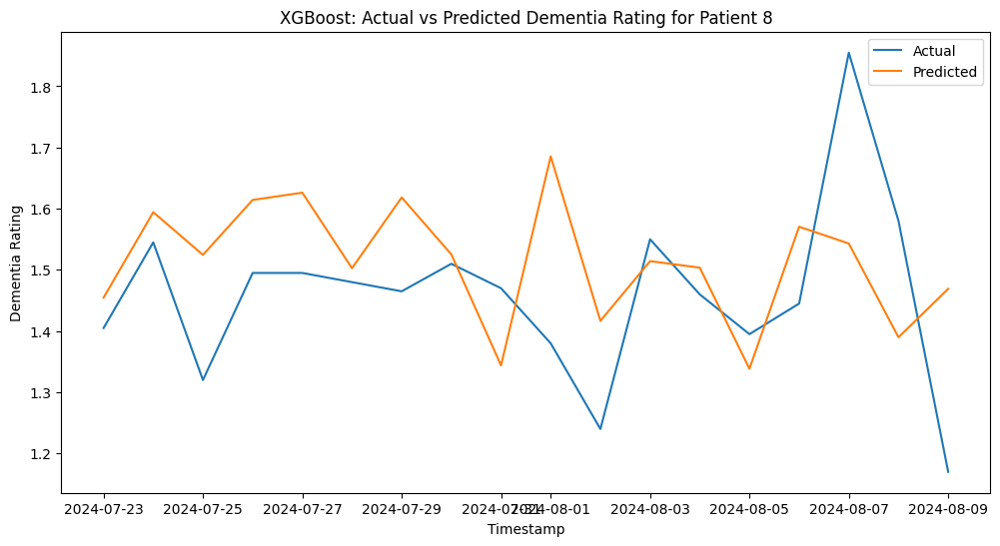

Processing Patient 9


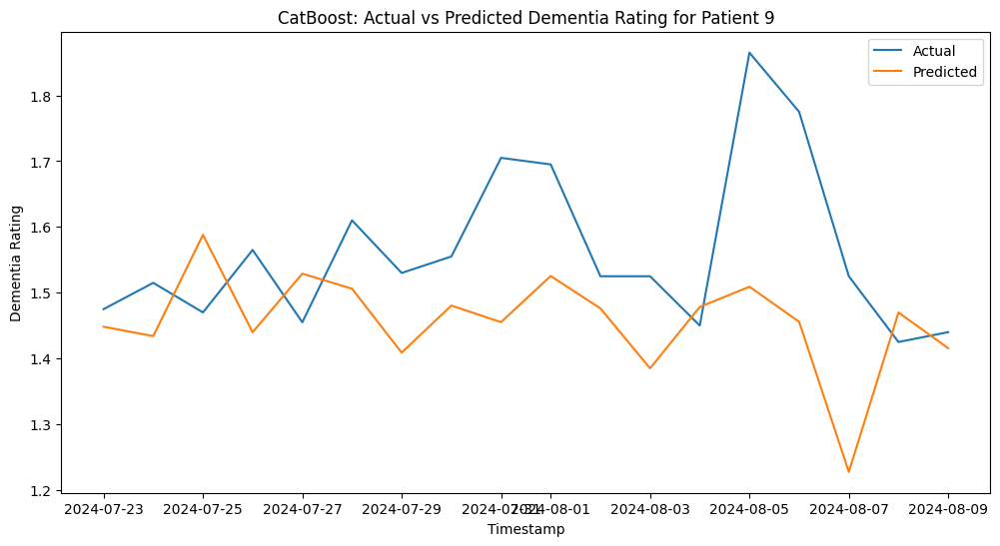

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000035 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 124
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.478461
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

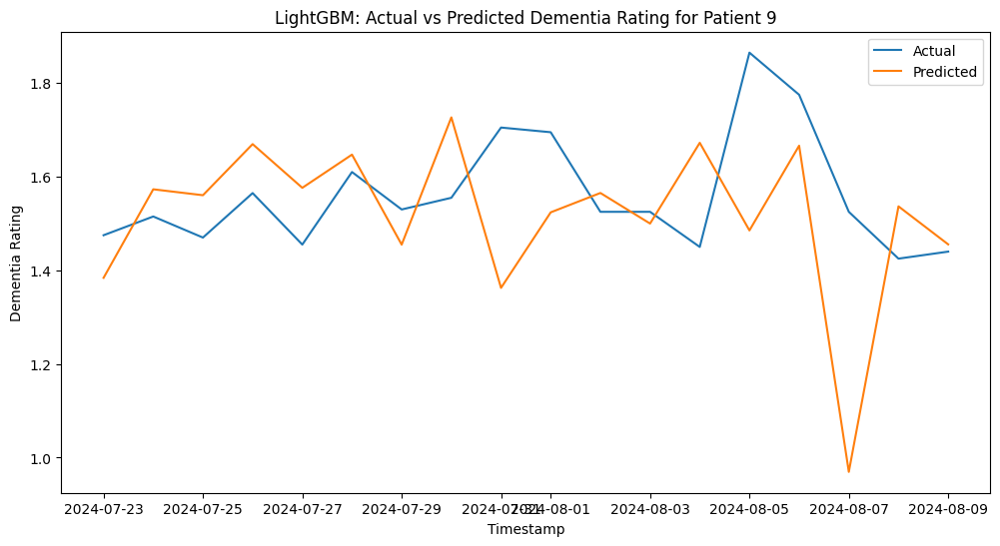

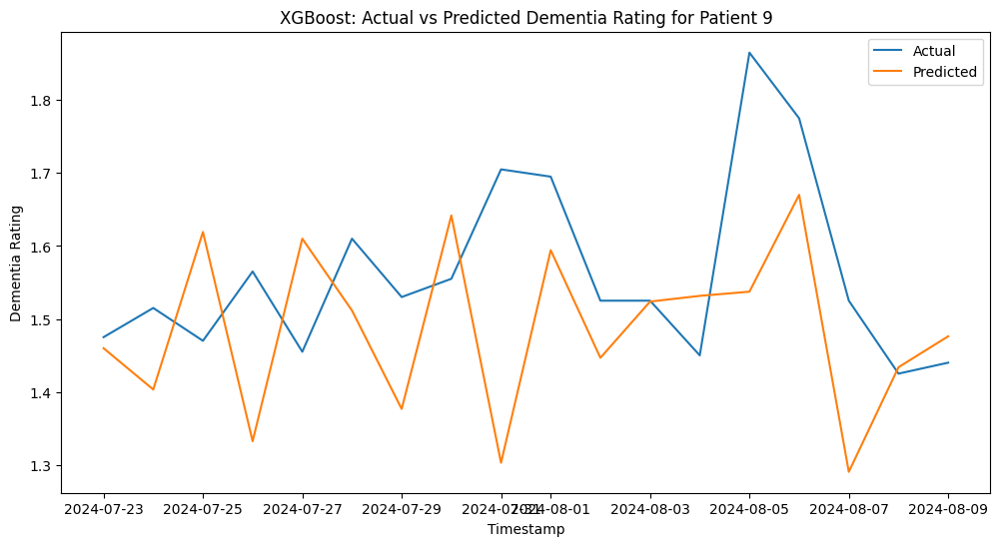

Processing Patient 10


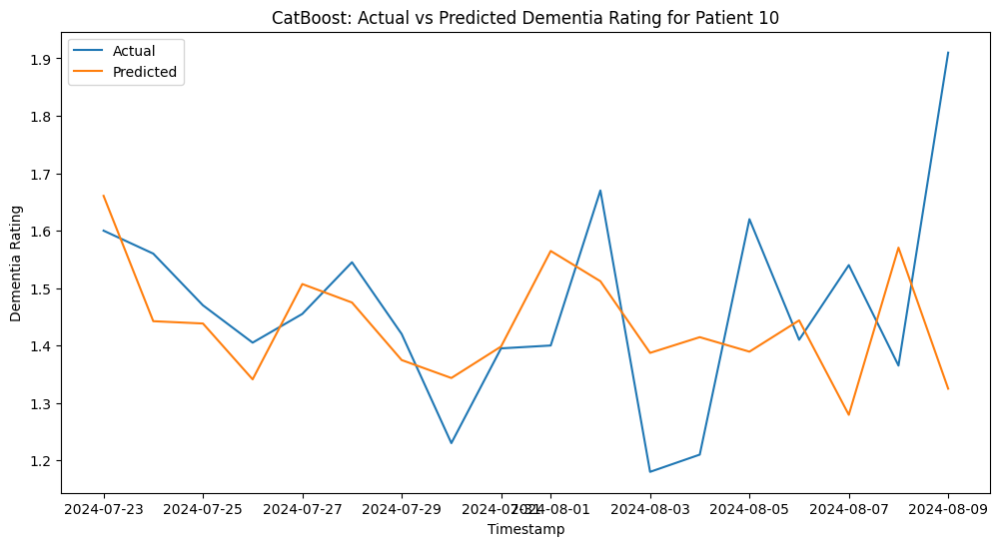

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 123
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.489167
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

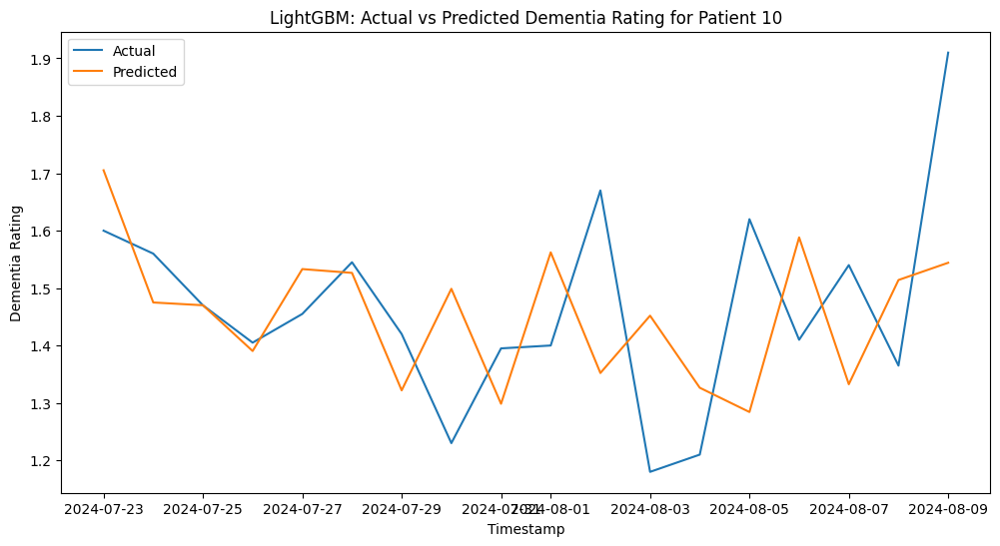

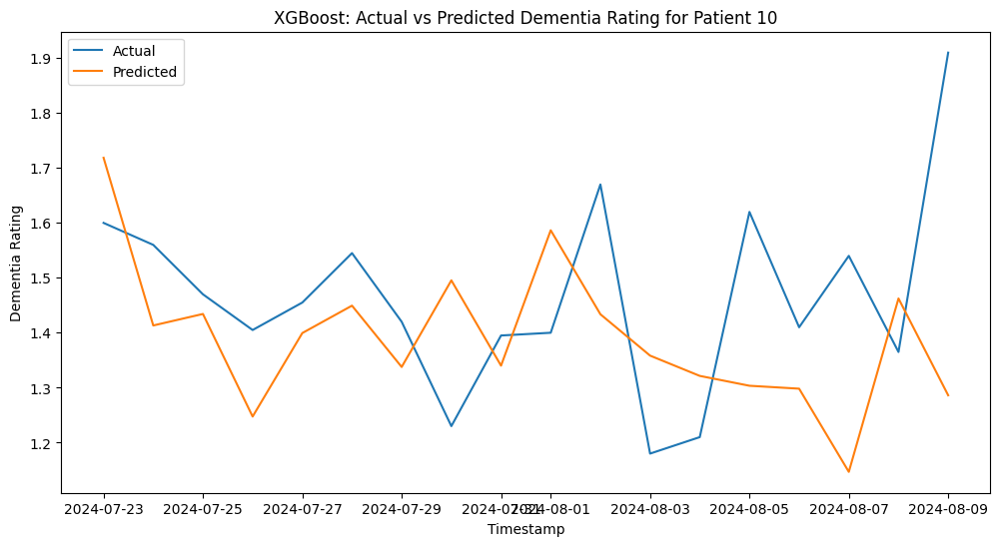

In [ ]:
# Iterate over each patient
for patient_id, patient_data in df.groupby('Patient ID'):
    print(f"Processing Patient {patient_id}")

    # Prepare data for modeling
    X = patient_data[features]
    y = patient_data[target]

    # Split data into train and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # CatBoost model
    catboost_model = CatBoostRegressor(iterations=1000, learning_rate=0.1, depth=6, random_state=42)
    catboost_model.fit(X_train, y_train, verbose=False)
    catboost_pred = catboost_model.predict(X_test)
    all_results.append({**evaluate_model(y_test, catboost_pred, 'CatBoost'), 'Patient ID': patient_id})
    feature_importance['CatBoost'].append(catboost_model.feature_importances_)
    plot_results(y_test, catboost_pred, patient_data['Timestamp'][-len(y_test):], 'CatBoost', patient_id)

    # LightGBM model
    lgbm_model = LGBMRegressor(n_estimators=1000, learning_rate=0.1, max_depth=6, random_state=42)
    lgbm_model.fit(X_train, y_train)
    lgbm_pred = lgbm_model.predict(X_test)
    all_results.append({**evaluate_model(y_test, lgbm_pred, 'LightGBM'), 'Patient ID': patient_id})
    feature_importance['LightGBM'].append(lgbm_model.feature_importances_)
    plot_results(y_test, lgbm_pred, patient_data['Timestamp'][-len(y_test):], 'LightGBM', patient_id)

    # XGBoost model
    xgb_model = XGBRegressor(n_estimators=1000, learning_rate=0.1, max_depth=6, random_state=42)
    xgb_model.fit(X_train, y_train)
    xgb_pred = xgb_model.predict(X_test)
    all_results.append({**evaluate_model(y_test, xgb_pred, 'XGBoost'), 'Patient ID': patient_id})
    feature_importance['XGBoost'].append(xgb_model.feature_importances_)
    plot_results(y_test, xgb_pred, patient_data['Timestamp'][-len(y_test):], 'XGBoost', patient_id)


In [ ]:
# Convert results to DataFrame
results_df = pd.DataFrame(all_results)

In [ ]:
# Print average performance for each model
print(results_df.groupby('Model').mean())

               MSE       MAE      RMSE  R-squared  Patient ID
Model                                                        
CatBoost  0.037900  0.154466  0.192363  -0.374722         5.5
LightGBM  0.047873  0.171243  0.217596  -0.781014         5.5
XGBoost   0.043389  0.164489  0.203676  -0.543819         5.5


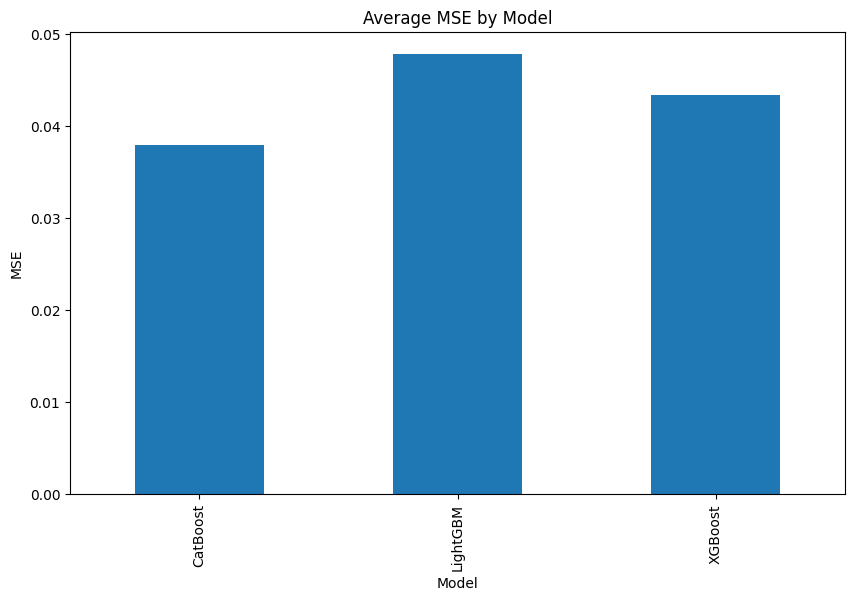

In [ ]:
# Plot average MSE for each model
avg_mse = results_df.groupby('Model')['MSE'].mean()
plt.figure(figsize=(10, 6))
avg_mse.plot(kind='bar')
plt.title('Average MSE by Model')
plt.ylabel('MSE')
plt.show()

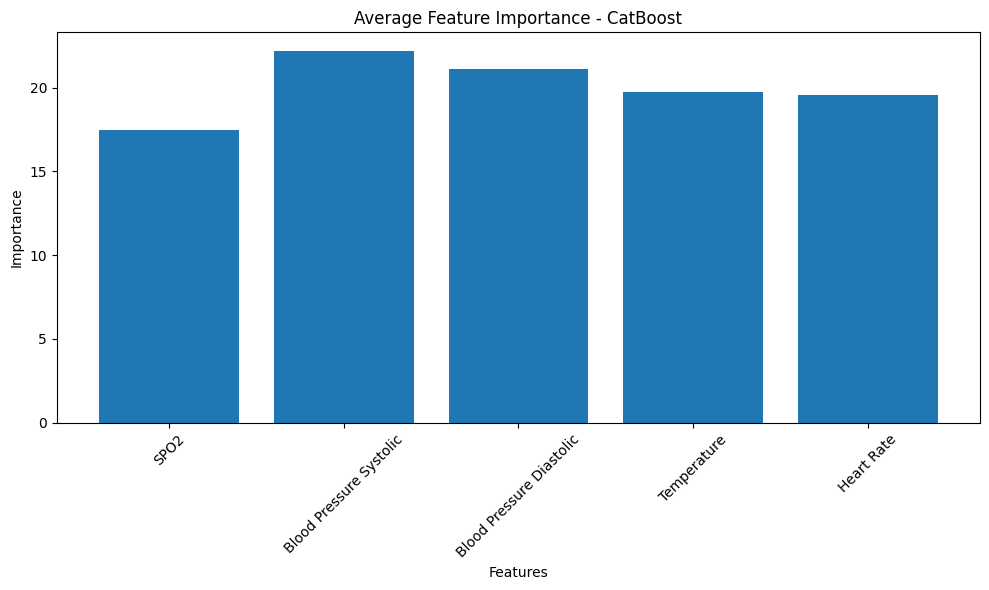

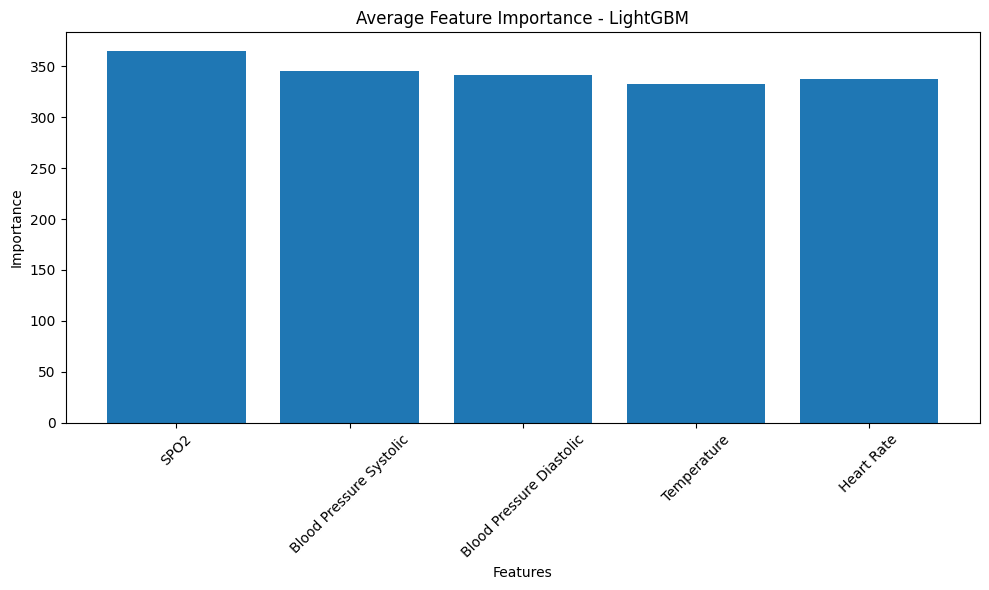

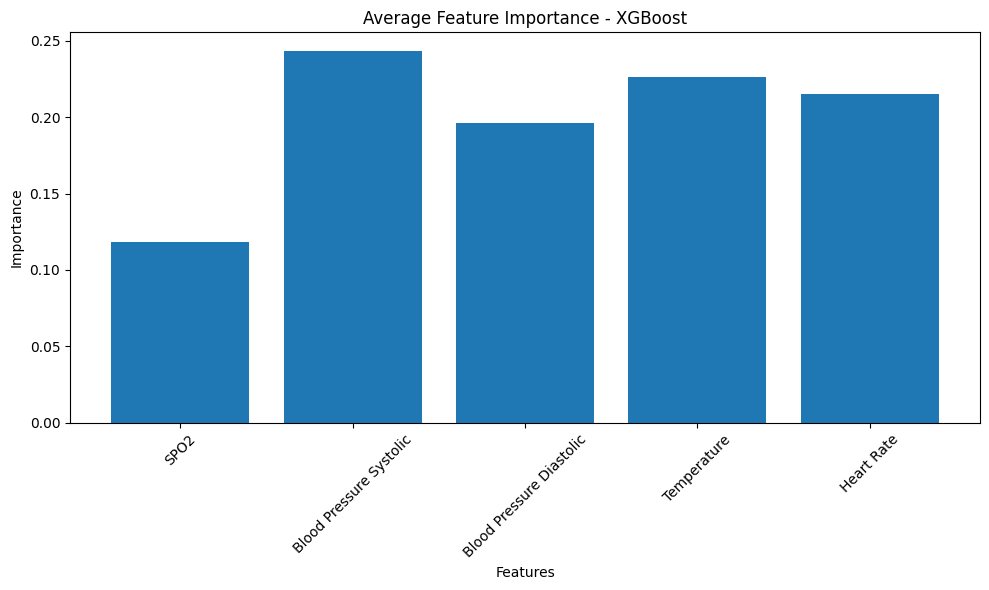

In [ ]:
# Plot average feature importance
for model in ['CatBoost', 'LightGBM', 'XGBoost']:
    avg_importance = np.mean(feature_importance[model], axis=0)
    plt.figure(figsize=(10, 6))
    plt.bar(features, avg_importance)
    plt.title(f'Average Feature Importance - {model}')
    plt.xlabel('Features')
    plt.ylabel('Importance')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

<Figure size 1200x600 with 0 Axes>

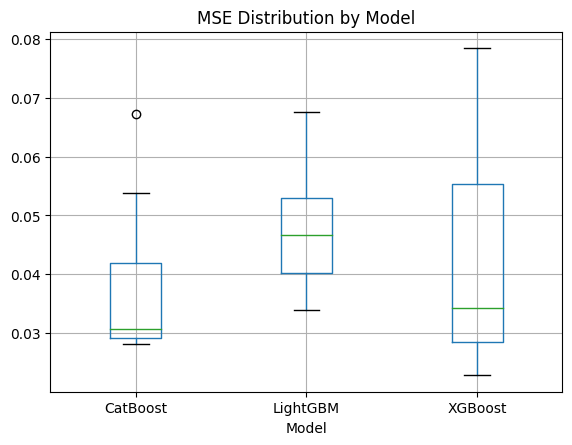

In [ ]:
# Plot MSE distribution for each model
plt.figure(figsize=(12, 6))
results_df.boxplot(column='MSE', by='Model')
plt.title('MSE Distribution by Model')
plt.suptitle('')  # This removes the automatic suptitle added by boxplot
plt.show()

In [ ]:
results_df.head(30)

,Model,MSE,MAE,RMSE,R-squared,Patient ID
0,CatBoost,0.043200,0.173210,0.207847,-0.726459,1
1,LightGBM,0.039548,0.176934,0.198866,-0.580482,1
2,XGBoost,0.056028,0.197023,0.236703,-1.239113,1
3,CatBoost,0.029928,0.158712,0.172999,0.008842,2
4,LightGBM,0.046942,0.171289,0.216660,-0.554588,2
5,XGBoost,0.022845,0.129903,0.151146,0.243427,2
6,CatBoost,0.028691,0.137369,0.169384,-0.228809,3
7,LightGBM,0.034027,0.136385,0.184463,-0.457327,3
8,XGBoost,0.028488,0.129983,0.168783,-0.220099,3
9,CatBoost,0.053842,0.182874,0.232039,-0.441314,4


In [ ]:
results_df.tail()

,Model,MSE,MAE,RMSE,R-squared,Patient ID
25,LightGBM,0.042082,0.151205,0.205139,-1.928117,9
26,XGBoost,0.028521,0.132149,0.168881,-0.984517,9
27,CatBoost,0.038274,0.144895,0.195638,-0.293263,10
28,LightGBM,0.037479,0.159429,0.193596,-0.266406,10
29,XGBoost,0.053057,0.181554,0.230341,-0.792755,10


In [ ]:
catboost_df = results_df[results_df['Model'] == 'LightGBM']

In [ ]:
catboost_df.head(11)

,Model,MSE,MAE,RMSE,R-squared,Patient ID
1,LightGBM,0.039548,0.176934,0.198866,-0.580482,1
4,LightGBM,0.046942,0.171289,0.216660,-0.554588,2
7,LightGBM,0.034027,0.136385,0.184463,-0.457327,3
10,LightGBM,0.067547,0.193601,0.259897,-0.808177,4
13,LightGBM,0.046289,0.182232,0.215149,-0.472473,5
16,LightGBM,0.062196,0.207928,0.249392,-0.771808,6
19,LightGBM,0.048016,0.157510,0.219124,-0.218993,7
22,LightGBM,0.054604,0.175919,0.233675,-1.751766,8
25,LightGBM,0.042082,0.151205,0.205139,-1.928117,9
28,LightGBM,0.037479,0.159429,0.193596,-0.266406,10


Processing Patient 1


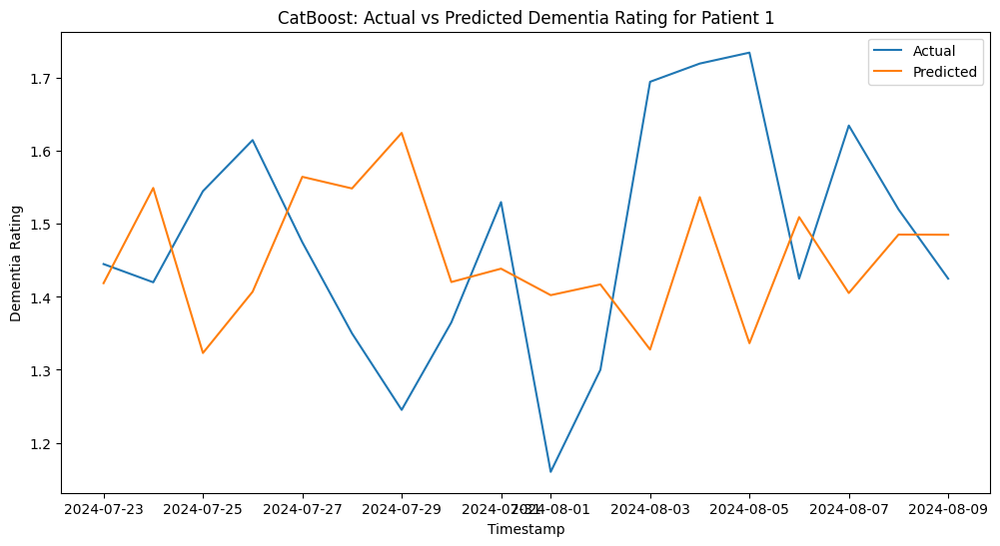

Processing Patient 2


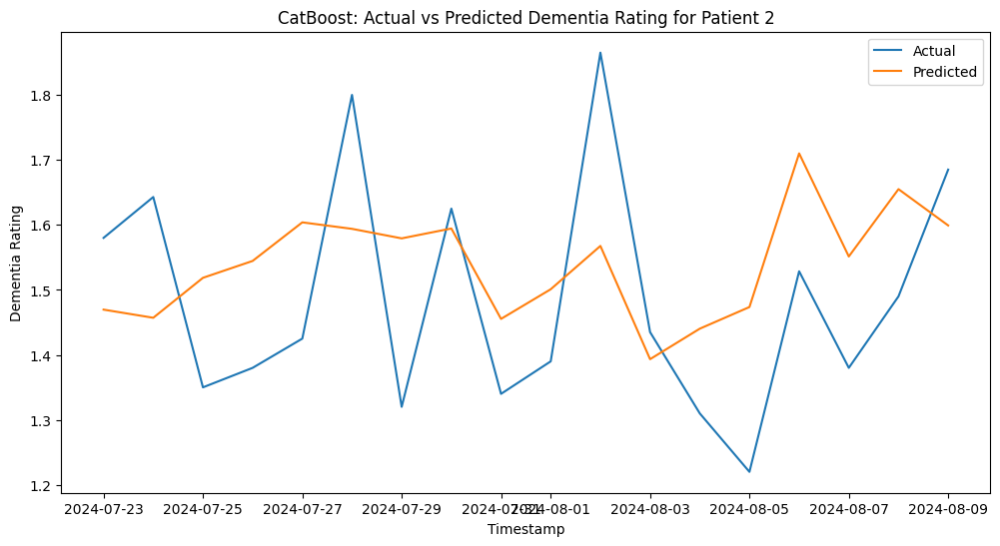

Processing Patient 3


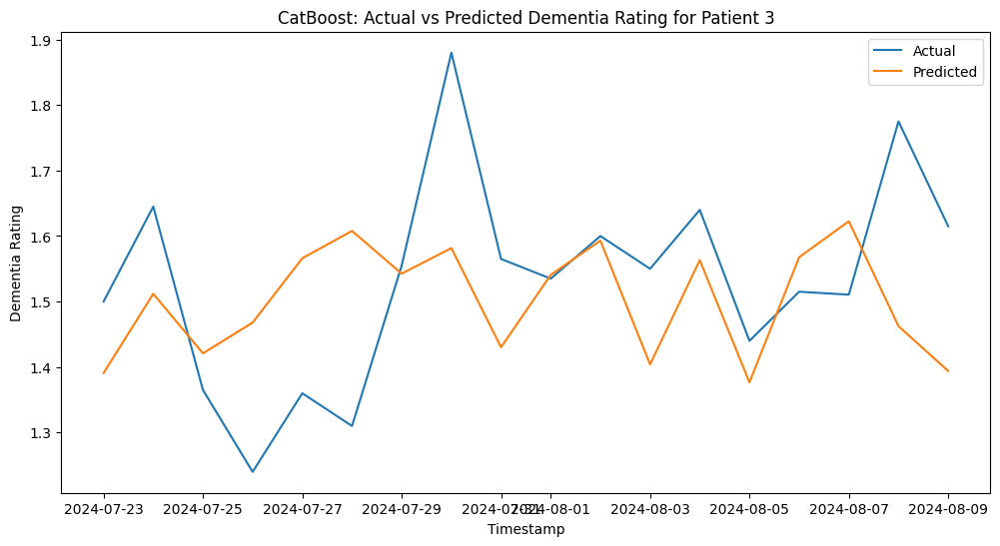

Processing Patient 4


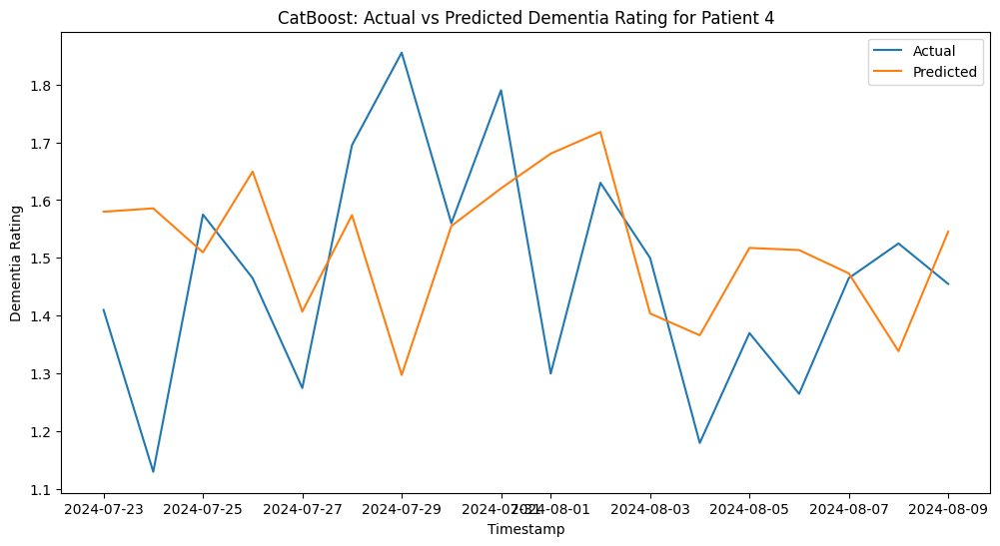

Processing Patient 5


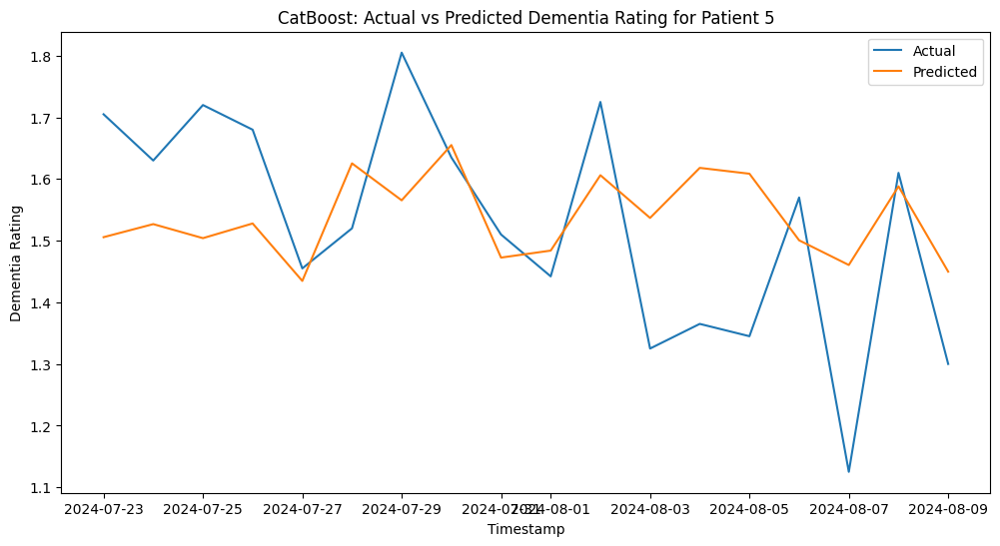

Processing Patient 6


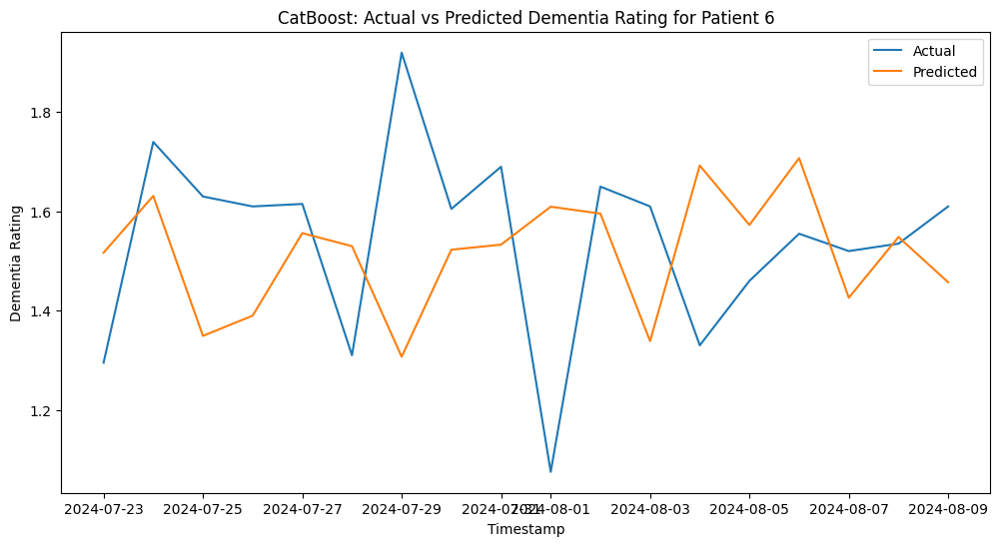

Processing Patient 7


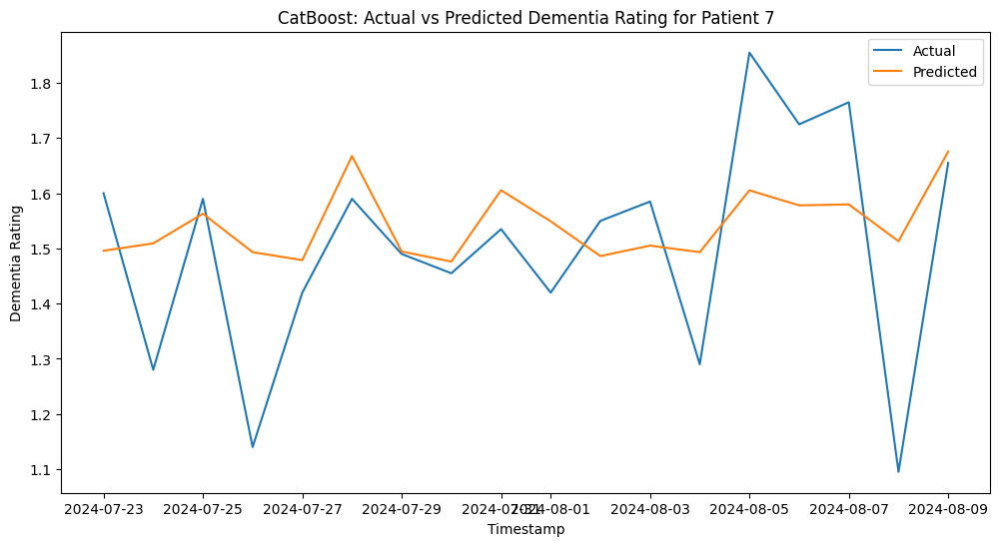

Processing Patient 8


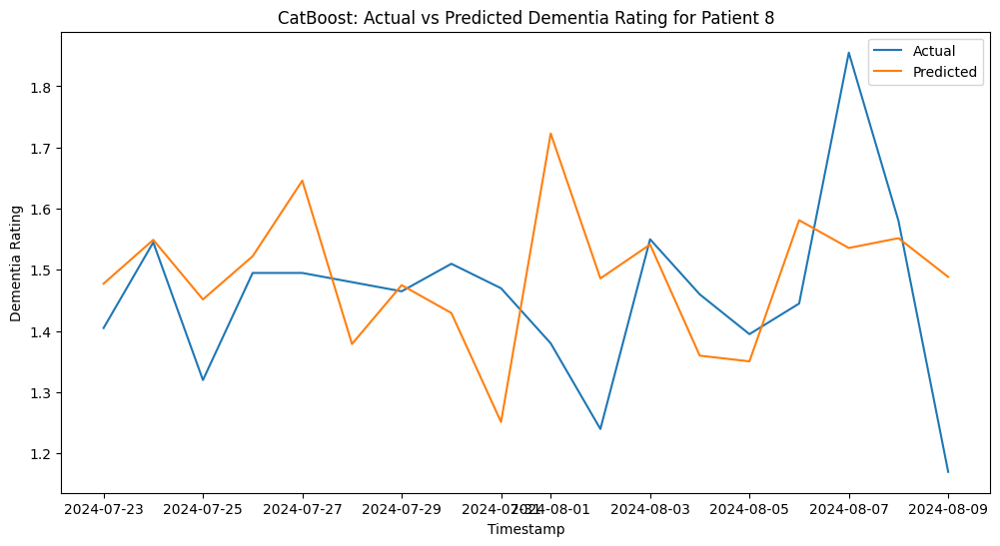

Processing Patient 9


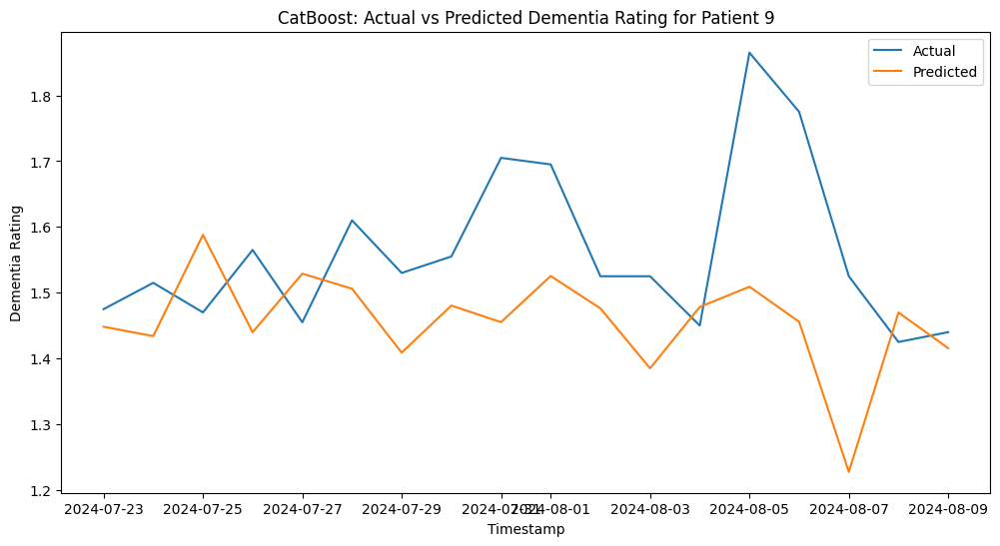

Processing Patient 10


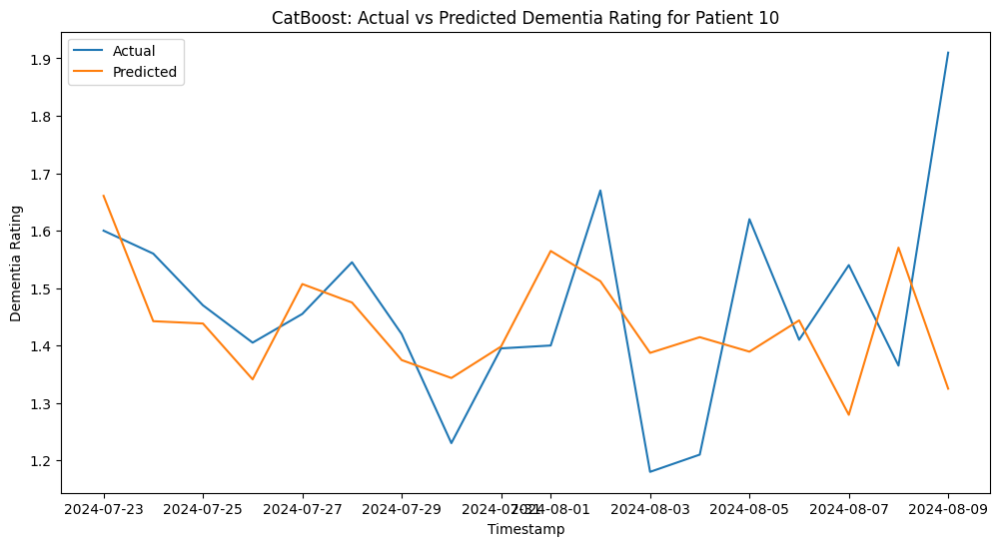

In [ ]:
# Iterate over each patient
for patient_id, patient_data in df.groupby('Patient ID'):
    print(f"Processing Patient {patient_id}")

    # Prepare data for modeling
    X = patient_data[features]
    y = patient_data[target]

    # Split data into train and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # CatBoost model
    catboost_model = CatBoostRegressor(iterations=1000, learning_rate=0.1, depth=6, random_state=42)
    catboost_model.fit(X_train, y_train, verbose=False)
    catboost_pred = catboost_model.predict(X_test)
    all_results.append({**evaluate_model(y_test, catboost_pred, 'CatBoost'), 'Patient ID': patient_id})
    feature_importance['CatBoost'].append(catboost_model.feature_importances_)
    plot_results(y_test, catboost_pred, patient_data['Timestamp'][-len(y_test):], 'CatBoost', patient_id)

Processing Patient 1


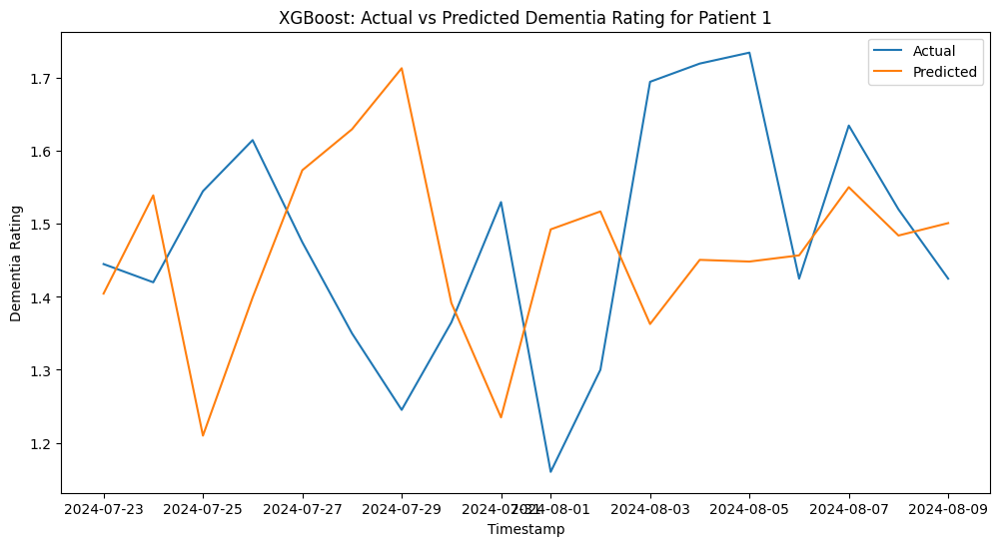

Processing Patient 2


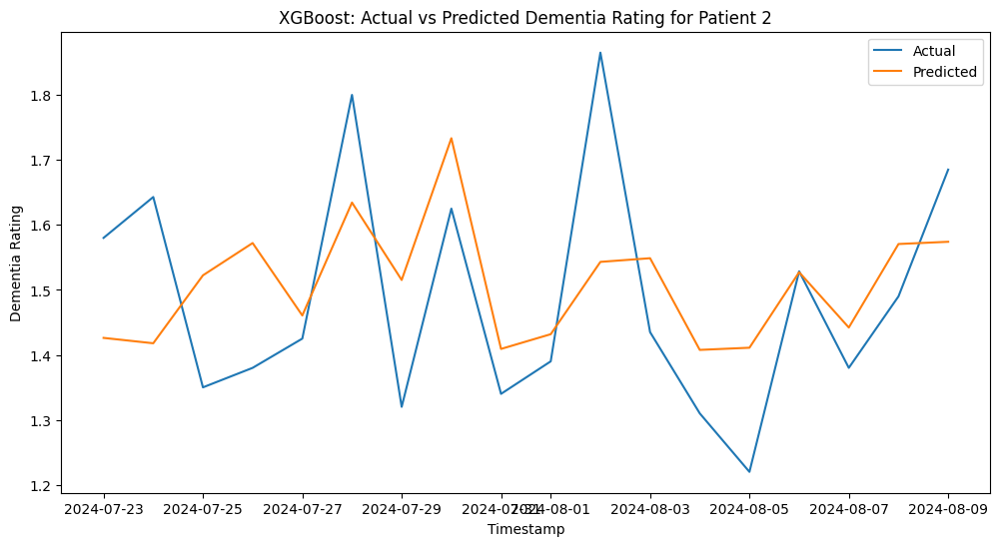

Processing Patient 3


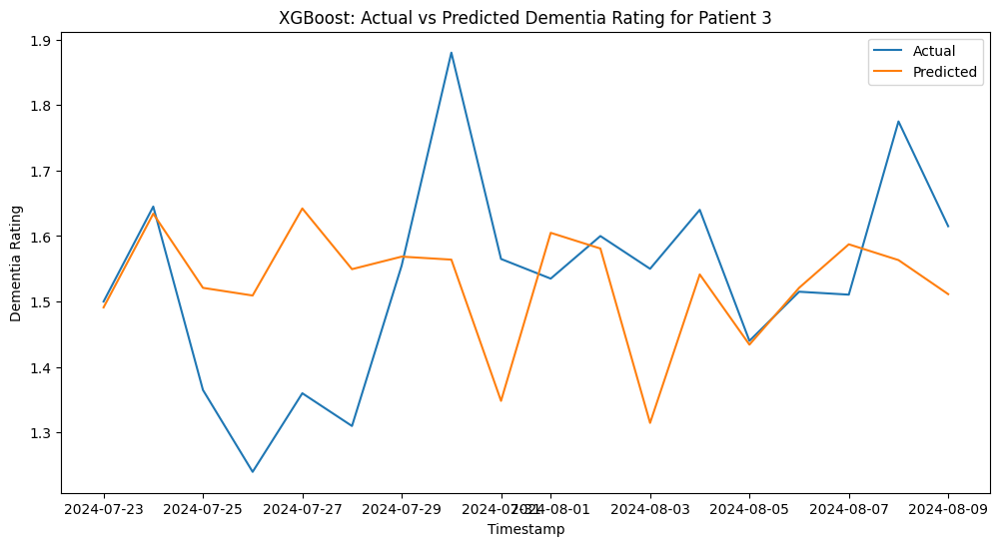

Processing Patient 4


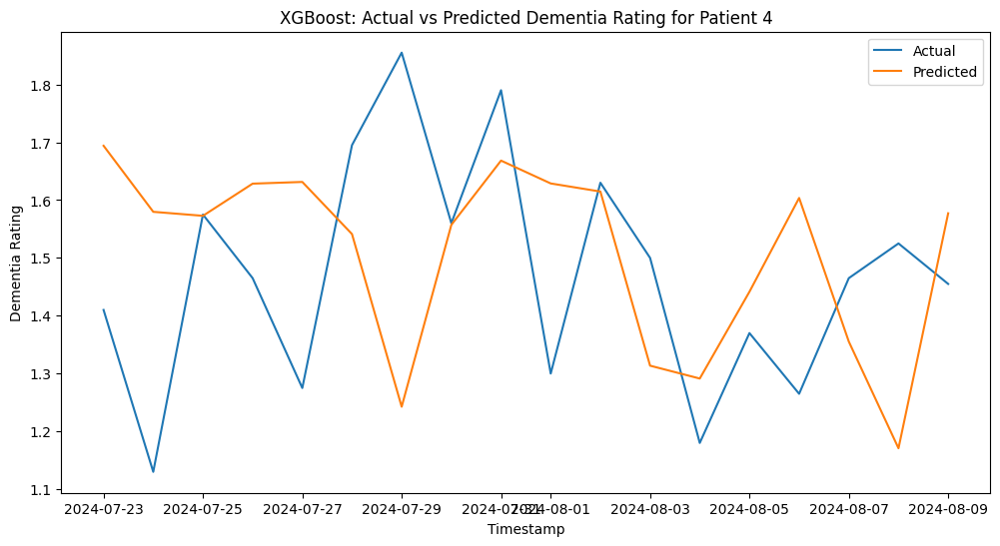

Processing Patient 5


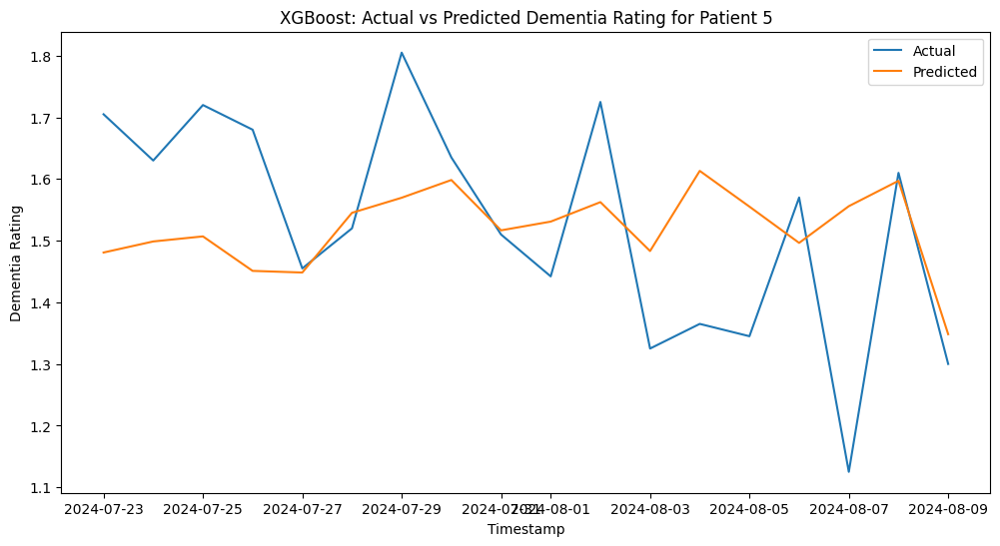

Processing Patient 6


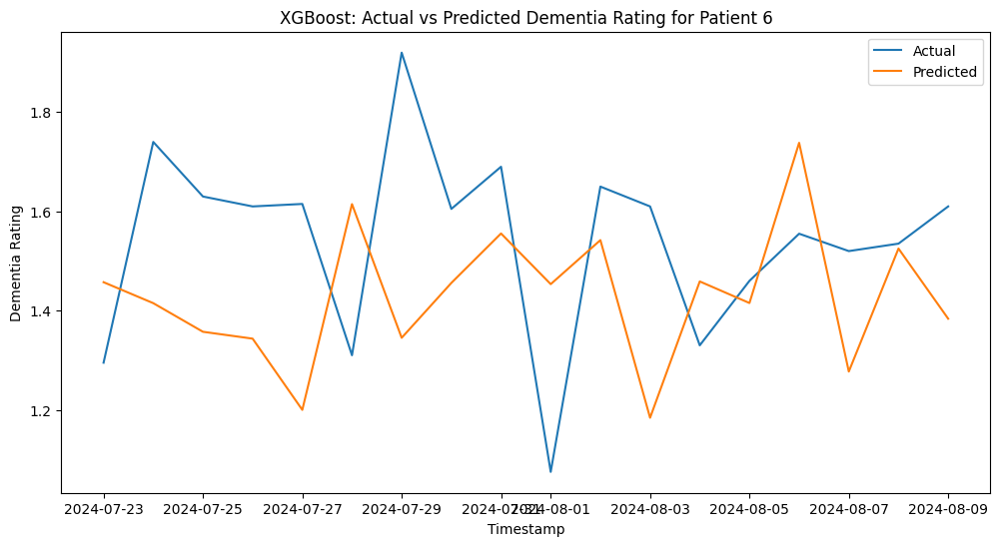

Processing Patient 7


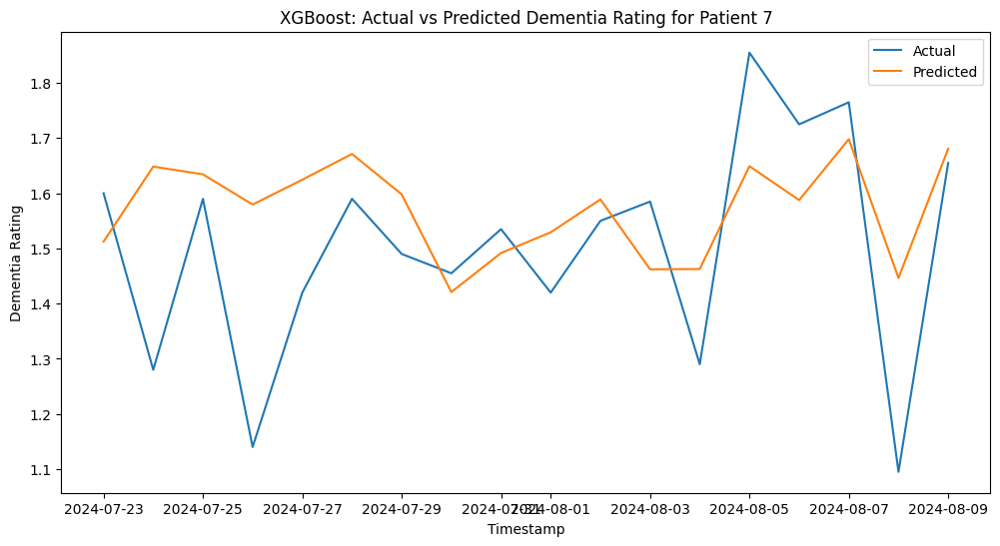

Processing Patient 8


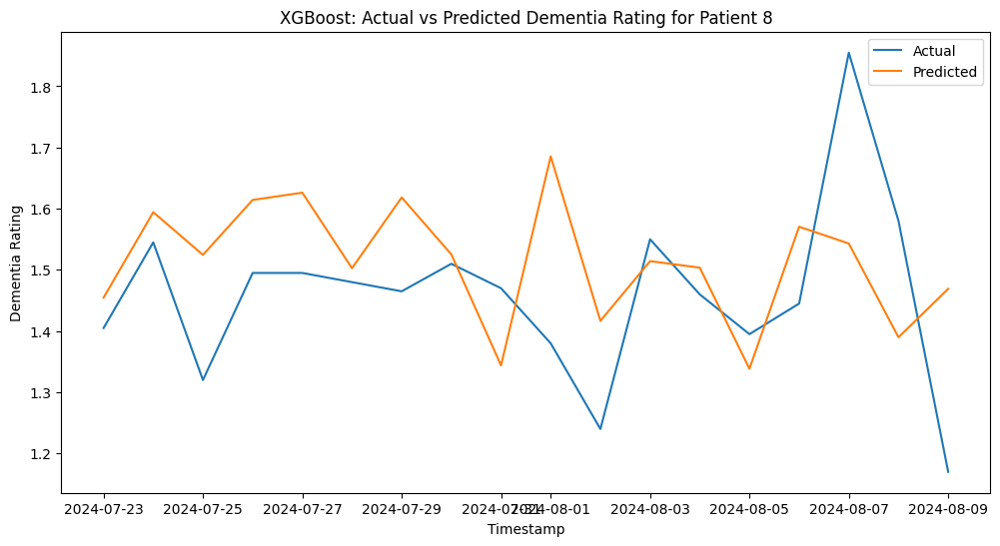

Processing Patient 9


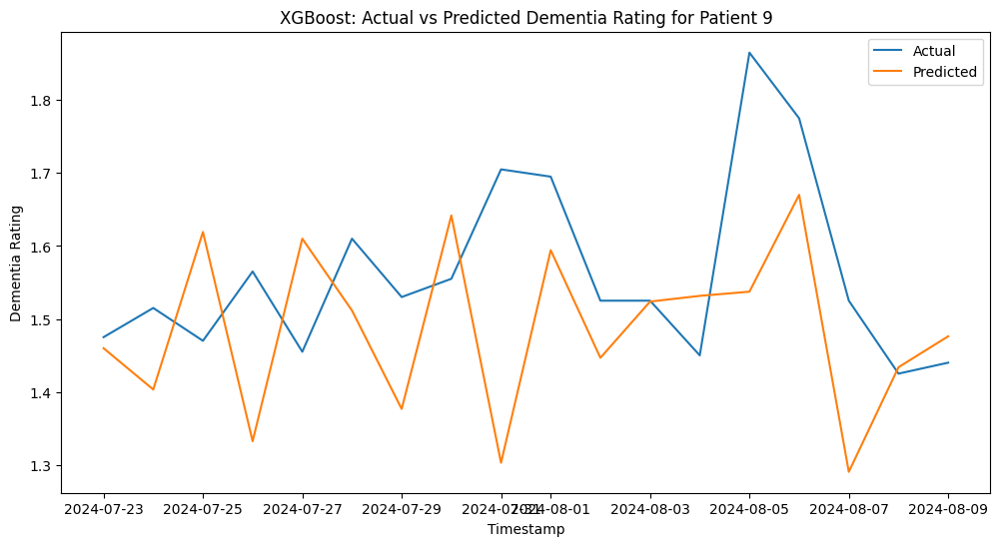

Processing Patient 10


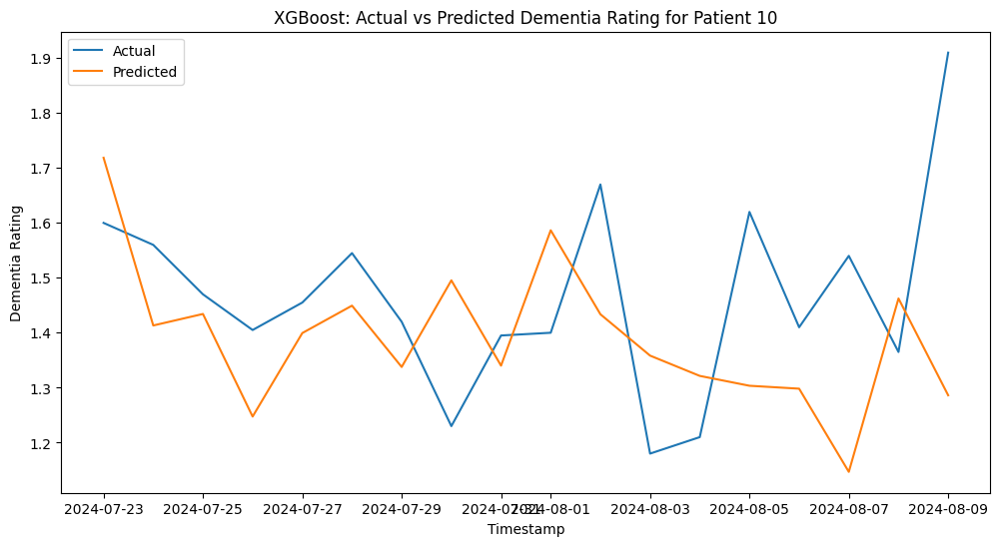

In [ ]:
# Iterate over each patient
for patient_id, patient_data in df.groupby('Patient ID'):
    print(f"Processing Patient {patient_id}")

    # Prepare data for modeling
    X = patient_data[features]
    y = patient_data[target]

    # Split data into train and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # XGBoost model
    xgb_model = XGBRegressor(n_estimators=1000, learning_rate=0.1, max_depth=6, random_state=42)
    xgb_model.fit(X_train, y_train)
    xgb_pred = xgb_model.predict(X_test)
    all_results.append({**evaluate_model(y_test, xgb_pred, 'XGBoost'), 'Patient ID': patient_id})
    feature_importance['XGBoost'].append(xgb_model.feature_importances_)
    plot_results(y_test, xgb_pred, patient_data['Timestamp'][-len(y_test):], 'XGBoost', patient_id)

Processing Patient 1
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000045 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 125
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.497014
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

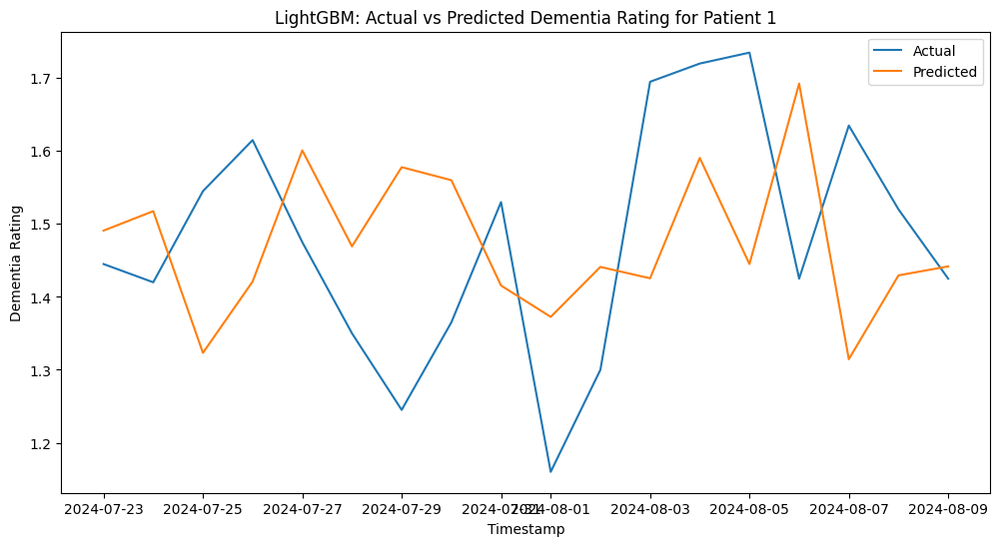

Processing Patient 2
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000034 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 125
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.536801
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

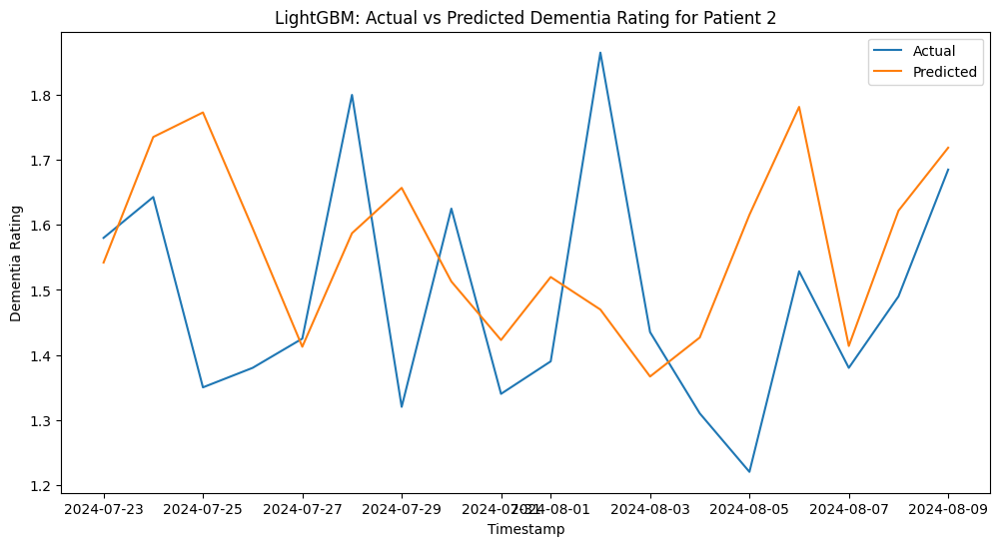

Processing Patient 3
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000032 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 123
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.513244
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

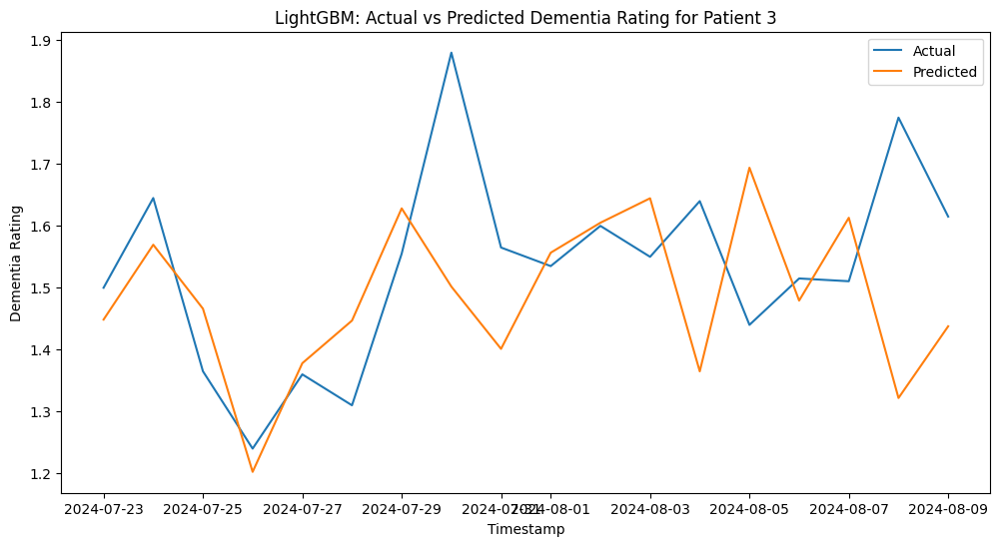

Processing Patient 4
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000038 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 124
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.506667
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

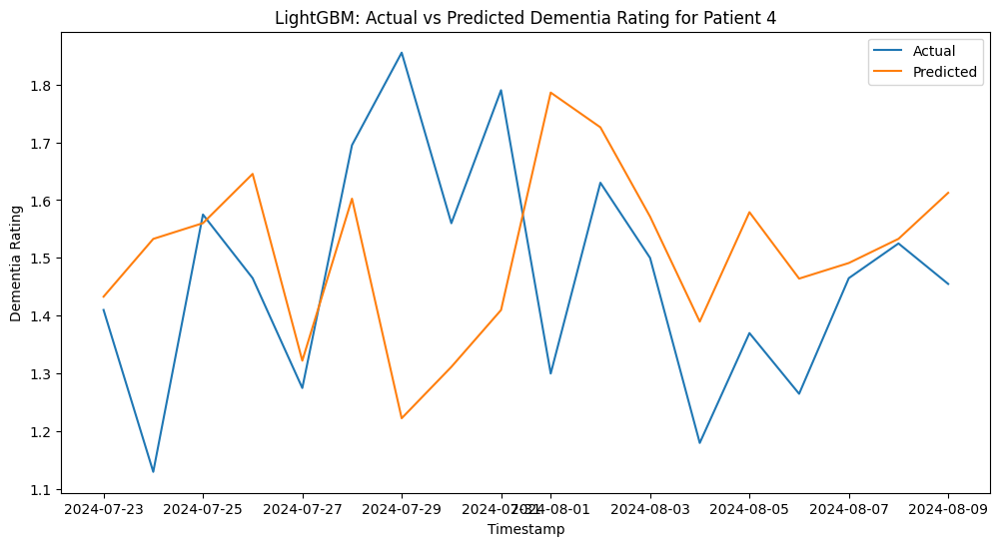

Processing Patient 5
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000034 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 125
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.530860
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

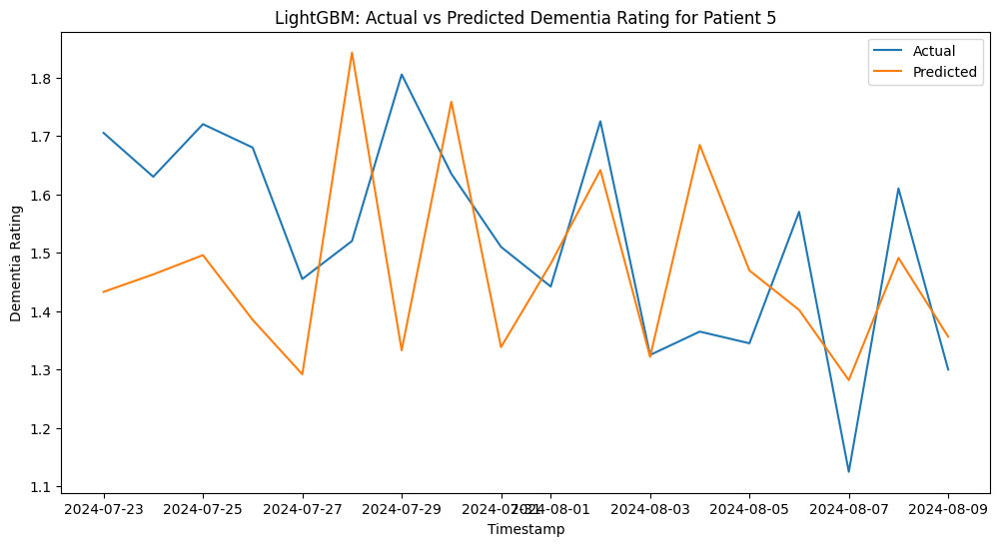

Processing Patient 6
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000044 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 123
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.543125
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

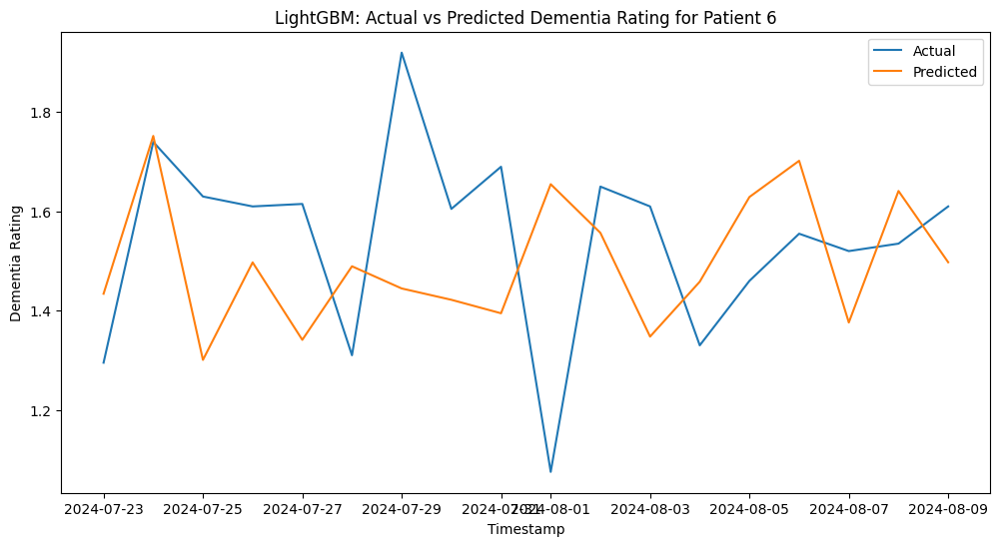

Processing Patient 7
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000032 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 123
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.561429
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

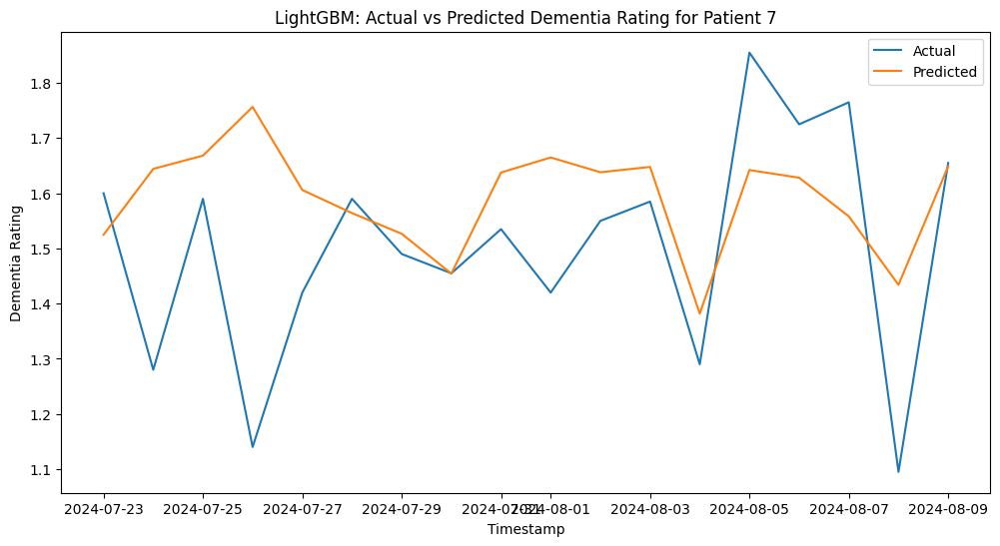

Processing Patient 8
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000050 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 124
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.499337
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

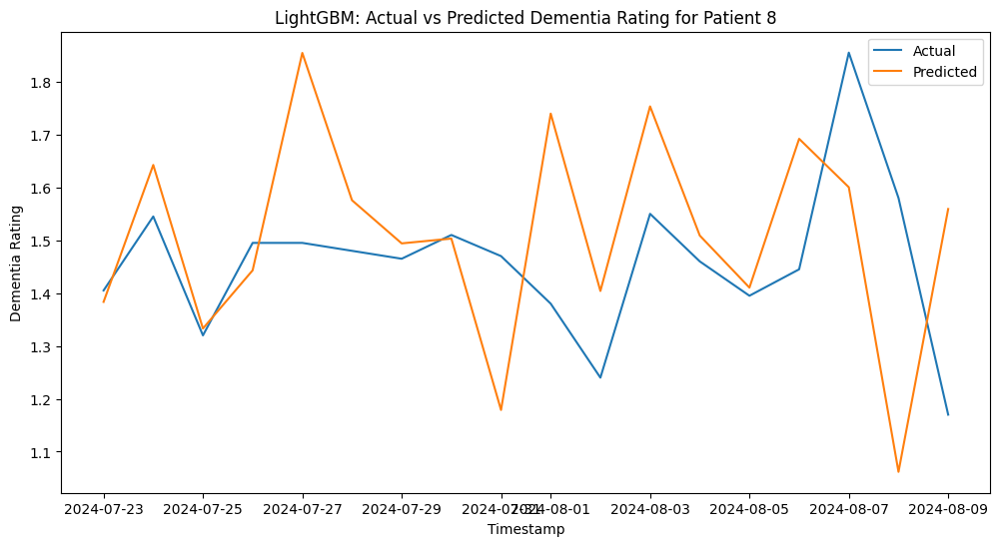

Processing Patient 9
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000034 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 124
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.478461
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

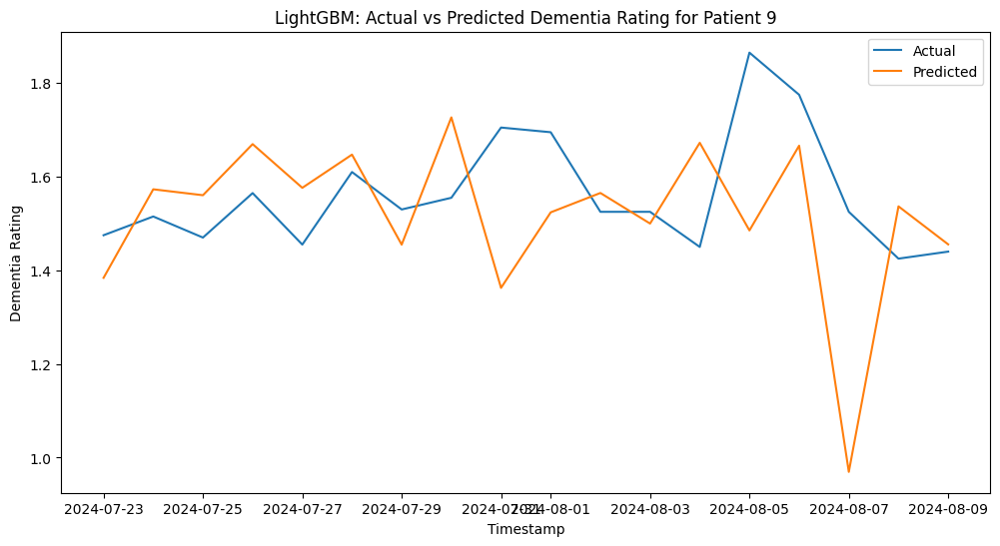

Processing Patient 10
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000036 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 123
[LightGBM] [Info] Number of data points in the train set: 72, number of used features: 5
[LightGBM] [Info] Start training from score 1.489167
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spli

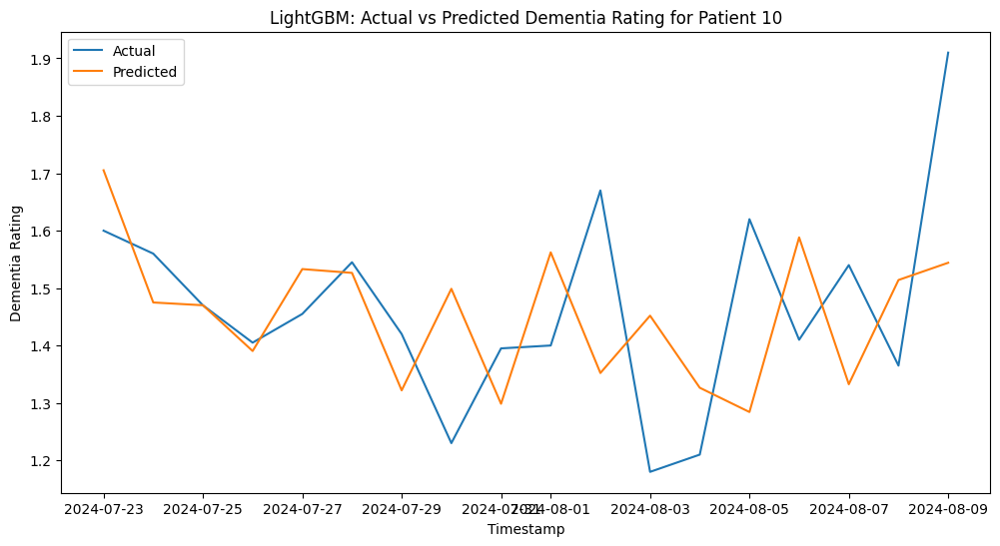

In [ ]:
# Iterate over each patient
for patient_id, patient_data in df.groupby('Patient ID'):
    print(f"Processing Patient {patient_id}")

    # Prepare data for modeling
    X = patient_data[features]
    y = patient_data[target]

    # Split data into train and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    # LightGBM model
    lgbm_model = LGBMRegressor(n_estimators=1000, learning_rate=0.1, max_depth=6, random_state=42)
    lgbm_model.fit(X_train, y_train)
    lgbm_pred = lgbm_model.predict(X_test)
    all_results.append({**evaluate_model(y_test, lgbm_pred, 'LightGBM'), 'Patient ID': patient_id})
    feature_importance['LightGBM'].append(lgbm_model.feature_importances_)
    plot_results(y_test, lgbm_pred, patient_data['Timestamp'][-len(y_test):], 'LightGBM', patient_id)


# **Model Comparison:**

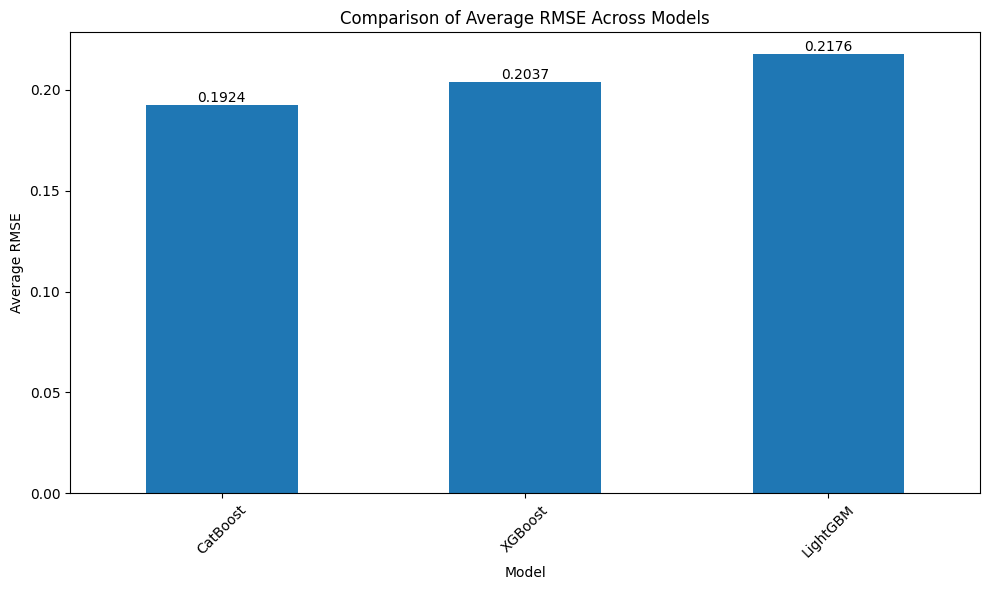

Average RMSE for each model:
Model
CatBoost    0.192363
XGBoost     0.203676
LightGBM    0.217596
Name: RMSE, dtype: float64

Best performing model: CatBoost with average RMSE of 0.1924

Percentage difference from the best model:
Model
CatBoost     0.000000
XGBoost      5.881125
LightGBM    13.117441
Name: RMSE, dtype: float64


In [ ]:
# Group by Model and calculate mean RMSE
rmse_comparison = results_df.groupby('Model')['RMSE'].mean().sort_values()

# Create a bar plot
plt.figure(figsize=(10, 6))
rmse_comparison.plot(kind='bar')
plt.title('Comparison of Average RMSE Across Models')
plt.xlabel('Model')
plt.ylabel('Average RMSE')
plt.xticks(rotation=45)
plt.tight_layout()

# Add value labels on top of each bar
for i, v in enumerate(rmse_comparison):
    plt.text(i, v, f'{v:.4f}', ha='center', va='bottom')

plt.show()

# Print the numeric values
print("Average RMSE for each model:")
print(rmse_comparison)

# Calculate the best model (lowest RMSE)
best_model = rmse_comparison.idxmin()
best_rmse = rmse_comparison.min()

print(f"\nBest performing model: {best_model} with average RMSE of {best_rmse:.4f}")

# Calculate percentage difference from the best model
percentage_diff = (rmse_comparison - best_rmse) / best_rmse * 100

print("\nPercentage difference from the best model:")
print(percentage_diff)

In [ ]:
# Create a dictionary with the RMSE values for each model
rmse_values = {
    'ARIMA': np.mean([model_info['rmse'] for model_info in arima_models.values()]),
    'SARIMAX': np.mean([model_info['rmse'] for model_info in sarimax_models.values()]),
    'LSTM': np.mean([model_info['test_rmse'] for model_info in lstm_models.values()]),
    'Prophet': np.mean([res['rmse'] for res in results.values()]),
    'CatBoost': results_df[results_df['Model'] == 'CatBoost']['RMSE'].mean(),
    'XGBoost': results_df[results_df['Model'] == 'XGBoost']['RMSE'].mean(),
    'LightGBM': results_df[results_df['Model'] == 'LightGBM']['RMSE'].mean()
}

# Convert to a Series for easier plotting
rmse_comparison = pd.Series(rmse_values).sort_values()

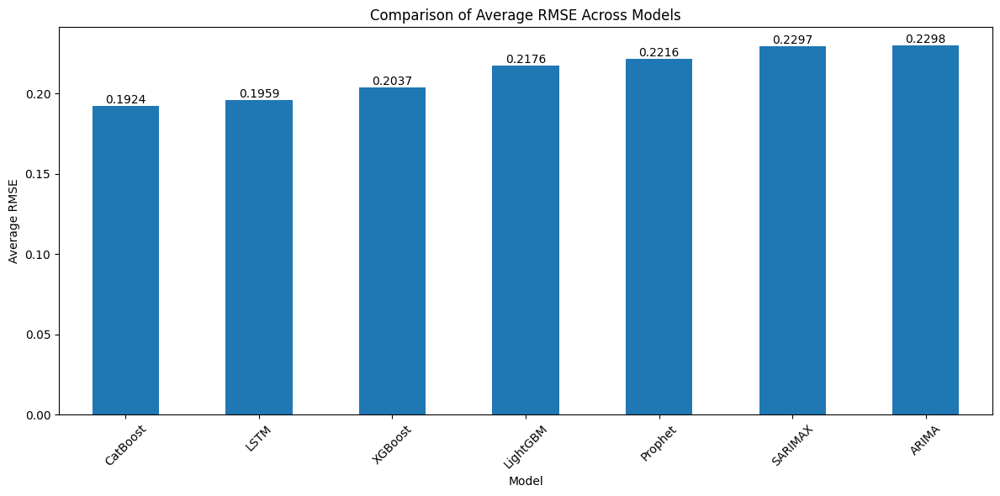

In [ ]:
# Create a bar plot
plt.figure(figsize=(12, 6))
rmse_comparison.plot(kind='bar')
plt.title('Comparison of Average RMSE Across Models')
plt.xlabel('Model')
plt.ylabel('Average RMSE')
plt.xticks(rotation=45)
plt.tight_layout()
# Add value labels on top of each bar
for i, v in enumerate(rmse_comparison):
    plt.text(i, v, f'{v:.4f}', ha='center', va='bottom')

plt.show()

In [ ]:
# Print the numeric values
print("Average RMSE for each model:")
print(rmse_comparison)

Average RMSE for each model:
CatBoost    0.192363
LSTM        0.195925
XGBoost     0.203676
LightGBM    0.217596
Prophet     0.221565
SARIMAX     0.229726
ARIMA       0.229841
dtype: float64


In [ ]:
# Calculate the best model (lowest RMSE)
best_model = rmse_comparison.idxmin()
best_rmse = rmse_comparison.min()

print(f"\nBest performing model: {best_model} with average RMSE of {best_rmse:.4f}")


Best performing model: CatBoost with average RMSE of 0.1924


In [ ]:
# Calculate percentage difference from the best model
percentage_diff = (rmse_comparison - best_rmse) / best_rmse * 100

print("\nPercentage difference from the best model:")
print(percentage_diff)


Percentage difference from the best model:
CatBoost     0.000000
LSTM         1.851877
XGBoost      5.881125
LightGBM    13.117441
Prophet     15.180662
SARIMAX     19.423290
ARIMA       19.482997
dtype: float64


In [ ]:
rmse_values

{'ARIMA': 0.2298412402999886,
 'SARIMAX': 0.22972638598573764,
 'LSTM': 0.19592546556030183,
 'Prophet': 0.22156513304337264,
 'CatBoost': 0.19236313593997448,
 'XGBoost': 0.20367625177706566,
 'LightGBM': 0.2175962574985027}

In [ ]:
# Function to get RMSE for a specific patient from a model dictionary
def get_patient_rmse(model_dict, patient_id):
    if patient_id not in model_dict:
        return np.nan
    patient_data = model_dict[patient_id]
    if 'rmse' in patient_data:
        return patient_data['rmse']
    elif 'test_rmse' in patient_data:
        return patient_data['test_rmse']
    else:
        return np.nan


In [ ]:
# Get unique patient IDs
patient_ids = df_resampled['Patient ID'].unique()

# Create a dictionary to store RMSE values for each patient and model
rmse_values = {patient_id: {} for patient_id in patient_ids}


In [ ]:
# Populate RMSE values for each model and patient
for patient_id in patient_ids:
    rmse_values[patient_id]['ARIMA'] = get_patient_rmse(arima_models, patient_id)
    rmse_values[patient_id]['SARIMAX'] = get_patient_rmse(sarimax_models, patient_id)
    rmse_values[patient_id]['LSTM'] = get_patient_rmse(lstm_models, patient_id)

    # For Prophet, the structure might be different
    if 'results' in locals() and isinstance(results, dict):
        rmse_values[patient_id]['Prophet'] = get_patient_rmse(results, patient_id)
    else:
        rmse_values[patient_id]['Prophet'] = np.nan

    # For CatBoost, XGBoost, and LightGBM
    for model in ['CatBoost', 'XGBoost', 'LightGBM']:
        rmse = results_df[(results_df['Model'] == model) & (results_df['Patient ID'] == patient_id)]['RMSE'].values
        rmse_values[patient_id][model] = rmse[0] if len(rmse) > 0 else np.nan

In [ ]:
# Convert to DataFrame for easier manipulation
rmse_df = pd.DataFrame(rmse_values).T

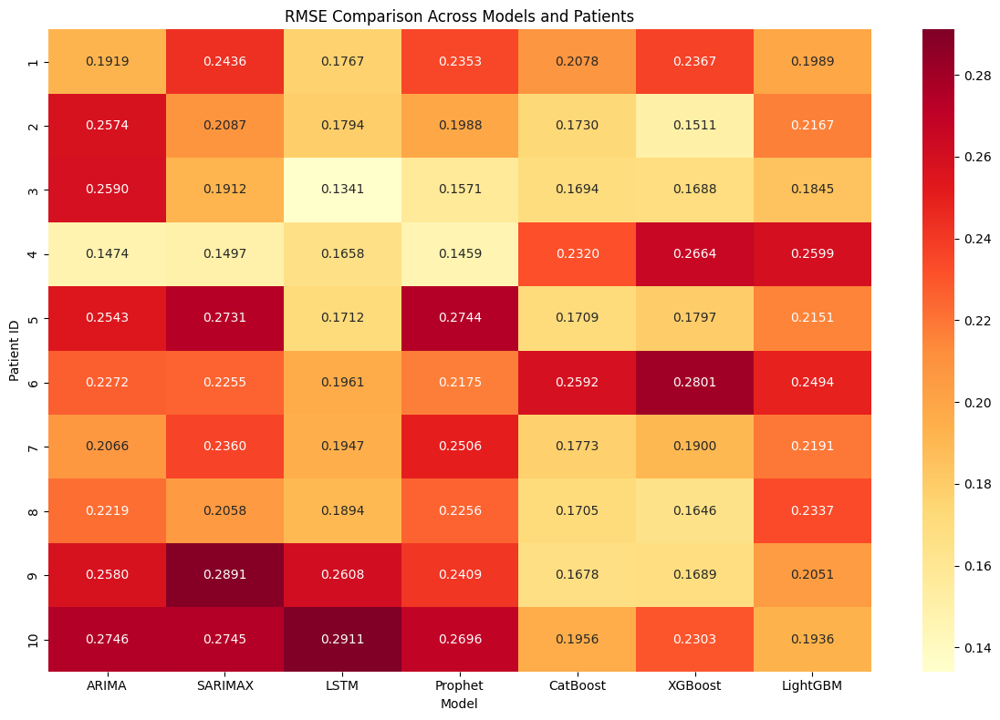

In [ ]:
# Plot heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(rmse_df, annot=True, cmap='YlOrRd', fmt='.4f')
plt.title('RMSE Comparison Across Models and Patients')
plt.ylabel('Patient ID')
plt.xlabel('Model')
plt.tight_layout()
plt.show()

In [ ]:
# Print summary statistics
print("Summary Statistics:")
print(rmse_df.describe())

Summary Statistics:
           ARIMA    SARIMAX       LSTM    Prophet   CatBoost    XGBoost  \
count  10.000000  10.000000  10.000000  10.000000  10.000000  10.000000   
mean    0.229841   0.229726   0.195925   0.221565   0.192363   0.203676   
std     0.039226   0.042900   0.046297   0.043381   0.031555   0.046001   
min     0.147438   0.149698   0.134137   0.145871   0.167839   0.151146   
25%     0.210397   0.206506   0.172554   0.203494   0.170619   0.168807   
50%     0.240766   0.230751   0.184401   0.230452   0.175145   0.184890   
75%     0.257834   0.265727   0.195736   0.248190   0.204795   0.235113   
max     0.274628   0.289142   0.291091   0.274366   0.259194   0.280062   

        LightGBM  
count  10.000000  
mean    0.217596  
std     0.024147  
min     0.184463  
25%     0.200434  
50%     0.215905  
75%     0.230037  
max     0.259897  


In [ ]:
# Find best model for each patient
best_models = rmse_df.idxmin(axis=1)
print("\nBest Model for Each Patient:")
print(best_models.value_counts())


Best Model for Each Patient:
LSTM        3
CatBoost    3
XGBoost     2
Prophet     1
LightGBM    1
Name: count, dtype: int64


In [ ]:
# Overall best model
overall_best_model = rmse_df.mean().idxmin()
print(f"\nOverall Best Model: {overall_best_model}")


Overall Best Model: CatBoost


In [ ]:
# Pairwise model comparison
print("\nPairwise Model Comparison (Average RMSE Difference):")
for model1 in rmse_df.columns:
    for model2 in rmse_df.columns:
        if model1 < model2:  # To avoid duplicate comparisons
            diff = (rmse_df[model1] - rmse_df[model2]).mean()
            print(f"{model1} vs {model2}: {diff:.4f}")


Pairwise Model Comparison (Average RMSE Difference):
ARIMA vs SARIMAX: 0.0001
ARIMA vs LSTM: 0.0339
ARIMA vs Prophet: 0.0083
ARIMA vs CatBoost: 0.0375
ARIMA vs XGBoost: 0.0262
ARIMA vs LightGBM: 0.0122
SARIMAX vs XGBoost: 0.0261
LSTM vs SARIMAX: -0.0338
LSTM vs Prophet: -0.0256
LSTM vs XGBoost: -0.0078
LSTM vs LightGBM: -0.0217
Prophet vs SARIMAX: -0.0082
Prophet vs XGBoost: 0.0179
CatBoost vs SARIMAX: -0.0374
CatBoost vs LSTM: -0.0036
CatBoost vs Prophet: -0.0292
CatBoost vs XGBoost: -0.0113
CatBoost vs LightGBM: -0.0252
LightGBM vs SARIMAX: -0.0121
LightGBM vs Prophet: -0.0040
LightGBM vs XGBoost: 0.0139
